<a href="https://colab.research.google.com/github/Home-LLC/State-Level/blob/main/Multivariate_Time_Series_Interpolation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Multivariate Time Series Prediction with LSTM**

In [3]:
seed_value= 42

# 1. Set the `PYTHONHASHSEED` environment variable at a fixed value
import os
os.environ['PYTHONHASHSEED']=str(seed_value)

# 2. Set the `python` built-in pseudo-random generator at a fixed1 value
import random
random.seed(seed_value)

# 3. Set the `numpy` pseudo-random generator at a fixed value
import numpy as np
np.random.seed(seed_value)

# 4. Set the `tensorflow` pseudo-random generator at a fixed value
# for later versions: 
# tf.compat.v1.set_random_seed(seed_value)
import pandas as pd
# # 5. Configure a new global `tensorflow` session
# from keras import backend as K
# session_conf = tf.ConfigProto(intra_op_parallelism_threads=1, inter_op_parallelism_threads=1)
# sess = tf.Session(graph=tf.get_default_graph(), config=session_conf)
# K.set_session(sess)

Importing Necessary Libraries

In [4]:
import datetime
import seaborn as sns
import matplotlib.pyplot as plt
from functools import reduce
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 50)
plt.rcParams.update({'figure.max_open_warning': 0})
pd.set_option('display.expand_frame_repr', False)
# plt.style.use('dark_background')

In [5]:
sns.set()
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import LSTM
from keras.layers import Dropout
from keras.callbacks import EarlyStopping
import datetime as dt
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import LabelEncoder
from sklearn.ensemble import RandomForestRegressor

Import Dataset

In [6]:
path = "/content/drive/MyDrive/09 Data Science/98 Data/State/All Factors Cleaned/Model Files/Model Type - Interpolation"

In [7]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


**Credit Availability**

In [8]:
ca = pd.read_excel(os.path.join(path, "Housing Credit Availability Index (HCAI).xlsx"))

In [9]:
ca['Date'] = ca['Year']+ pd.DateOffset(months=2)

In [10]:
ca_new  = ca[['Date', 'Total Risk']]

In [11]:
ca_new.tail()

,Date,Total Risk
82,2019-09-01,5.515077
83,2019-12-01,5.315952
84,2020-03-01,5.300125
85,2020-06-01,5.136688
86,2020-09-01,4.989182


**Affordibility Premium**

In [12]:
ap = pd.read_excel(os.path.join(path, "State Affordability - HomeLLC Method.xlsx"))

In [13]:
ap['Date'] = ap.apply(lambda x : datetime.datetime(x['Year'], 12, 31), axis=1)

In [14]:
ren = {
    'Yes':1, 
    'No':0
}
ap['Can Afford'] = ap['Can Afford'].replace(ren)

In [15]:
ap = ap.drop(columns=['Year'])
ap = ap.rename(columns={'State':'State Name'})

In [16]:
ap.head()

,State Name,Affordability Premium,Can Afford,Date
0,Alabama,77969.390857,1,2019-12-31
1,Alaska,46720.804756,1,2019-12-31
2,Arizona,24423.865671,1,2019-12-31
3,Arkansas,88819.410284,1,2019-12-31
4,California,-185530.803406,0,2019-12-31


**LEHD**

In [17]:
lehd = pd.read_excel(os.path.join(path, 'LEHD State.xlsx'))

In [18]:
lehd.head()

,YEAR,Primary State,QUARTER,Net Some College,Net Bachelors Degree,Total Net J2J,Net J2J 14-34
0,2002,Alabama,Q1,39,120,250,-25
1,2002,Alabama,Q2,-254,-122,-975,-550
2,2002,Alabama,Q3,-77,-141,-112,-207
3,2002,Alabama,Q4,64,158,285,101
4,2002,Alaska,Q1,42,91,127,-11


In [19]:
rep = {'Q1':3, 'Q2':6, 'Q3':9, 'Q4':12}
lehd.QUARTER = lehd.QUARTER.replace(rep)

In [20]:
lehd['Date'] = lehd.apply(lambda x : datetime.datetime(x['YEAR'], x['QUARTER'], 1), axis=1)

In [21]:
lehd.drop(columns=["YEAR", "QUARTER"], inplace=True)

In [22]:
lehd.rename(columns={"Primary State":"State Name"}, inplace=True)

In [23]:
lehd.head()

,State Name,Net Some College,Net Bachelors Degree,Total Net J2J,Net J2J 14-34,Date
0,Alabama,39,120,250,-25,2002-03-01
1,Alabama,-254,-122,-975,-550,2002-06-01
2,Alabama,-77,-141,-112,-207,2002-09-01
3,Alabama,64,158,285,101,2002-12-01
4,Alaska,42,91,127,-11,2002-03-01


**Emp By Industry**

In [24]:
emp = pd.read_excel(os.path.join(path, "EmploymentByIndustry_v1.xlsx"))

In [25]:
emp = emp[(emp['Date']>=pd.to_datetime("2000-01-1")) &(emp['Date'].dt.month.isin([3, 6, 9, 12]))].reset_index()

In [26]:
emp = emp[['State Name', "Date", 'Goods Producing - total Emp', 'Private Service Providing - total Emp', 'Construction - total Emp']]

In [27]:
emp.head()

,State Name,Date,Goods Producing - total Emp,Private Service Providing - total Emp,Construction - total Emp
0,Alabama,2000-03-01,472.5,1111.1,103.6
1,Alaska,2000-03-01,33.8,163.6,11.8
2,Arizona,2000-03-01,379.6,1483.5,161.7
3,Arkansas,2000-03-01,301,662.9,53
4,California,2000-03-01,2554.2,9525.7,691.5


**Permit**

In [28]:
permit = pd.read_excel(os.path.join(path, "State - Permit-interpolated.xlsx"))

In [29]:
permit = permit.rename(columns={"area":"State Name"})
permit.drop(columns=['Unnamed: 0'], inplace=True)

In [30]:
permit.head()

,State Name,Date,permit-1units,permit- 2 to 4 units,permit-5 units
0,Alabama,2000-12-01,2882.105456,50.633588,1410.066905
1,Alabama,2001-03-01,3367.546392,122.000000,1429.539346
2,Alabama,2001-06-01,3838.061856,96.000000,122.121452
3,Alabama,2001-09-01,3338.419244,118.000000,662.089831
4,Alabama,2001-12-01,3228.901980,40.223881,1146.776141


**Employment, Unemployment, Labor Force, WagesIn1000**

In [31]:
national = pd.read_excel(os.path.join(path, 'Model- I Files.xlsx'))

In [32]:
national = national[(national['Date']>=pd.to_datetime("2000-01-01"))& (national['Date'].dt.month.isin([1, 4, 7, 10]))]

In [33]:
national= national.rename(columns={"Name":"State Name"})

In [34]:
national['Date'] = national['Date'] + pd.DateOffset(months=2)

In [35]:
national_new = pd.merge(national, ca_new, on=['Date'], how='outer')

In [36]:
national_new.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4204 entries, 0 to 4203
Data columns (total 10 columns):
 #   Column                       Non-Null Count  Dtype         
---  ------                       --------------  -----         
 0   Date                         4204 non-null   datetime64[ns]
 1   State Name                   4200 non-null   object        
 2   HPI                          4199 non-null   float64       
 3   EmploymentInThousand         4200 non-null   float64       
 4   Unmemployment Rate           4200 non-null   float64       
 5   Labour Force Participation   4200 non-null   float64       
 6   MORTGAGE30US                 4200 non-null   float64       
 7   PPI: Construction Materials  4200 non-null   float64       
 8   PPI: Lumber & Wood           4200 non-null   float64       
 9   Total Risk                   4154 non-null   float64       
dtypes: datetime64[ns](1), float64(8), object(1)
memory usage: 361.3+ KB


**Mean Tenure, Ownership and Population**

In [37]:
df = pd.read_excel(os.path.join(path, "Final IPUMS State Factors Merged - v2.xlsx"))

In [38]:
df['Morgage2 - Yes'] = df['Yes, 2nd mortgage']+df['Yes, 2nd mortgage and home equity loan']+df['Yes, home equity loan']

In [39]:
df['Morgage2 - Yes'].fillna(df['Yes'], inplace=True)

In [40]:
df['Date'] = df['YEAR'].apply(lambda x:datetime.datetime(int(x), 12, 31))

In [41]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1020 entries, 0 to 1019
Data columns (total 66 columns):
 #   Column                                  Non-Null Count  Dtype         
---  ------                                  --------------  -----         
 0   Unnamed: 0                              1020 non-null   int64         
 1   YEAR                                    1020 non-null   int64         
 2   State Name                              1020 non-null   object        
 3   Owned Free and Clear                    1020 non-null   int64         
 4   Owned with Mortgage or Loan             1020 non-null   int64         
 5   With Cash Rent                          1020 non-null   int64         
 6   No cash rent                            1020 non-null   int64         
 7   Preschool                               1020 non-null   int64         
 8   Kindergarten                            1020 non-null   int64         
 9   Grades 1 to 4                           1020 non-nul

In [42]:
df_new = df[['Date', 'State Name', 'Home Value', 'Gross Rent', '%Owners', '%renters',
             'Population', '%65+', 'Median Age','%Married',
             '%Divorced/Separated', 'Household Income', 'Mean Tenure', 
             'Median Rooms','Median bedrooms', 
              '% Owned with Mortgage or loan',
             'Mean Travel Time', 'Morgage2 - Yes', 
             'Median Mort1 Payment', 'Median Mort2 Monthly',
             'Homes Built in the last 5 years'
]]

In [43]:
df_new = pd.merge(df_new, ap, on=['State Name', 'Date'])

In [44]:
df_new.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1020 entries, 0 to 1019
Data columns (total 23 columns):
 #   Column                           Non-Null Count  Dtype         
---  ------                           --------------  -----         
 0   Date                             1020 non-null   datetime64[ns]
 1   State Name                       1020 non-null   object        
 2   Home Value                       1020 non-null   int64         
 3   Gross Rent                       1020 non-null   float64       
 4   %Owners                          1020 non-null   float64       
 5   %renters                         1020 non-null   float64       
 6   Population                       1020 non-null   int64         
 7   %65+                             1020 non-null   float64       
 8   Median Age                       1020 non-null   float64       
 9   %Married                         1020 non-null   float64       
 10  %Divorced/Separated              1020 non-null   float64    

In [45]:
df_new = df_new.groupby(['State Name']).apply(lambda x : x.drop(columns=['State Name']).set_index('Date').resample('Q').interpolate(method='time')).reset_index()

In [46]:
df_new.head()

,State Name,Date,Home Value,Gross Rent,%Owners,%renters,Population,%65+,Median Age,%Married,%Divorced/Separated,Household Income,Mean Tenure,Median Rooms,Median bedrooms,% Owned with Mortgage or loan,Mean Travel Time,Morgage2 - Yes,Median Mort1 Payment,Median Mort2 Monthly,Homes Built in the last 5 years,Affordability Premium,Can Afford
0,Alabama,2000-12-31,85000.0,455.000000,0.733210,0.266790,4.346948e+06,0.134278,35.235723,0.536709,0.142303,35550.000000,11.647547,5.514620,2.764643,59.199494,21.414082,136166.000000,500.000000,300.000000,176800.000000,12913.808713,1.0
1,Alabama,2001-03-31,85000.0,462.397260,0.726764,0.273236,4.347602e+06,0.132472,35.354353,0.537141,0.140697,35414.383562,11.558852,5.517685,2.767826,59.906453,21.470006,134776.301370,507.397260,297.534247,178302.827397,15205.184951,1.0
2,Alabama,2001-06-30,85000.0,469.876712,0.720247,0.279753,4.348264e+06,0.130645,35.474300,0.537578,0.139073,35277.260274,11.469172,5.520785,2.771044,60.621267,21.526551,133371.161644,514.876712,295.041096,179822.352877,17522.020924,1.0
3,Alabama,2001-09-30,85000.0,477.438356,0.713658,0.286342,4.348932e+06,0.128799,35.595566,0.538019,0.137431,35138.630137,11.378506,5.523918,2.774298,61.343936,21.583717,131950.580822,522.438356,292.520548,181358.576438,19864.316634,1.0
4,Alabama,2001-12-31,85000.0,485.000000,0.707069,0.292931,4.349601e+06,0.126953,35.716832,0.538461,0.135789,35000.000000,11.287840,5.527052,2.777551,62.066605,21.640883,130530.000000,530.000000,290.000000,182894.800000,22206.612344,1.0


In [47]:
df_new['Date'] = pd.PeriodIndex(df_new['Date'], freq='Q').to_timestamp() + pd.DateOffset(months=2)

In [48]:
df_new.head()

,State Name,Date,Home Value,Gross Rent,%Owners,%renters,Population,%65+,Median Age,%Married,%Divorced/Separated,Household Income,Mean Tenure,Median Rooms,Median bedrooms,% Owned with Mortgage or loan,Mean Travel Time,Morgage2 - Yes,Median Mort1 Payment,Median Mort2 Monthly,Homes Built in the last 5 years,Affordability Premium,Can Afford
0,Alabama,2000-12-01,85000.0,455.000000,0.733210,0.266790,4.346948e+06,0.134278,35.235723,0.536709,0.142303,35550.000000,11.647547,5.514620,2.764643,59.199494,21.414082,136166.000000,500.000000,300.000000,176800.000000,12913.808713,1.0
1,Alabama,2001-03-01,85000.0,462.397260,0.726764,0.273236,4.347602e+06,0.132472,35.354353,0.537141,0.140697,35414.383562,11.558852,5.517685,2.767826,59.906453,21.470006,134776.301370,507.397260,297.534247,178302.827397,15205.184951,1.0
2,Alabama,2001-06-01,85000.0,469.876712,0.720247,0.279753,4.348264e+06,0.130645,35.474300,0.537578,0.139073,35277.260274,11.469172,5.520785,2.771044,60.621267,21.526551,133371.161644,514.876712,295.041096,179822.352877,17522.020924,1.0
3,Alabama,2001-09-01,85000.0,477.438356,0.713658,0.286342,4.348932e+06,0.128799,35.595566,0.538019,0.137431,35138.630137,11.378506,5.523918,2.774298,61.343936,21.583717,131950.580822,522.438356,292.520548,181358.576438,19864.316634,1.0
4,Alabama,2001-12-01,85000.0,485.000000,0.707069,0.292931,4.349601e+06,0.126953,35.716832,0.538461,0.135789,35000.000000,11.287840,5.527052,2.777551,62.066605,21.640883,130530.000000,530.000000,290.000000,182894.800000,22206.612344,1.0


**Combining All dfs**

In [49]:
from functools import reduce

In [50]:
arr = [df_new, national, permit, emp, lehd]

In [51]:
df  = reduce(lambda  left, right: pd.merge(left, right, on=['State Name', 'Date'], how='outer'), arr)

In [52]:
df = df[(df['Date']>=pd.to_datetime("2002-03-01")) & (df['Date']<=pd.to_datetime("2019-12-01"))]

In [53]:
df = df[~df['State Name'].isin(['Puerto Rico','Virgin Islands', 'Rhode Island'])]

In [54]:
df['State Name'].unique()

array(['Alabama', 'Alaska', 'Arizona', 'Arkansas', 'California',
       'Colorado', 'Connecticut', 'Delaware', 'District of Columbia',
       'Florida', 'Georgia', 'Hawaii', 'Idaho', 'Illinois', 'Indiana',
       'Iowa', 'Kansas', 'Kentucky', 'Louisiana', 'Maine', 'Maryland',
       'Massachusetts', 'Michigan', 'Minnesota', 'Mississippi',
       'Missouri', 'Montana', 'Nebraska', 'Nevada', 'New Hampshire',
       'New Jersey', 'New Mexico', 'New York', 'North Carolina',
       'North Dakota', 'Ohio', 'Oklahoma', 'Oregon', 'Pennsylvania',
       'South Carolina', 'South Dakota', 'Tennessee', 'Texas', 'Utah',
       'Vermont', 'Virginia', 'Washington', 'West Virginia', 'Wisconsin',
       'Wyoming'], dtype=object)

In [55]:
df = df.drop(columns=['Home Value'])

In [56]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3600 entries, 5 to 3926
Data columns (total 39 columns):
 #   Column                                 Non-Null Count  Dtype         
---  ------                                 --------------  -----         
 0   State Name                             3600 non-null   object        
 1   Date                                   3600 non-null   datetime64[ns]
 2   Gross Rent                             3600 non-null   float64       
 3   %Owners                                3600 non-null   float64       
 4   %renters                               3600 non-null   float64       
 5   Population                             3600 non-null   float64       
 6   %65+                                   3600 non-null   float64       
 7   Median Age                             3600 non-null   float64       
 8   %Married                               3600 non-null   float64       
 9   %Divorced/Separated                    3600 non-null   float64 

**Imputing Missing values**

In [57]:
from sklearn.impute import SimpleImputer
si = SimpleImputer()
imputed = si.fit_transform(df.drop(columns=["State Name", "Date"]))
df1 = pd.DataFrame(imputed, columns=df.drop(columns=["State Name", "Date"]).columns)

In [58]:
df1['State Name'] = list(df['State Name'])
df1['Date'] = list(df['Date'])

In [59]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3600 entries, 0 to 3599
Data columns (total 39 columns):
 #   Column                                 Non-Null Count  Dtype         
---  ------                                 --------------  -----         
 0   Gross Rent                             3600 non-null   float64       
 1   %Owners                                3600 non-null   float64       
 2   %renters                               3600 non-null   float64       
 3   Population                             3600 non-null   float64       
 4   %65+                                   3600 non-null   float64       
 5   Median Age                             3600 non-null   float64       
 6   %Married                               3600 non-null   float64       
 7   %Divorced/Separated                    3600 non-null   float64       
 8   Household Income                       3600 non-null   float64       
 9   Mean Tenure                            3600 non-null   float64 

In [60]:
df1.describe()

,Gross Rent,%Owners,%renters,Population,%65+,Median Age,%Married,%Divorced/Separated,Household Income,Mean Tenure,Median Rooms,Median bedrooms,% Owned with Mortgage or loan,Mean Travel Time,Morgage2 - Yes,Median Mort1 Payment,Median Mort2 Monthly,Homes Built in the last 5 years,Affordability Premium,Can Afford,HPI,EmploymentInThousand,Unmemployment Rate,Labour Force Participation,MORTGAGE30US,PPI: Construction Materials,PPI: Lumber & Wood,permit-1units,permit- 2 to 4 units,permit-5 units,Goods Producing - total Emp,Private Service Providing - total Emp,Construction - total Emp,Net Some College,Net Bachelors Degree,Total Net J2J,Net J2J 14-34
count,3600.000000,3600.000000,3600.000000,3.600000e+03,3600.000000,3600.000000,3600.000000,3600.000000,3600.000000,3600.000000,3600.000000,3600.000000,3600.000000,3600.000000,3.600000e+03,3600.000000,3600.000000,3.600000e+03,3600.000000,3600.000000,3600.000000,3600.000000,3600.000000,3600.000000,3600.000000,3600.000000,3600.000000,3600.000000,3600.000000,3600.000000,3600.000000,3600.000000,3600.000000,3600.000000,3600.000000,3600.000000,3600.000000
mean,792.043151,0.667560,0.332440,6.119155e+06,0.137530,36.954509,0.486114,0.130007,52421.269190,11.081373,5.493572,2.760949,64.878205,22.308958,1.960428e+05,984.669394,278.512970,1.315181e+05,17329.198441,0.751384,347.072954,2739.968713,5.634065,65.369648,4.933667,195.383796,187.977778,4575.368034,237.734120,1682.260082,406.243944,1895.187250,140.120863,7.310278,-3.819444,203.233056,220.850000
std,214.878223,0.056369,0.056369,6.809070e+06,0.022983,2.403311,0.051161,0.015715,11137.732499,1.403800,0.384309,0.171962,6.473396,3.394718,2.251063e+05,298.731545,48.113267,1.606198e+05,74473.767874,0.420883,117.990416,2900.846131,2.066799,4.264392,1.043623,26.515314,27.207119,6576.563133,348.874287,2720.489373,413.353659,2068.600721,146.875390,868.960157,887.467060,3472.797454,1739.621018
min,411.232877,0.395974,0.233529,4.814418e+05,0.055678,26.950878,0.222262,0.077804,30197.260274,6.006365,3.709611,1.824288,45.504347,13.659836,7.222000e+03,457.397260,185.733333,2.739638e+03,-435292.349130,0.000000,157.590000,238.800000,1.833333,52.799999,3.359833,142.466667,135.200000,1.706215,0.000000,0.000000,11.200000,132.300000,10.900000,-5895.000000,-6735.000000,-20925.000000,-9861.000000
25%,644.931507,0.651007,0.298946,1.776770e+06,0.123272,35.721025,0.459981,0.117747,44372.348230,10.249370,5.343048,2.701261,60.446728,20.458928,4.361733e+04,770.000000,250.000000,3.144715e+04,352.192721,0.502732,260.365000,739.958333,4.133333,62.366665,3.961125,180.441667,164.933333,1116.532932,51.636349,266.115610,108.500000,487.425000,50.775000,-183.000000,-161.000000,-752.250000,-394.000000
50%,746.301044,0.679998,0.320002,4.352384e+06,0.136187,36.966543,0.488047,0.131619,50397.814208,11.162369,5.530945,2.776154,65.111167,22.451215,1.229355e+05,904.931507,274.493887,8.528650e+04,31602.937292,1.000000,314.385000,1867.766667,5.250000,65.533333,4.720167,200.133333,189.483333,2504.770279,124.157843,785.538747,303.500000,1201.300000,110.750000,0.000000,-1.000000,0.000000,0.000000
75%,907.397260,0.701054,0.348993,6.957342e+06,0.152215,38.312581,0.517296,0.141337,58744.383562,12.006325,5.714765,2.825518,69.796842,24.288847,2.772736e+05,1124.708998,300.000000,1.589356e+05,60158.365200,1.000000,407.820000,3344.833333,6.800000,68.433334,5.899417,214.008333,207.200000,5068.049778,274.287381,1839.539814,518.625000,2389.750000,162.025000,165.000000,134.000000,747.250000,523.500000
max,1700.000000,0.766471,0.604026,3.955704e+07,0.213102,44.738089,0.597338,0.168620,106000.000000,14.741907,6.438561,3.363019,78.633796,31.185032,1.801556e+06,2100.000000,500.000000,1.010435e+06,140884.676592,1.000000,918.100000,17702.566667,14.266667,75.666664,6.968000,239.666667,263.100000,71894.194375,3139.582729,23278.324684,2493.800000,12876.400000,962.900000,7139.000000,5928.000000,30698.000000,13450.000000


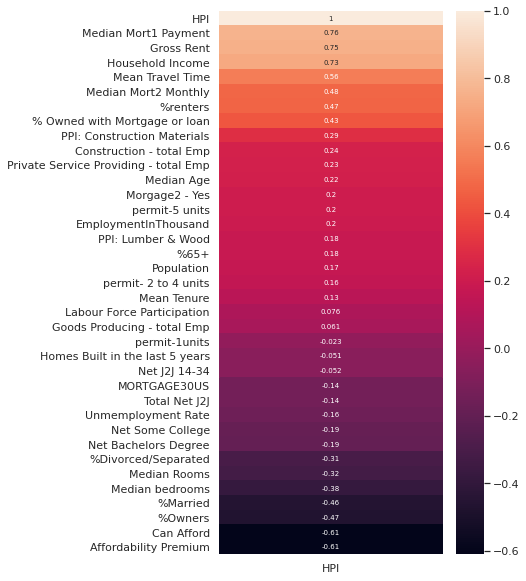

In [61]:
fig, ax = plt.subplots(figsize=(5,10))
sns.heatmap(df1.corr().loc[:,['HPI']].sort_values(by='HPI', ascending=False), ax = ax, annot=True, annot_kws={"size": 7})

In [62]:
df2 = df1.dropna()
df2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3600 entries, 0 to 3599
Data columns (total 39 columns):
 #   Column                                 Non-Null Count  Dtype         
---  ------                                 --------------  -----         
 0   Gross Rent                             3600 non-null   float64       
 1   %Owners                                3600 non-null   float64       
 2   %renters                               3600 non-null   float64       
 3   Population                             3600 non-null   float64       
 4   %65+                                   3600 non-null   float64       
 5   Median Age                             3600 non-null   float64       
 6   %Married                               3600 non-null   float64       
 7   %Divorced/Separated                    3600 non-null   float64       
 8   Household Income                       3600 non-null   float64       
 9   Mean Tenure                            3600 non-null   float64 

In [63]:
df2.head()

,Gross Rent,%Owners,%renters,Population,%65+,Median Age,%Married,%Divorced/Separated,Household Income,Mean Tenure,Median Rooms,Median bedrooms,% Owned with Mortgage or loan,Mean Travel Time,Morgage2 - Yes,Median Mort1 Payment,Median Mort2 Monthly,Homes Built in the last 5 years,Affordability Premium,Can Afford,HPI,EmploymentInThousand,Unmemployment Rate,Labour Force Participation,MORTGAGE30US,PPI: Construction Materials,PPI: Lumber & Wood,permit-1units,permit- 2 to 4 units,permit-5 units,Goods Producing - total Emp,Private Service Providing - total Emp,Construction - total Emp,Net Some College,Net Bachelors Degree,Total Net J2J,Net J2J 14-34,State Name,Date
0,488.698630,0.711596,0.288404,4.354685e+06,0.127354,35.768811,0.542288,0.132169,35567.123288,11.390386,5.541084,2.785558,61.793242,21.725830,135728.054795,539.863014,282.602740,178242.268493,25214.564892,1.0,226.31,1885.533333,6.233334,61.733334,6.968000,142.466667,172.866667,3566.600015,53.200000,875.780618,422.6,1115.7,100.5,39.0,120.0,250.0,-25.0,Alabama,2002-03-01
1,492.438356,0.716172,0.283828,4.359826e+06,0.127760,35.821367,0.546158,0.128508,36140.547945,11.494071,5.555273,2.793654,61.516842,21.811721,140983.865753,549.835616,275.123288,173538.042192,28255.939136,1.0,227.52,1903.500000,5.700000,62.000000,6.813667,143.866667,174.466667,3728.531854,83.300000,1072.285410,422.3,1123.8,100.0,-254.0,-122.0,-975.0,-550.0,Alabama,2002-06-01
2,496.219178,0.720799,0.279201,4.365024e+06,0.128170,35.874500,0.550070,0.124807,36720.273973,11.598896,5.569617,2.801839,61.237404,21.898556,146297.432877,559.917808,267.561644,168782.121096,31330.735074,1.0,230.88,1894.300000,6.033333,62.200001,6.289167,145.066667,170.633333,3582.998176,55.300000,1078.350373,421.5,1122.4,102.1,-77.0,-141.0,-112.0,-207.0,Alabama,2002-09-01
3,500.000000,0.725426,0.274574,4.370221e+06,0.128581,35.927634,0.553982,0.121106,37300.000000,11.703720,5.583962,2.810024,60.957966,21.985391,151611.000000,570.000000,260.000000,164026.200000,34405.531013,1.0,233.54,1910.200000,5.733334,62.266666,6.076000,144.633333,165.233333,3517.758520,82.731429,329.772808,415.8,1129.7,99.2,64.0,158.0,285.0,101.0,Alabama,2002-12-01
4,500.493151,0.723280,0.276720,4.373975e+06,0.128518,36.039736,0.548078,0.124229,37079.315068,11.642223,5.572436,2.801897,60.971514,21.906755,144765.328767,567.534247,261.574262,160863.279452,35947.822143,1.0,235.89,1881.200000,6.133333,61.900002,5.834500,144.933333,165.800000,3705.821986,126.280453,572.865916,409.8,1115.0,99.3,313.0,479.0,1349.0,499.0,Alabama,2003-03-01


Making list of states

In [64]:
#States by top HPI Value
state=pd.DataFrame(df2.groupby('State Name')['HPI'].last()).sort_values(by='HPI',ascending=False).reset_index()
state_name=state['State Name']

In [65]:
print(state)

              State Name     HPI
0   District of Columbia  918.10
1          Massachusetts  830.75
2               New York  718.64
3             California  667.81
4             Washington  667.65
5                 Hawaii  651.49
6                 Oregon  590.76
7               Colorado  590.57
8                  Maine  579.51
9             New Jersey  543.49
10                  Utah  516.05
11         New Hampshire  510.95
12               Vermont  503.70
13               Montana  490.52
14              Maryland  488.42
15              Virginia  484.89
16              Delaware  481.62
17               Florida  481.40
18                 Idaho  462.81
19          Pennsylvania  450.47
20               Arizona  436.09
21             Minnesota  417.67
22           Connecticut  414.73
23        South Carolina  414.58
24             Tennessee  406.52
25        North Carolina  406.33
26                Nevada  405.49
27          South Dakota  402.45
28               Georgia  389.63
29        

In [66]:
df2 = df2.reset_index(drop=True)

In [67]:
df2.head()

,Gross Rent,%Owners,%renters,Population,%65+,Median Age,%Married,%Divorced/Separated,Household Income,Mean Tenure,Median Rooms,Median bedrooms,% Owned with Mortgage or loan,Mean Travel Time,Morgage2 - Yes,Median Mort1 Payment,Median Mort2 Monthly,Homes Built in the last 5 years,Affordability Premium,Can Afford,HPI,EmploymentInThousand,Unmemployment Rate,Labour Force Participation,MORTGAGE30US,PPI: Construction Materials,PPI: Lumber & Wood,permit-1units,permit- 2 to 4 units,permit-5 units,Goods Producing - total Emp,Private Service Providing - total Emp,Construction - total Emp,Net Some College,Net Bachelors Degree,Total Net J2J,Net J2J 14-34,State Name,Date
0,488.698630,0.711596,0.288404,4.354685e+06,0.127354,35.768811,0.542288,0.132169,35567.123288,11.390386,5.541084,2.785558,61.793242,21.725830,135728.054795,539.863014,282.602740,178242.268493,25214.564892,1.0,226.31,1885.533333,6.233334,61.733334,6.968000,142.466667,172.866667,3566.600015,53.200000,875.780618,422.6,1115.7,100.5,39.0,120.0,250.0,-25.0,Alabama,2002-03-01
1,492.438356,0.716172,0.283828,4.359826e+06,0.127760,35.821367,0.546158,0.128508,36140.547945,11.494071,5.555273,2.793654,61.516842,21.811721,140983.865753,549.835616,275.123288,173538.042192,28255.939136,1.0,227.52,1903.500000,5.700000,62.000000,6.813667,143.866667,174.466667,3728.531854,83.300000,1072.285410,422.3,1123.8,100.0,-254.0,-122.0,-975.0,-550.0,Alabama,2002-06-01
2,496.219178,0.720799,0.279201,4.365024e+06,0.128170,35.874500,0.550070,0.124807,36720.273973,11.598896,5.569617,2.801839,61.237404,21.898556,146297.432877,559.917808,267.561644,168782.121096,31330.735074,1.0,230.88,1894.300000,6.033333,62.200001,6.289167,145.066667,170.633333,3582.998176,55.300000,1078.350373,421.5,1122.4,102.1,-77.0,-141.0,-112.0,-207.0,Alabama,2002-09-01
3,500.000000,0.725426,0.274574,4.370221e+06,0.128581,35.927634,0.553982,0.121106,37300.000000,11.703720,5.583962,2.810024,60.957966,21.985391,151611.000000,570.000000,260.000000,164026.200000,34405.531013,1.0,233.54,1910.200000,5.733334,62.266666,6.076000,144.633333,165.233333,3517.758520,82.731429,329.772808,415.8,1129.7,99.2,64.0,158.0,285.0,101.0,Alabama,2002-12-01
4,500.493151,0.723280,0.276720,4.373975e+06,0.128518,36.039736,0.548078,0.124229,37079.315068,11.642223,5.572436,2.801897,60.971514,21.906755,144765.328767,567.534247,261.574262,160863.279452,35947.822143,1.0,235.89,1881.200000,6.133333,61.900002,5.834500,144.933333,165.800000,3705.821986,126.280453,572.865916,409.8,1115.0,99.3,313.0,479.0,1349.0,499.0,Alabama,2003-03-01


Target Variable

In [68]:
target = df2[['State Name', 'Date', 'HPI']]

In [69]:
# normalized the data 
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
scaled = scaler.fit_transform(df2.drop(columns=['State Name', 'Date', 'HPI']))

In [70]:

scaled_df=pd.DataFrame(data=scaled,columns=df2.drop(columns=['State Name', 'Date', 'HPI']).columns)

In [71]:
scaled_df.head()

,Gross Rent,%Owners,%renters,Population,%65+,Median Age,%Married,%Divorced/Separated,Household Income,Mean Tenure,Median Rooms,Median bedrooms,% Owned with Mortgage or loan,Mean Travel Time,Morgage2 - Yes,Median Mort1 Payment,Median Mort2 Monthly,Homes Built in the last 5 years,Affordability Premium,Can Afford,EmploymentInThousand,Unmemployment Rate,Labour Force Participation,MORTGAGE30US,PPI: Construction Materials,PPI: Lumber & Wood,permit-1units,permit- 2 to 4 units,permit-5 units,Goods Producing - total Emp,Private Service Providing - total Emp,Construction - total Emp,Net Some College,Net Bachelors Degree,Total Net J2J,Net J2J 14-34
0,-1.411900,0.781309,-0.781309,-0.259171,-0.442809,-0.493429,1.098149,0.137593,-1.513458,0.220156,0.123648,0.143128,-0.476626,-0.171799,-0.267976,-1.489190,0.085015,0.290940,0.105896,0.590784,-0.294588,0.289990,-0.852834,1.949570,-1.995997,-0.555487,-0.153410,-0.529015,-0.296488,0.039575,-0.376871,-0.269796,0.036474,0.139539,0.013469,-0.141344
1,-1.394494,0.862509,-0.862509,-0.258416,-0.425145,-0.471558,1.173798,-0.095388,-1.461966,0.294027,0.160573,0.190215,-0.519330,-0.146494,-0.244625,-1.455803,-0.070462,0.261648,0.146740,0.590784,-0.288393,0.031907,-0.790292,1.801667,-1.943190,-0.496671,-0.128784,-0.442726,-0.224246,0.038849,-0.372955,-0.273201,-0.300758,-0.133185,-0.339322,-0.443175
2,-1.376896,0.944601,-0.944601,-0.257653,-0.407287,-0.449446,1.250279,-0.330930,-1.409908,0.368709,0.197904,0.237819,-0.562503,-0.120911,-0.221017,-1.422048,-0.227647,0.232034,0.188032,0.590784,-0.291565,0.193209,-0.743386,1.299021,-1.897927,-0.637585,-0.150916,-0.522995,-0.222017,0.036913,-0.373632,-0.258901,-0.097038,-0.154597,-0.090785,-0.245979
3,-1.359299,1.026693,-1.026693,-0.256889,-0.389429,-0.427335,1.326759,-0.566472,-1.357850,0.443392,0.235235,0.285423,-0.605676,-0.095328,-0.197409,-1.388293,-0.384832,0.202420,0.229325,0.590784,-0.286083,0.048037,-0.727750,1.094736,-1.914272,-0.836090,-0.160837,-0.444356,-0.497218,0.023122,-0.370102,-0.278648,0.065248,0.182364,0.023548,-0.068904
4,-1.357004,0.988616,-0.988616,-0.256338,-0.392164,-0.380683,1.211339,-0.367704,-1.377667,0.399578,0.205239,0.238153,-0.603583,-0.118496,-0.227824,-1.396549,-0.352108,0.182725,0.250037,0.590784,-0.296082,0.241600,-0.813745,0.863299,-1.902956,-0.815259,-0.132237,-0.319511,-0.407849,0.008604,-0.377209,-0.277967,0.351837,0.544118,0.329972,0.159913


In [72]:
df3=df2.copy()
df3[scaled_df.columns]=np.array(scaled_df)
df3['Name2']=list(df3['State Name'])
df3['HPI'] = target['HPI']

In [73]:
df3=df3.set_index(['State Name','Date'])
df3.tail()

Gross Rent   %Owners  %renters  Population      %65+  Median Age  %Married  %Divorced/Separated  Household Income  Mean Tenure  Median Rooms  Median bedrooms  % Owned with Mortgage or loan  Mean Travel Time  Morgage2 - Yes  Median Mort1 Payment  Median Mort2 Monthly  Homes Built in the last 5 years  Affordability Premium  Can Afford     HPI  EmploymentInThousand  Unmemployment Rate  Labour Force Participation  MORTGAGE30US  PPI: Construction Materials  PPI: Lumber & Wood  permit-1units  permit- 2 to 4 units  permit-5 units  Goods Producing - total Emp  Private Service Providing - total Emp  Construction - total Emp  Net Some College  Net Bachelors Degree  Total Net J2J  Net J2J 14-34    Name2
State Name Date                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                     
Wyoming    2018-12-01    0.004454  0.601849 -0.601849   -0.813942  1.357970    0.412187  0.405977             0.857008          0.748796    -0.058691      0.750461         0.936877                      -0.937877         -1.952131       -0.829083              0.386121              0.771690                        -0.752976               0.335495    0.590784  317.15             -0.845619           -0.903647                    0.038389     -0.149340                     1.630085            0.836499      -0.650303             -0.633928       -0.568045                    -0.855667                              -0.836714                 -0.807741          0.122796              0.048256       0.054939      -0.020611  Wyoming
           2019-03-01    0.012487  0.673696 -0.673696   -0.813905  1.393873    0.387648  0.519191             0.727827          0.862605    -0.115451      0.803510         1.037942                      -0.932754         -1.802407       -0.829256              0.386121              0.691545                        -0.755198               0.435695    0.590784  317.17             -0.847308           -0.726215                   -0.063242     -0.543695                     1.616254            0.987215      -0.656239             -0.654803       -0.612479                    -0.858328                              -0.837633                 -0.813870          0.016907              0.013320      -0.028290      -0.089026  Wyoming
           2019-06-01    0.020610  0.746342 -0.746342   -0.813868  1.430175    0.362837  0.633662             0.597211          0.977678    -0.172843      0.857148         1.140131                      -0.927573         -1.651020       -0.829431              0.386121              0.610508                        -0.757444               0.537009    0.590784  325.82             -0.844056           -1.048820                    0.014936     -0.889333                     1.567219            0.870808      -0.618719             -0.577303       -0.596946                    -0.849376                              -0.832218                 -0.791399         -0.000357              0.034732      -0.016195      -0.064305  Wyoming
           2019-09-01    0.028822  0.819786 -0.819786   -0.813830  1.466876    0.337752  0.749391             0.465160          1.094016    -0.230865      0.911376         1.243442                      -0.922335         -1.497970       -0.829608              0.386121              0.528581                        -0.759715               0.639436    0.590784  330.66             -0.842125           

Looping Train Test Split for each state:

In [74]:
def train_test_split(data):
    size=int(len(data)*0.8)
    # for train data will be collected from each state's data which index is from 0-size (80%)
    x_train =data.drop(columns=['HPI']).iloc[0:size] 
    # for test data will be collected from each state's data which index is from size to the end (20%)
    x_test = data.drop(columns=['HPI']).iloc[size:]
    y_train=data['HPI'].iloc[0:size] 
    y_test=data['HPI'].iloc[size:] 
    return x_train, x_test,y_train,y_test

In [75]:
state1=list(set(df3.Name2))
# loop each station and collect train and test data 
X_train=[]
X_test=[]
Y_train=[]
Y_test=[]
for i in range(0,len(state1)):
    data=df3[df3['Name2']==state1[i]]
    x_train, x_test,y_train,y_test=train_test_split(data)
    X_train.append(x_train)
    X_test.append(x_test)
    Y_train.append(y_train)
    Y_test.append(y_test)


Merging train and test sets together

In [76]:
# concat each train data from each station 
X_train=pd.concat(X_train)
Y_train=pd.DataFrame(pd.concat(Y_train))
# concat each test data from each station 
X_test=pd.concat(X_test)
Y_test=pd.DataFrame(pd.concat(Y_test))

In [77]:
X_train.head(20)

Gross Rent   %Owners  %renters  Population      %65+  Median Age  %Married  %Divorced/Separated  Household Income  Mean Tenure  Median Rooms  Median bedrooms  % Owned with Mortgage or loan  Mean Travel Time  Morgage2 - Yes  Median Mort1 Payment  Median Mort2 Monthly  Homes Built in the last 5 years  Affordability Premium  Can Afford  EmploymentInThousand  Unmemployment Rate  Labour Force Participation  MORTGAGE30US  PPI: Construction Materials  PPI: Lumber & Wood  permit-1units  permit- 2 to 4 units  permit-5 units  Goods Producing - total Emp  Private Service Providing - total Emp  Construction - total Emp  Net Some College  Net Bachelors Degree  Total Net J2J  Net J2J 14-34  Name2
State Name Date                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                           
Idaho      2002-03-01   -1.325506  1.187600 -1.187600   -0.708715 -1.216721   -1.562848  2.005230            -1.020834         -1.456873    -0.943426      0.147425         0.163158                       0.221509         -1.130380       -0.639104             -1.087436             -0.592704                        -0.486772              -0.060655    0.590784             -0.755138            0.660986                    0.945249      1.949570                    -1.995997           -0.555487      -0.414665             -0.438231       -0.551698                    -0.741947                              -0.751186                 -0.736923         -0.152284             -0.039647      -0.191294      -0.257477  Idaho
           2002-06-01   -1.328988  1.256052 -1.256052   -0.708026 -1.221124   -1.538633  1.935927            -0.860512         -1.438963    -0.921660      0.235205         0.252701                       0.285938         -1.094988       -0.634399             -1.054048             -0.592704                        -0.488216              -0.094019    0.590784             -0.748001           -0.081005                    0.999973      1.801667                    -1.943190           -0.496671      -0.258268             -0.345055       -0.531450                    -0.719687                              -0.744320                 -0.691300          0.150419              0.133905       0.008285      -0.171239  Idaho
           2002-09-01   -1.332507  1.325256 -1.325256   -0.707329 -1.225574   -1.514152  1.865861            -0.698429         -1.420856    -0.899656      0.323949         0.343227                       0.351075         -1.059207       -0.629641             -1.020294             -0.592704                        -0.489676              -0.127749    0.590784             -0.745760           -0.419740                    0.976520      1.299021                    -1.897927           -0.637585      -0.289582             -0.213054       -0.477667                    -0.716784                              -0.743208                 -0.685853          0.052587              0.149682       0.040828       0.081150  Idaho
           2002-12-01   -1.336027  1.394460 -1.394460   -0.706632 -1.230025   -1.489671  1.795796            -0.536345         -1.402749    -0.877651      0.412693         0.433754                       0.416212         -1.023425       -0.624884             -0.986539             -0.592704                        -0.491136              -0.161479    0.590784             -0.745588           -0.177787                    0.827983      1.094736       

In [78]:
X_train.tail(20)

Gross Rent   %Owners  %renters  Population      %65+  Median Age  %Married  %Divorced/Separated  Household Income  Mean Tenure  Median Rooms  Median bedrooms  % Owned with Mortgage or loan  Mean Travel Time  Morgage2 - Yes  Median Mort1 Payment  Median Mort2 Monthly  Homes Built in the last 5 years  Affordability Premium  Can Afford  EmploymentInThousand  Unmemployment Rate  Labour Force Participation  MORTGAGE30US  PPI: Construction Materials  PPI: Lumber & Wood  permit-1units  permit- 2 to 4 units  permit-5 units  Goods Producing - total Emp  Private Service Providing - total Emp  Construction - total Emp  Net Some College  Net Bachelors Degree  Total Net J2J  Net J2J 14-34     Name2
State Name Date                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                              
New York   2011-06-01    0.920997 -2.267631  2.267631    1.954912 -0.064929    0.241709 -1.247697            -1.045428          0.231563     1.500228     -1.599383        -1.675834                      -0.070089          1.935703        1.576492              1.055712              0.446655                         0.484347              -0.579437   -1.785503              2.060098            1.144893                   -0.884105     -0.259868                     0.231956           -1.019891      -0.227876              0.743383        0.521655                     0.923928                               2.197400                  1.222152         -0.677122             -1.741355      -0.300731       0.565805  New York
           2011-09-01    0.944460 -2.289129  2.289129    1.957612 -0.048723    0.247071 -1.275674            -0.977705          0.231563     1.529994     -1.618833        -1.683827                      -0.094744          1.980553        1.533224              1.055712              0.446655                         0.459925              -0.521283   -1.785503              2.051031            1.338456                   -0.821564     -0.600556                     0.275962           -1.035821      -0.296905              1.650144        0.007537                     0.944495                               2.199383                  1.284799         -1.226130             -3.244718      -1.050951      -0.565633  New York
           2011-12-01    0.967924 -2.310627  2.310627    1.960311 -0.032517    0.252432 -1.303651            -0.909981          0.231563     1.559760     -1.638282        -1.691820                      -0.119398          2.025402        1.489957              1.055712              0.446655                         0.435504              -0.463128   -1.785503              2.104287            1.290065                   -0.923194     -0.889014                     0.263389           -1.105665      -0.383518              0.320471        0.357656                     0.895861                               2.263976                  1.158143         -2.110068             -2.995660      -1.997870      -1.748238  New York
           2012-03-01    0.991069 -2.312881  2.312881    1.964148  0.009116    0.259646 -1.332235            -0.893614          0.269519     1.561377     -1.643234        -1.702821                      -0.115771          2.036959        1.441505              1.055712              0.446655                         0.375571              -0.367337   -1.194678              2.042296            1.709451                   -0.938829     -

**Converting data for LSTM**

In [79]:

def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):
    n_vars = 1 if type(data) is list else data.shape[1]
    df = pd.DataFrame(data)
    cols, names = list(), list()
    # input sequence (t-n, ... t-1)
    for i in range(n_in, 0, -1):
        cols.append(df.shift(i))
        names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # forecast sequence (t, t+1, ... t+n)
    for i in range(0, n_out):
        cols.append(df.shift(-i))
        if i == 0:
            names += [('var%d(t)' % (j+1)) for j in range(n_vars)]
        else:
            names += [('var%d(t+%d)' % (j+1, i)) for j in range(n_vars)]
    # put it all together
    agg = pd.concat(cols, axis=1)
    agg.columns = names
    # drop rows with NaN values
    if dropnan:
        agg.dropna(inplace=True)
    return agg

# create the reshape function
# create the reshape function
def reshape_data(train,test):
    #Frame as supervised learning and drop all time t columns except PM2.5
    reframed_train = series_to_supervised(train, 1, 1)
    reframed_test = series_to_supervised(test, 1, 1)
    # split into train and test sets
    train= reframed_train.values
    test=reframed_test.values
    # split into input and outputs
    train_X, y_train = train[:, :-1], train[:, -1]
    test_X, y_test = test[:, :-1], test[:, -1]
    # reshape input to be 3D [samples, timesteps, features]
    x_train = train_X.reshape((train_X.shape[0], 1, train_X.shape[1]))
    x_test = test_X.reshape((test_X.shape[0], 1, test_X.shape[1]))
    return x_train,x_test,y_train,y_test

In [80]:
encoder = LabelEncoder()
#combine x train and y train as train data 
train_data=pd.DataFrame()
train_data[X_train.columns]=X_train
train_data[Y_train.columns]=Y_train
train_data['Name2']= encoder.fit_transform(train_data['Name2'])
#combine x test and y test as test data 
test_data=pd.DataFrame()
test_data[X_test.columns]=X_test
test_data[Y_test.columns]=Y_test
test_data['Name2']= encoder.fit_transform(test_data['Name2'])
test_data.shape

(750, 38)

In [81]:
train_data.shape[1]

38

In [82]:
# using the function to obtian reshaped x_train,x_test,y_train,y_test
x_train,x_test,y_train,y_test=reshape_data(train_data,test_data)

In [83]:
len(x_test)

749

**LSMT WITH ALL STATE**

In [84]:
# design network for HPI
model = Sequential()
model.add(LSTM(60, activation='relu',input_shape=(x_train.shape[1], x_train.shape[2])))

model.add(Dense(1))
model.compile(loss='mae', optimizer='adam')
# fit network
history = model.fit(x_train, y_train, epochs=20, batch_size=50, verbose=0, shuffle=False)

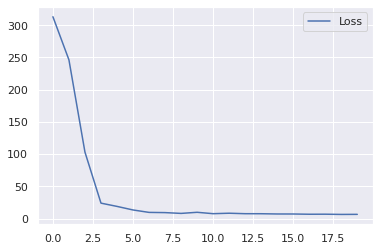

In [85]:

# plot history
plt.plot(history.history['loss'], label='Loss')
plt.legend()
plt.show()

In [86]:
# make a prediction
y_test_pre=model.predict(x_test)

In [87]:
y_test_pre.shape,y_test.shape

((749, 1), (749,))

Actual v Predicted

In [88]:
# a little tricky thing is y_test prediction has one day lag so we need re-match the date 
len([i[0] for i in y_test_pre][1:]),len(y_test[:-1])

(748, 748)

In [89]:
pa=pd.DataFrame()
pa['Date']=X_test.reset_index().Date.iloc[1:-1]
pa['Prediction']=[i[0] for i in y_test_pre][1:] 
pa['Actual Values']=y_test[:-1]
pa.head()

,Date,Prediction,Actual Values
1,2016-09-01,338.448975,335.99
2,2016-12-01,339.406006,337.19
3,2017-03-01,345.977112,343.23
4,2017-06-01,360.599640,357.70
5,2017-09-01,367.884125,365.15


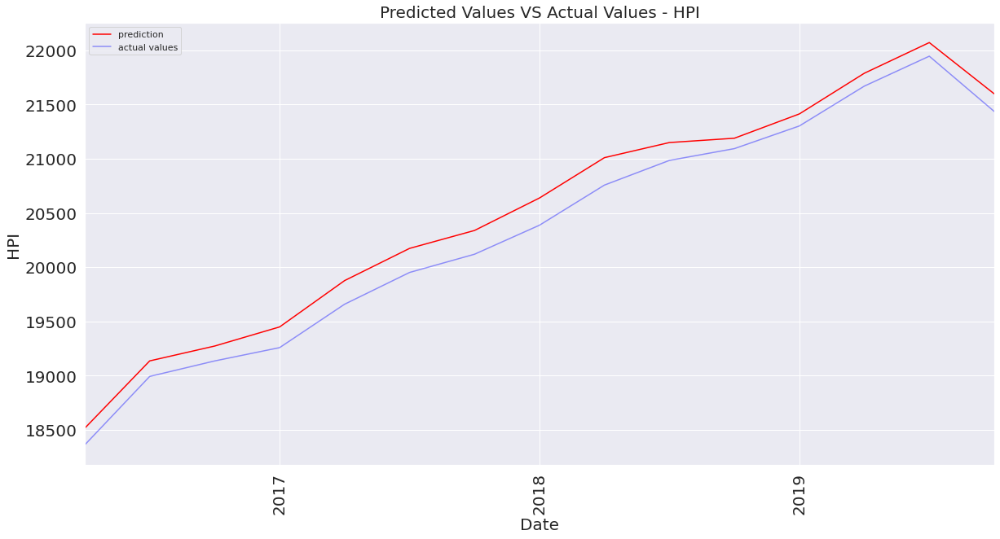

In [90]:
plt.figure(figsize=(20,10))
pa.groupby('Date')['Prediction'].sum().plot(kind='line',label='prediction',color='red',alpha=1)
pa.groupby("Date")['Actual Values'].sum().plot(kind='line',label='actual values',color='blue',alpha=0.4)
plt.xticks(rotation=90,size=20)
plt.yticks(size=20)

plt.ylabel('HPI',fontsize=20)
plt.xlabel('Date',fontsize=20)
plt.title('Predicted Values VS Actual Values - HPI',fontsize=20)
plt.legend()

Error

In [91]:
from sklearn.metrics import mean_squared_error, r2_score
def RMSE(actual,prediction):
    rmse = np.sqrt(mean_squared_error(actual,prediction))
    r2 = r2_score(actual, prediction)
    print("R2 Value: ", r2)
    print("RMSE Value: ", rmse)

In [92]:
RMSE(y_test, y_test_pre)

R2 Value:  0.8737183164146065
RMSE Value:  47.28211278827349


**Looping the model for each state**

In [93]:
def normalization_train_test_split(states):
    scaler = StandardScaler()
    scaled = scaler.fit_transform(states.drop(columns=['HPI','Date', 'State Name', 'Name2']))
    # create datefrane fir scaled data
    scaled_df=pd.DataFrame(data=scaled,columns=states.drop(columns=['HPI','Date', 'State Name', 'Name2']).columns)
    scaled_df['HPI']=list(states['HPI'])
    X_train, X_test,Y_train,Y_test=train_test_split(scaled_df)
    #combine x train and y train as train data 
    train_data=pd.DataFrame()
    train_data[X_train.columns]=X_train
    train_data['HPI']=Y_train
    #combine x test and y test as test data 
    test_data=pd.DataFrame()
    test_data[X_test.columns]=X_test
    test_data['HPI']=Y_test

    # using the function to obtian reshaped x_train,x_test,y_train,y_test
    x_train,x_test,y_train,y_test=reshape_data(train_data,test_data)
    return x_train, x_test,y_train,y_test

In [94]:
state = state.reset_index()
df3 = df3.reset_index()

In [95]:
df3.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3600 entries, 0 to 3599
Data columns (total 40 columns):
 #   Column                                 Non-Null Count  Dtype         
---  ------                                 --------------  -----         
 0   State Name                             3600 non-null   object        
 1   Date                                   3600 non-null   datetime64[ns]
 2   Gross Rent                             3600 non-null   float64       
 3   %Owners                                3600 non-null   float64       
 4   %renters                               3600 non-null   float64       
 5   Population                             3600 non-null   float64       
 6   %65+                                   3600 non-null   float64       
 7   Median Age                             3600 non-null   float64       
 8   %Married                               3600 non-null   float64       
 9   %Divorced/Separated                    3600 non-null   float64 

In [96]:
!pip install eli5

     |████████████████████████████████| 112kB 20.5MB/s 


In [97]:
!pip install shap==0.36

     |████████████████████████████████| 327kB 24.6MB/s 
  Created wheel for shap: filename=shap-0.36.0-cp37-cp37m-linux_x86_64.whl size=457591 sha256=25bdf0ff260b60360487d5aa689d47ec8150e6ecc0165b71f80a85aebb75ca57
  Stored in directory: /root/.cache/pip/wheels/fb/15/e1/8f61106790da27e0765aaa6e664550ca2c50ea339099e799f4
Successfully built shap


In [98]:
from keras.wrappers.scikit_learn import KerasRegressor
from eli5.sklearn import PermutationImportance
from keras import callbacks
import shap

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:144: FutureWarning: The sklearn.feature_selection.base module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.feature_selection. Anything that cannot be imported from sklearn.feature_selection is now part of the private API.
  warnings.warn(message, FutureWarning)


In [99]:
total_features = df3.drop(columns=['HPI','Date', 'State Name', 'Name2']).columns

**Sequential Model**

In [100]:
from tensorflow.keras import Sequential

----------------------------------------------------------------------------------------------------
District of Columbia
R2 Value:  0.9723574992032449
RMSE Value:  6.710304674788978


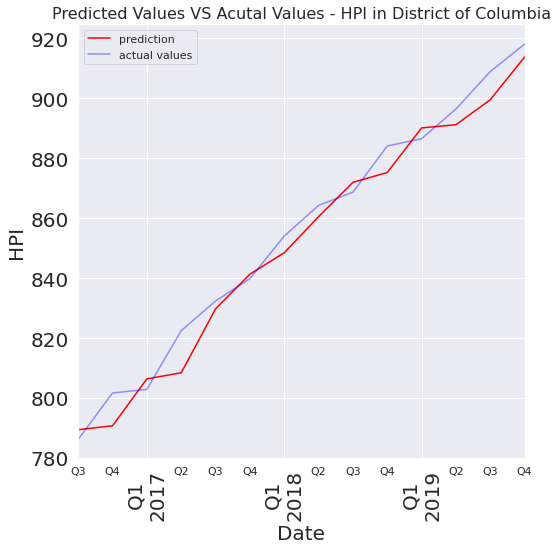

----------------------------------------------------------------------------------------------------
Massachusetts
R2 Value:  0.9646854373914198
RMSE Value:  7.2022088133964735


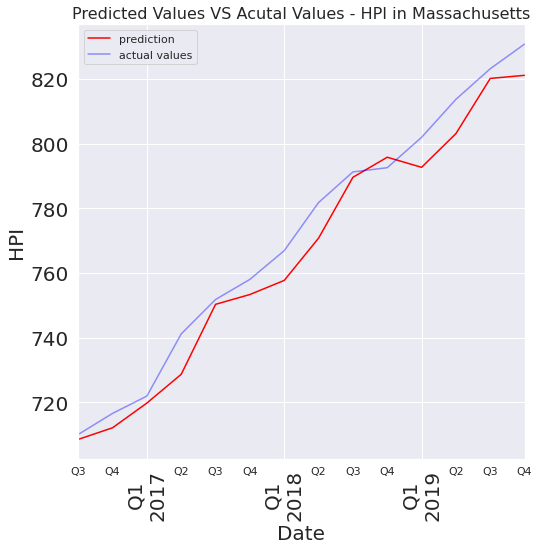

----------------------------------------------------------------------------------------------------
New York
R2 Value:  0.9394968710487543
RMSE Value:  7.834293589174064


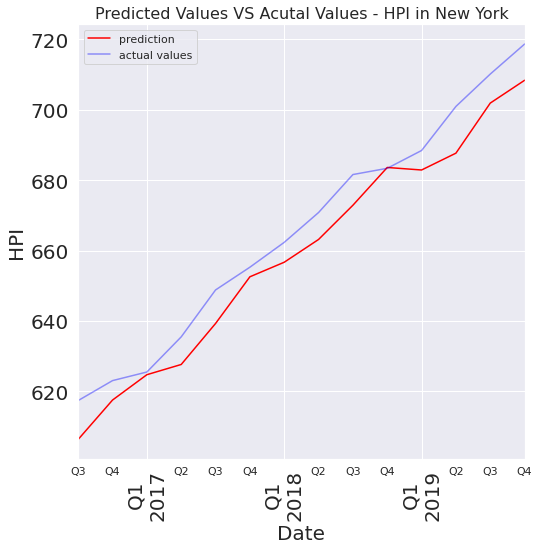

----------------------------------------------------------------------------------------------------
California
R2 Value:  0.8901854571758625
RMSE Value:  10.874613505546836


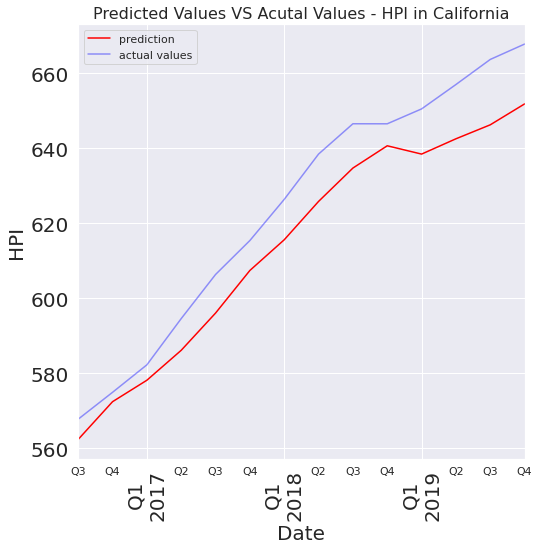

----------------------------------------------------------------------------------------------------
Washington
R2 Value:  0.9797430040361641
RMSE Value:  6.791737538959243


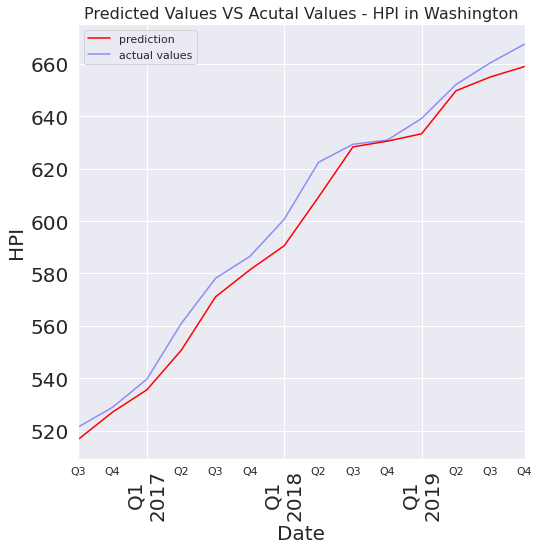

In [101]:
for i in range(len(state_name[0:5])): 
    print('-'*100)
    print(state_name[i])
    # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # 
    state2=df3[df3.Name2==state_name[i]]
    # train test split, nomalization and reshape the data
    x_train, x_test,y_train,y_test= normalization_train_test_split(state2)
    # model
    model = Sequential()
    model.add(LSTM(60, activation='relu',input_shape=(x_train.shape[1], x_train.shape[2])))
    model.add(Dense(1))
    model.compile(loss='mae', optimizer='adam')

    # my_callbacks = [
    # callbacks.EarlyStopping(patience=2, monitor="loss")
    # ]
    history  = model.fit(x_train, y_train, epochs=500, batch_size=20,  verbose=0, shuffle=False)
    y_test_pre= model.predict(x_test)
    RMSE(y_test,y_test_pre)
    # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # A
    #create new dataframe for plot 
    pa=pd.DataFrame()
    pa['Date']=list(state2.Date.iloc[int(len(state2)*0.8)+1:])
    pa['Prediction']= list(y_test_pre)
    pa['Actual Values']=list(y_test)

    plt.figure(figsize=(8,8))
    pa.groupby('Date')['Prediction'].sum().plot(kind='line',label='prediction', color='red',alpha=1)
    pa.groupby("Date")['Actual Values'].sum().plot(kind='line',label='actual values', color='blue',alpha=0.4)
    plt.xticks(rotation=90,size=20)
    plt.yticks(size=20)

    plt.ylabel('HPI',fontsize=20)
    plt.xlabel('Date',fontsize=20)
    plt.title('Predicted Values VS Acutal Values - HPI in {}'.format(state_name[i]),fontsize=16)
    plt.legend()
    plt.show()

***Installing Lib***

In [102]:
!pip install eli5

In [103]:
!pip install catboost

     |████████████████████████████████| 69.2MB 41kB/s 


In [104]:
!pip install yellowbrick

In [105]:
from sklearn.model_selection import TimeSeriesSplit
import sklearn.metrics as metrics
from sklearn.linear_model import LinearRegression
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.svm import SVR
from sklearn.neural_network import MLPRegressor
from sklearn.model_selection import cross_validate
from yellowbrick.regressor import ResidualsPlot, PredictionError
from catboost import CatBoostRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.svm import SVR
from eli5.sklearn import PermutationImportance
import eli5
from IPython.display import display
from sklearn.inspection import permutation_importance
from sklearn.metrics import mean_absolute_error as MAE
from sklearn.metrics import mean_squared_error as MSE

The sklearn.metrics.classification module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.metrics. Anything that cannot be imported from sklearn.metrics is now part of the private API.


**Support Vector Machine**

R2 Value:  0.7022457557450601
RMSE Value:  23.407950437122654


Weight,Feature
0.2056 ± 0.1592,Household Income
0.0913 ± 0.0554,Median Mort2 Monthly
0.0296 ± 0.0485,Unmemployment Rate
0.0193 ± 0.0196,Net J2J 14-34
0.0169 ± 0.0469,Gross Rent
0.0045 ± 0.0642,Median Mort1 Payment
0.0038 ± 0.0026,Mean Travel Time
0.0029 ± 0.0113,Median Rooms
0.0023 ± 0.0031,Total Net J2J
0.0021 ± 0.0024,%Married


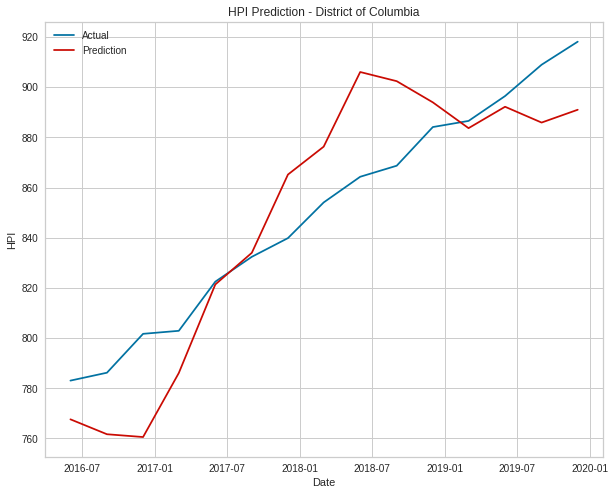

In [106]:
for i in range(len(state_name[0:1])): 
     # obtian one state's data 
    state2=df3[df3.Name2==state_name[i]]
    x_train, x_test, y_train, y_test= train_test_split(state2.drop(columns=['State Name', 'Name2', 'Date']))
    # train test split, nomalization and reshape the data
    # mdl = GradientBoostingRegressor(n_estimators=180, learning_rate=0.1, max_depth=4, random_state=1232, loss='ls')
    mdl = SVR(kernel='poly', C=200, gamma='auto', degree=1, epsilon=5, coef0=2)
    # mdl = SVR(kernel='rbf', probability=True)
    mdl.fit(x_train, y_train)   
    y_test_pred = mdl.predict(x_test)
    RMSE(y_test, y_test_pred)


    features_names = list(state2.drop(columns=['State Name', 'Name2', 'Date', "HPI"]).columns)
    perm = PermutationImportance(mdl).fit(x_test, y_test)
    display(eli5.show_weights(perm, feature_names= features_names, top=36))
    perm_importance = permutation_importance(mdl, x_test, y_test)


    # explainer = shap.KernalExplainer(mdl, x_train)
    # shap_values = explainer.shap_values(x_test, nsamples=100)
    # shap.force_plot(explainer.expected_value[0], shap_values[0], x_test, link="logit")

    plt.figure(figsize=(10, 8))
    plt.plot(list(state2.Date.iloc[int(len(state2)*0.8):]), y_test, 'b-', label = 'Actual')
    plt.plot(list(state2.Date.iloc[int(len(state2)*0.8):]), y_test_pred, 'r-', label = 'Prediction')
    plt.xlabel('Date'); plt.ylabel('HPI'); plt.title('HPI Prediction - '+state_name[i])
    plt.legend();


**Random Forest + Time Series Split**

Test score:  -36.14865205869977
Train score 0.9943654032009139


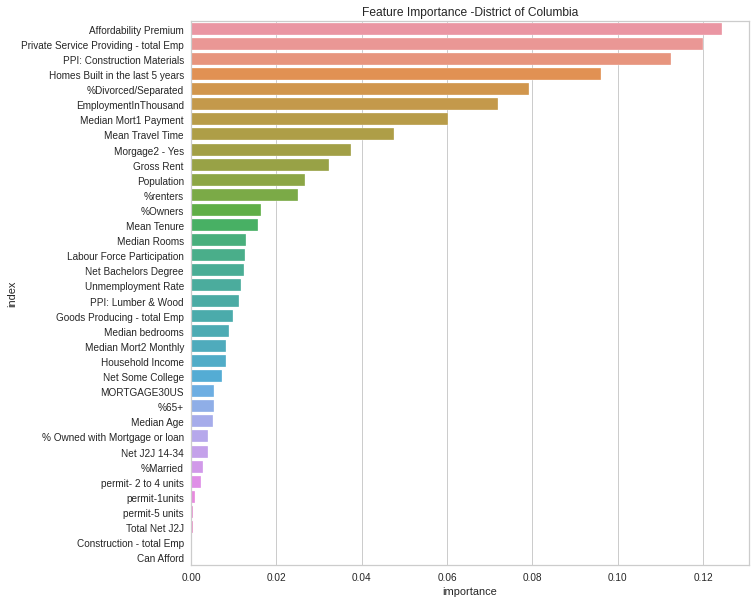

In [107]:
for i in range(len(state_name[0:1])): 
     # obtian one state's data 
    state2=df3[df3.Name2==state_name[i]]
    #Box Plot
    # arr = []
    # for col in state2.drop(columns=["Name2", "State Name", "Date", "HPI"]).columns:
    #   arr.append(list(state2[col]))
    # fig, ax = plt.subplots(figsize=(25,10))
    # ax.boxplot(x=arr)
    # ax.set_xticklabels(state2.drop(columns=["Name2", "State Name", "Date", "HPI"]).columns)
    # plt.xticks(rotation=90)

    x_train = state2.drop(columns=["Name2", "State Name", "HPI"])
    x_train = x_train.set_index('Date')
    y_train = state2['HPI']
    # train test split, nomalization and reshape the data
    models = []
    # models.append(('LR', LinearRegression()))
    # models.append(('NN', MLPRegressor(solver = 'lbfgs')))  #neural network
    # models.append(('KNN', KNeighborsRegressor())) 
    models.append(('RF', RandomForestRegressor(n_estimators = 50, max_depth=10))) # Ensemble method - collection of many decision trees
    # models.append(('SVR', SVR(gamma='auto'))) # kernel = linear
    # Evaluate each model in turn
    results = []
    names = []
    for name, model in models:
        # TimeSeries Cross validation
      tscv = TimeSeriesSplit(n_splits=10)
          
      cv_results = cross_validate(model, x_train, y_train, cv=tscv, 
                                  scoring='r2', return_estimator=True, return_train_score=True)
      print("Test score: ", cv_results['test_score'].mean())
      print("Train score", cv_results['train_score'].mean())
      df = pd.DataFrame()
      for idx, estimator in enumerate(cv_results['estimator']):
          df = pd.concat([df, pd.DataFrame(estimator.feature_importances_,
                                            index = x_train.columns,
                                              columns=['importance'])])
      df = df.reset_index().groupby('index').mean().reset_index().sort_values('importance', ascending=False)
      plt.figure(figsize=(10, 10))
      plt.title("Feature Importance -"+ str(state_name[i]))
      sns.barplot(y = 'index', x = 'importance', data=df)
      plt.show()
      
      # results.append(cv_results)
      # names.append(name)

In [108]:
!pip install pdpbox

     |████████████████████████████████| 34.0MB 94kB/s 
     |████████████████████████████████| 13.1MB 235kB/s 
  Created wheel for pdpbox: filename=PDPbox-0.2.1-cp37-none-any.whl size=35758227 sha256=a52e6b8b0a93804213ea1652a4c1b8a2e3f5e97b837ddb33819ef009d0f2df55
  Stored in directory: /root/.cache/pip/wheels/c8/13/11/ecac74c6192790c94f6f5d919f1a388f927b9febb690e45eef
Successfully built pdpbox
ERROR: albumentations 0.1.12 has requirement imgaug<0.2.7,>=0.2.5, but you'll have imgaug 0.2.9 which is incompatible.
  Found existing installation: matplotlib 3.2.2
    Uninstalling matplotlib-3.2.2:
      Successfully uninstalled matplotlib-3.2.2


In [109]:
!pip install scikit-optimize

     |████████████████████████████████| 102kB 8.5MB/s 


**Random Forest**

In [110]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import explained_variance_score
from sklearn.inspection import plot_partial_dependence
from pdpbox import pdp, get_dataset, info_plots
from skopt import gp_minimize
from skopt.space import Real, Integer,Categorical
from skopt.utils import use_named_args
from sklearn.model_selection import cross_val_score
from yellowbrick.regressor import ResidualsPlot, PredictionError
import shap
from catboost import *

In [111]:
class OutputModel:
  def __init__(self, name):
    self.name = name 
    self.space  = [Categorical([100,200,300, 400, 500], name='n_estimators'),
                  Integer(1, 10, name='max_depth'),
                  Integer(10, 30, name='max_features'),
                  Integer(2, 10, name='min_samples_split'),
                  Integer(1, 10, name='min_samples_leaf')]

  def residual_plot(self, model, X_train, y_train, X_val, y_val):
    vis = ResidualsPlot(model)
    vis.fit(X_train, y_train)
    vis.score(X_val, y_val)
    g = vis.poof()

  def prediction_error(self, model, X_train, y_train, X_val, y_val):
    vis = PredictionError(model)
    vis.fit(X_train, y_train)
    vis.score(X_val, y_val)
    g = vis.poof()
    vis.set_title('Prediction Error Plot')
    
  def visualize(self, model , x_train,  x_test):
  # Feature Importance
    plt.figure(figsize=(15, 10))
    sorted_idx = model.feature_importances_.argsort()
    plt.barh(x_test.columns[sorted_idx], model.feature_importances_[sorted_idx])
    plt.xlabel("Random Forest Feature Importance")
    plt.title('Feature Importance for: '+ self.name)
    plt.show()
    # Partial Dependance plot
    # Gather pdp data
    # print(x_test.columns[sorted_idx])
    for col in x_test.columns[sorted_idx][-3::]:
      pdp_goals_1 = pdp.pdp_isolate(model = model, 
                                      dataset = x_train, 
                                      model_features = x_train.columns.tolist() ,
                                      feature=col)
      # plot pdp
      pdp.pdp_plot(pdp_goals_1, col, x_quantile=False, plot_pts_dist=False)
      plt.show()
    # Shapely Values
    plt.figure()
    shap_values = shap.TreeExplainer(model).shap_values(x_test)
    shap.summary_plot(shap_values, x_test, plot_type="bar")
    shap.summary_plot(shap_values, x_test, plot_size=(8, 8))
    plt.show()

  def print_errors(self, y_actual, y_pred):
    sc = explained_variance_score(y_actual, y_pred)
    mae = MAE(y_actual, y_pred)
    mse = MSE(y_actual, y_pred)
    r2 = r2_score(y_actual, y_pred)
    rmse = mse**(1/2)
    print('explained variance score: ', sc)
    print('mean absolute error: ', mae)
    print('mean square error: ', mse)
    print('root mean square error: ', rmse)
    print('r2 error: ', r2)
  
  def optimize_hyperparameter(self, X, y):

    @use_named_args(self.space)
    def objective(**params):
      # configure the model with specific hyperparameters
      clf = RandomForestRegressor(**params, n_jobs=-1, random_state=42)
      acc = cross_val_score(clf, X, y, cv=5,  scoring="r2").mean()
      return 1-np.mean(acc)

    res_gp = gp_minimize(objective, self.space, n_calls=50, random_state=42)
    # print(res_gp)
    return res_gp.x
    print("""Best parameters:
      - n_estimators=%d
      - max_depth=%d
      - max_features=%d
      - min_samples_split=%d
      - min_samples_leaf=%d""" % (res_gp.x[0], res_gp.x[1],
                                  res_gp.x[2], res_gp.x[3],
                                  res_gp.x[4]))

  def predict(self, df3):
    print("**"*100)
    print(self.name)
    state2=df3[df3.Name2==self.name]
      # train test split, nomalization and reshape the data
    X = state2.drop('HPI', axis=1)
    y = state2['HPI']
    X_train, X_test, y_train, y_test = train_test_split(X, y, random_state = 21, test_size = 0.25)
      # Ensemble method - collection of many decision trees
    x_train = X_train.drop(columns=["Name2", "State Name", "Date"])
    x_test = X_test.drop(columns=['Name2',"State Name", "Date"])
    X_train.reset_index(inplace=True)
    X_arr = np.array(X.drop(columns=["Name2", "State Name", "Date"]))
      # print(np.any(np.isnan(x_train)), np.all(np.isfinite(x_train)))
      
    # params = self.optimize_hyperparameter(X_arr , y)
    # print(params)
    # model = RandomForestRegressor(n_estimators=params[0], 
    #                                 max_depth=params[1], 
    #                                 max_features=params[2], 
    #                                 min_samples_split=params[3], 
    #                                 min_samples_leaf=params[4], random_state=42, 
    #                                 n_jobs=-1
    #                               )
    model = RandomForestRegressor(random_state=32, n_jobs=-1)
    model.fit(x_train, list(y_train))
    y_pred_1 = model.predict(x_test)
    model.score(x_train, y_train)
    print('train score: ', model.score(x_train,y_train))
    print('test score: ', model.score(x_test,y_test))
    self.print_errors(y_test, y_pred_1)
      # Features Importance
    self.prediction_error(model, x_train, y_train, x_test, y_test )
    self.residual_plot(model, x_train, y_train, x_test, y_test )
    self.visualize(model, x_train,  x_test)
  

********************************************************************************************************************************************************************************************************
California
train score:  0.9933471567498163
test score:  0.9596596383854227
explained variance score:  0.9597054397258458
mean absolute error:  16.877927777777845
mean square error:  434.57521514722396
root mean square error:  20.846467689928286
r2 error:  0.9596596383854228


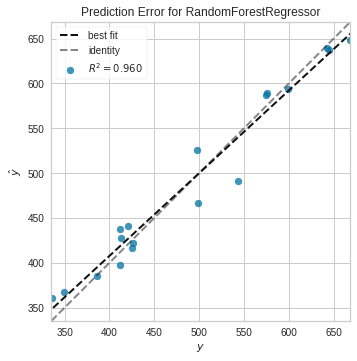

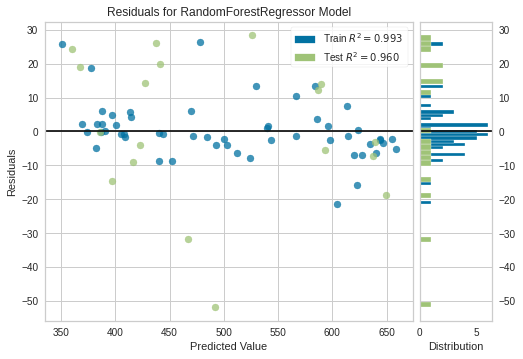

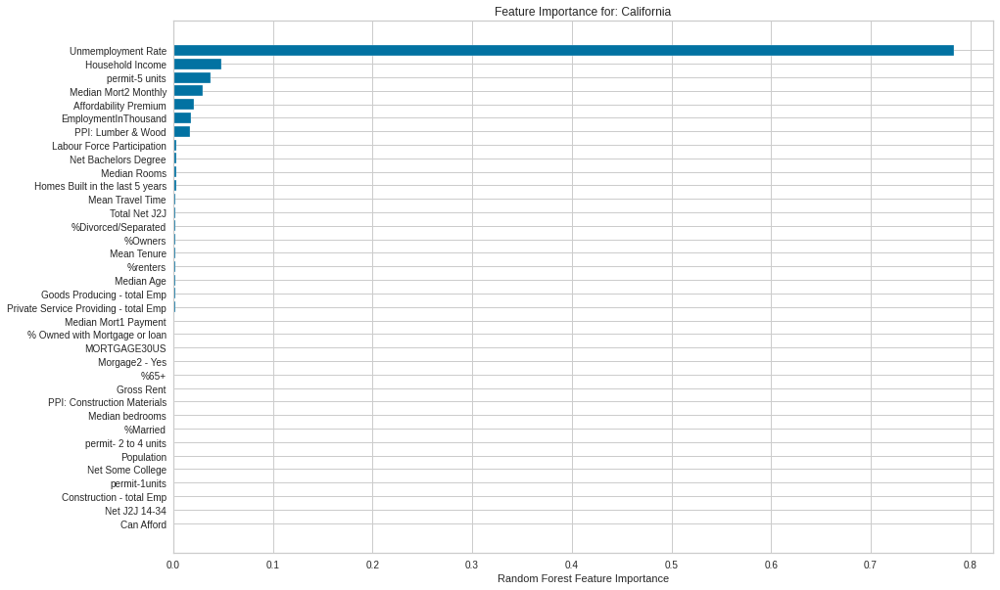

findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.


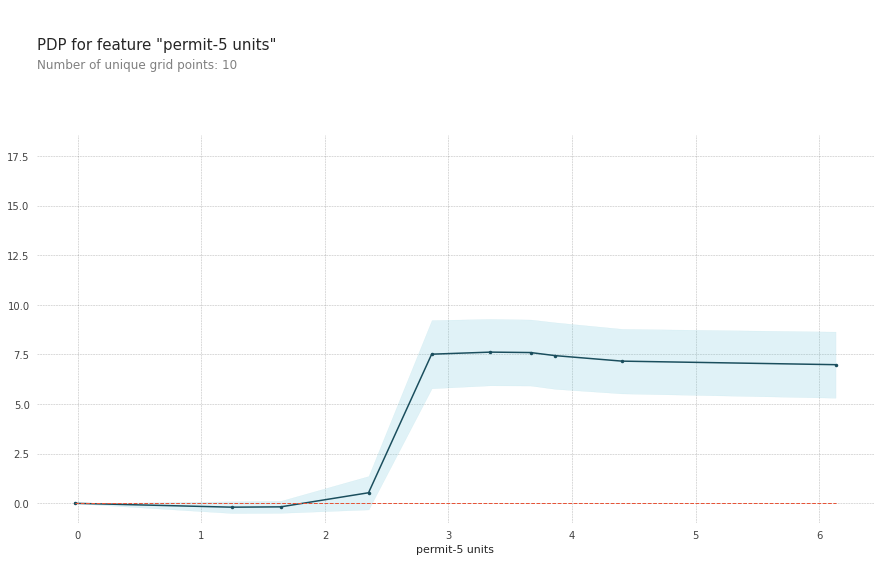

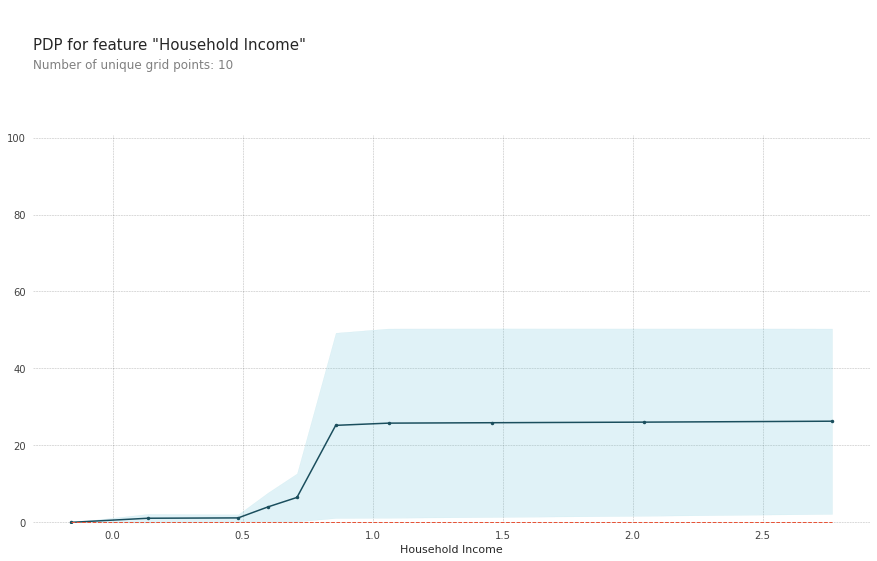

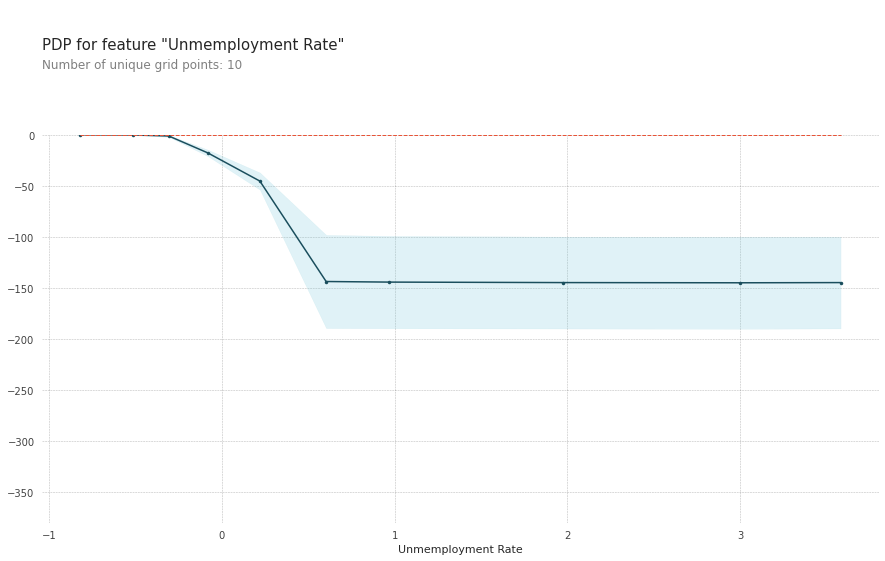

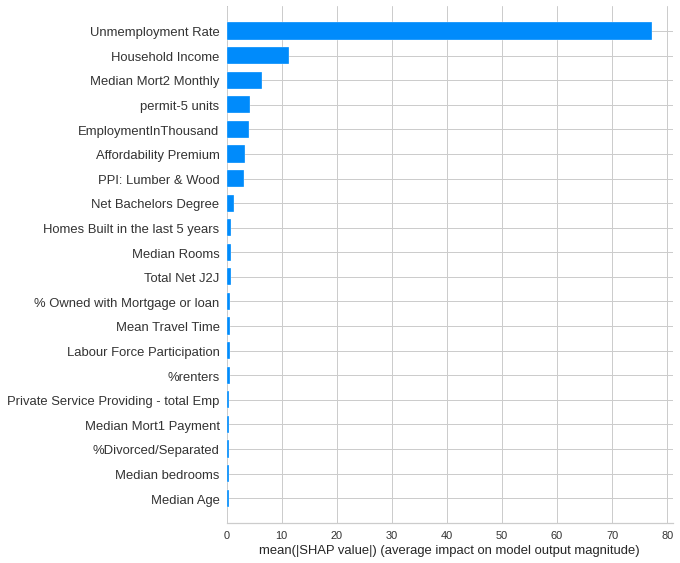

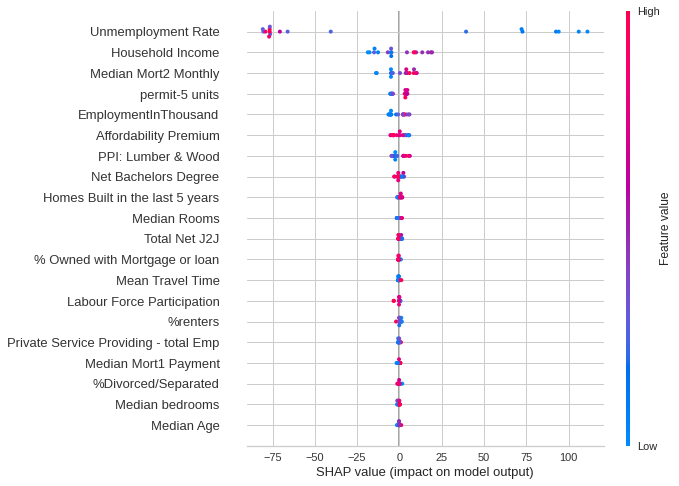

********************************************************************************************************************************************************************************************************
Texas
train score:  0.9991107356969919
test score:  0.9945677704807642
explained variance score:  0.9947993372782084
mean absolute error:  1.9998222222221562
mean square error:  8.711141077777397
root mean square error:  2.9514642260710864
r2 error:  0.9945677704807641


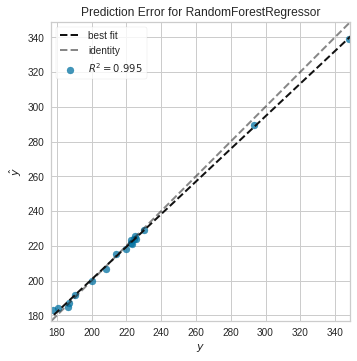

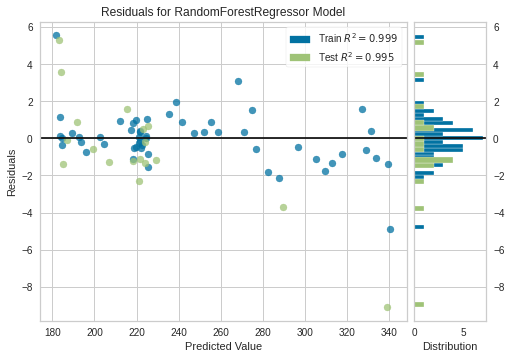

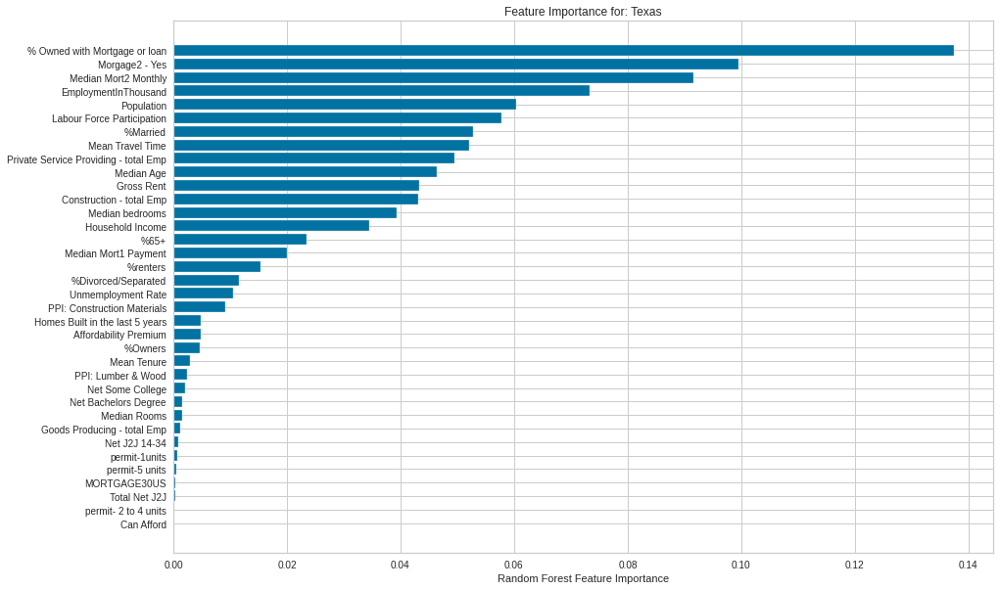

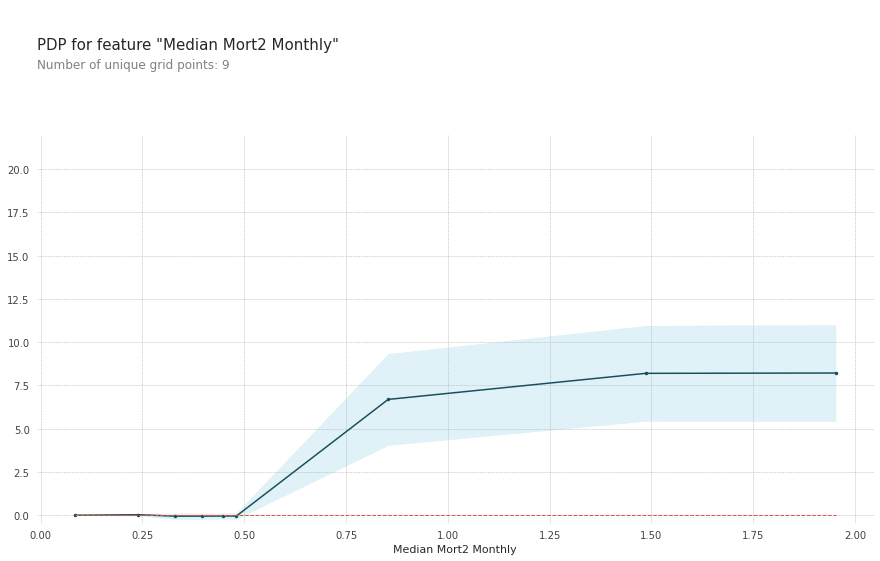

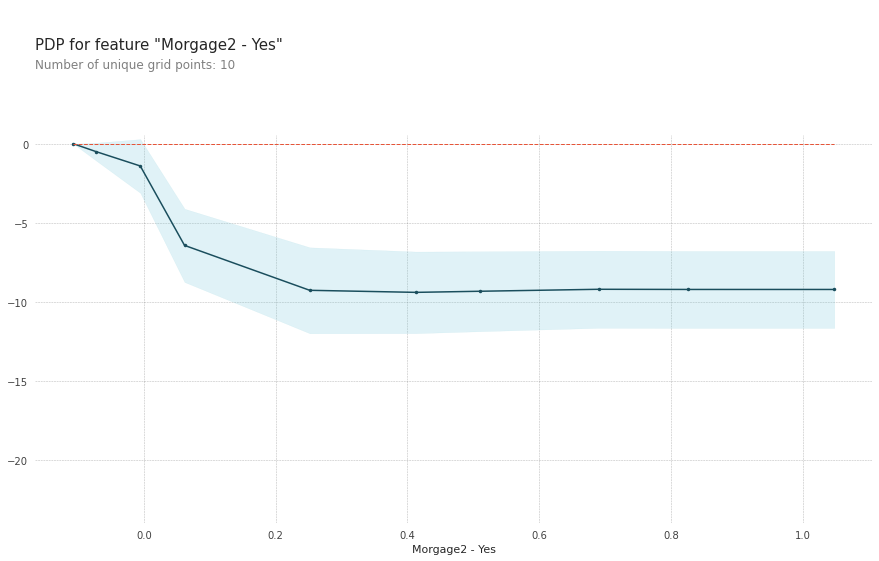

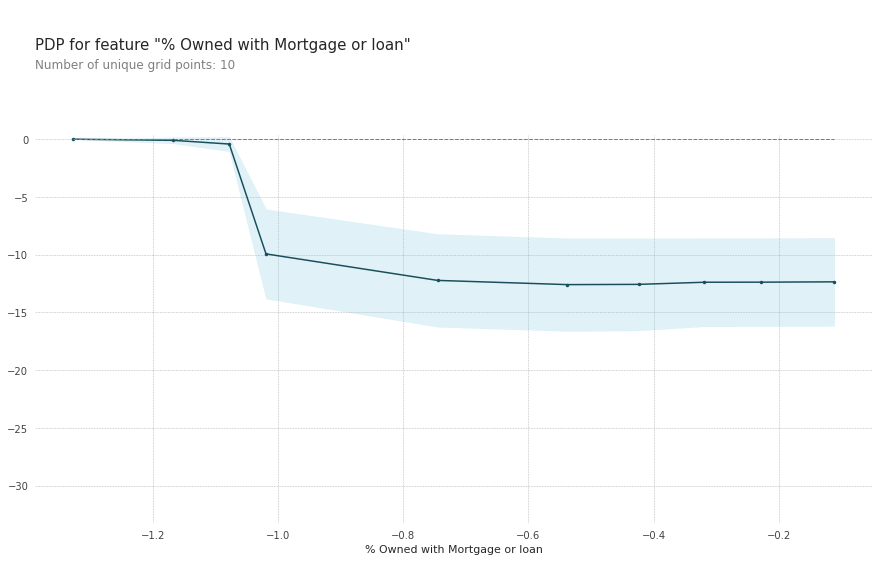

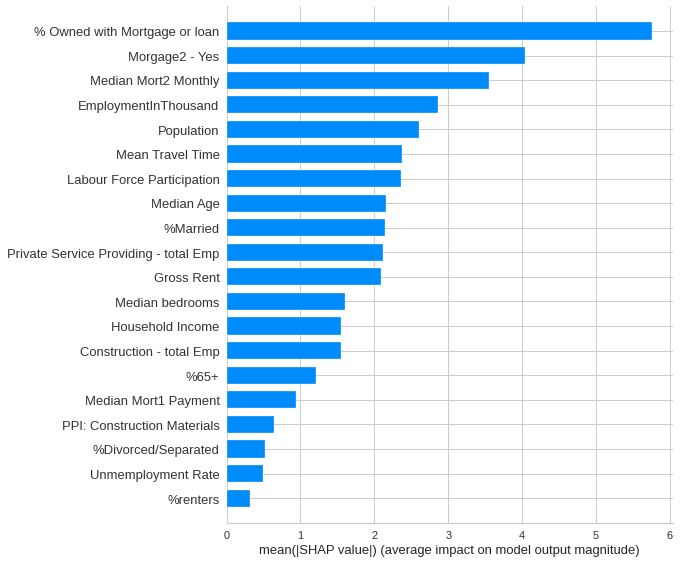

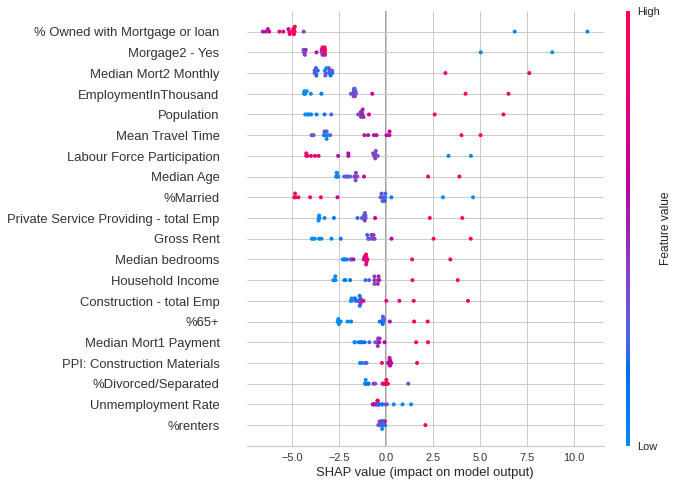

********************************************************************************************************************************************************************************************************
Florida
train score:  0.9946604021782296
test score:  0.9577296338433727
explained variance score:  0.9577703406323508
mean absolute error:  13.439355555555576
mean square error:  259.0376315011125
root mean square error:  16.09464605081803
r2 error:  0.9577296338433726


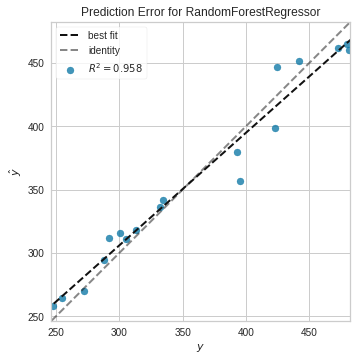

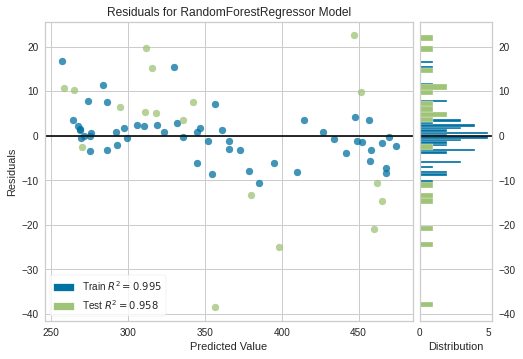

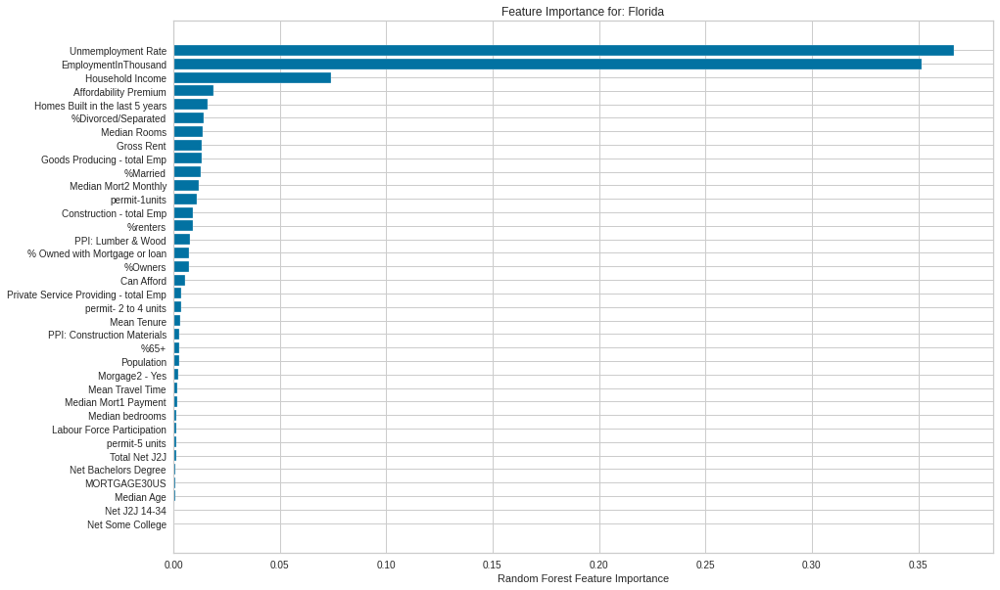

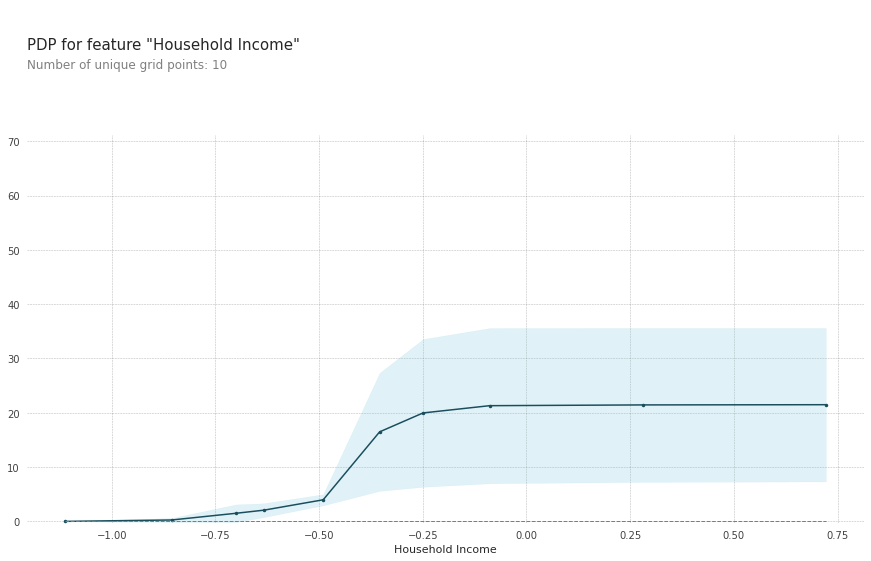

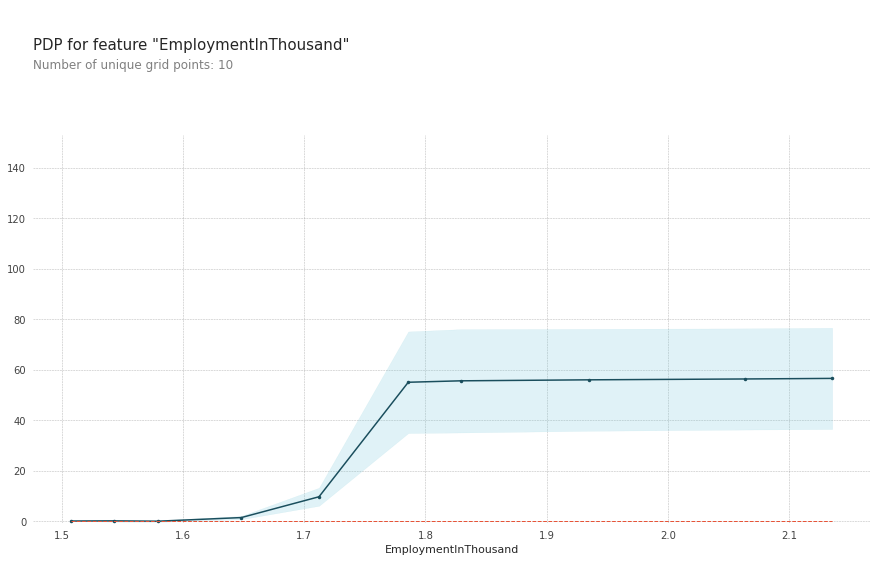

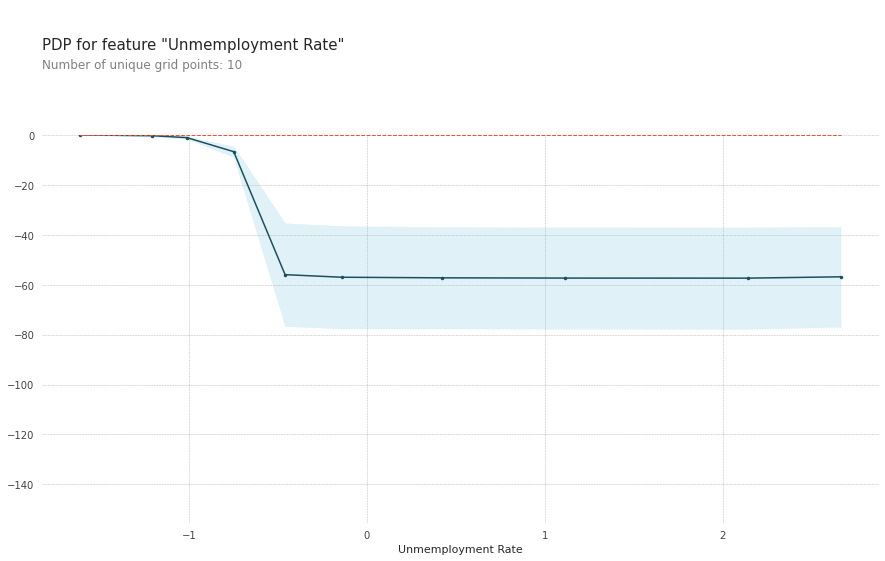

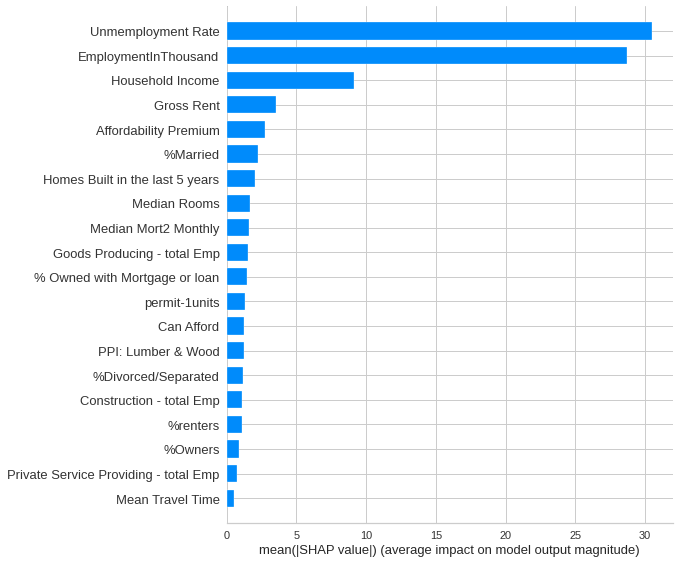

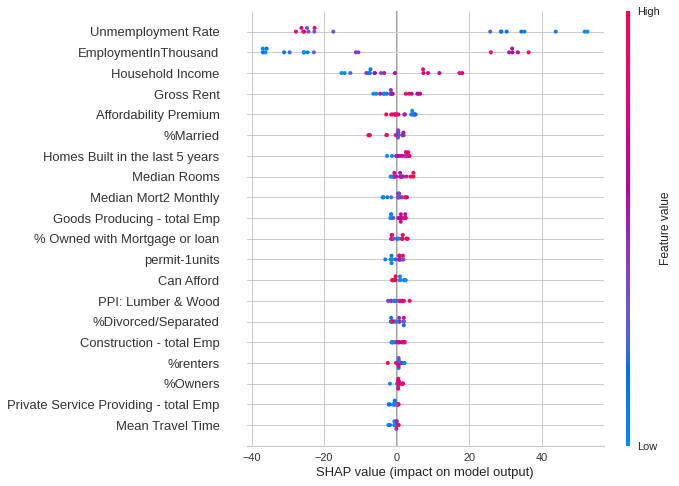

********************************************************************************************************************************************************************************************************
New York
train score:  0.9894592340387313
test score:  0.9551894047009375
explained variance score:  0.9559337512784647
mean absolute error:  11.06816666666679
mean square error:  254.1736591577788
root mean square error:  15.942824691935202
r2 error:  0.9551894047009377


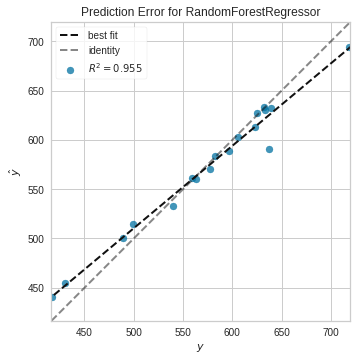

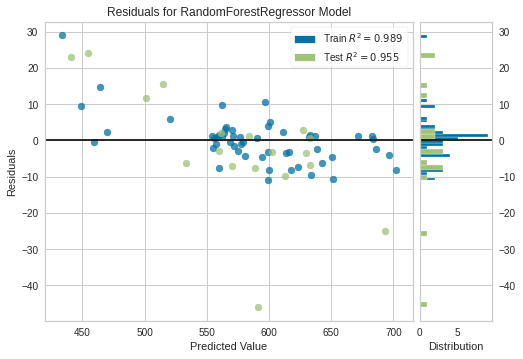

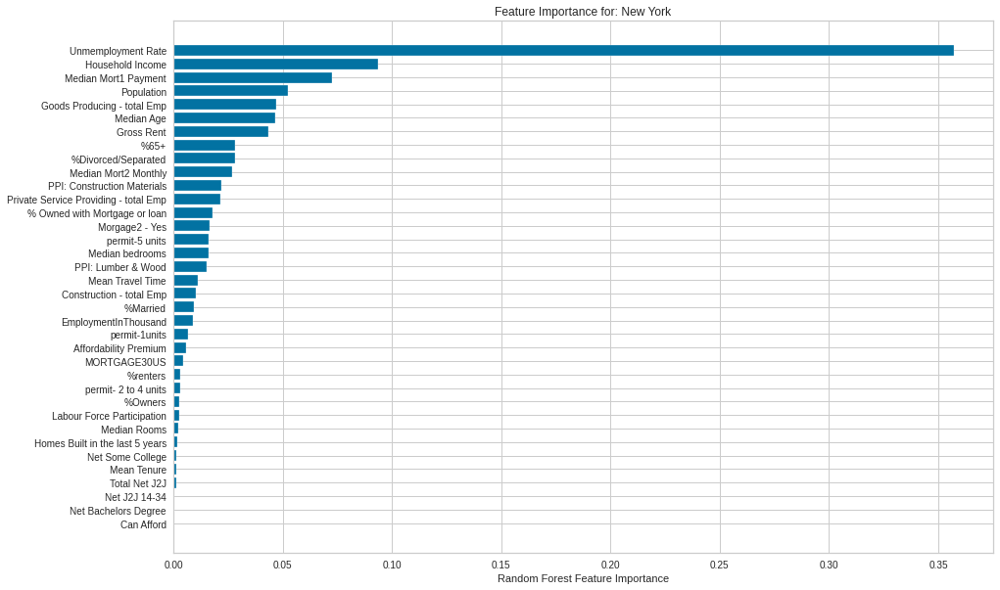

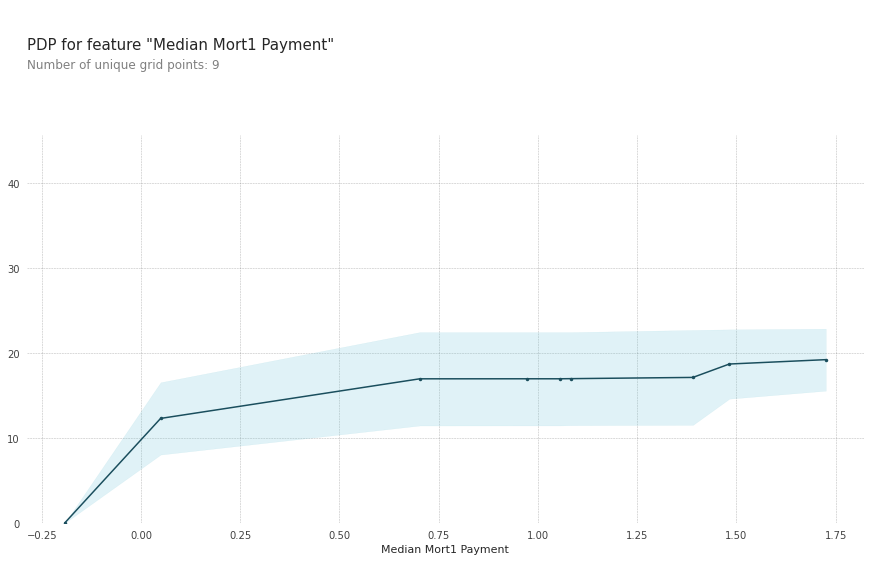

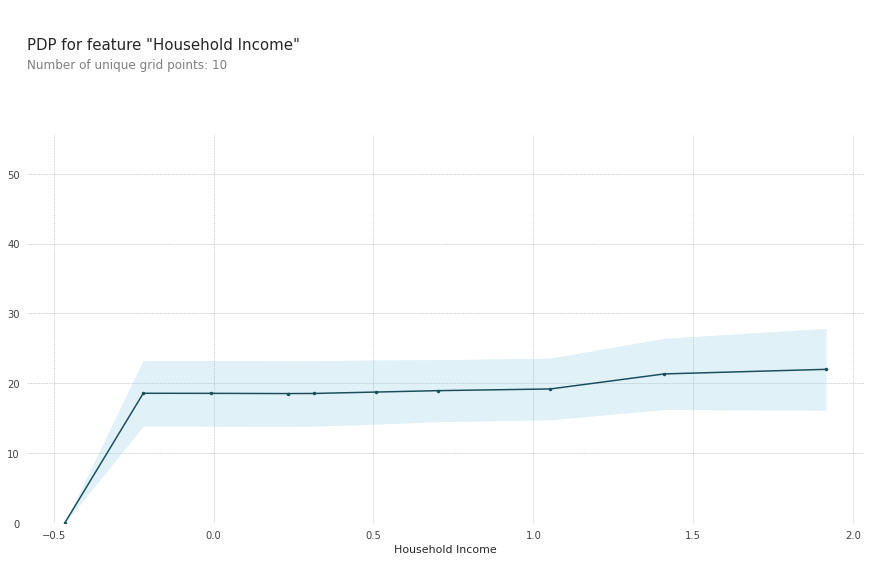

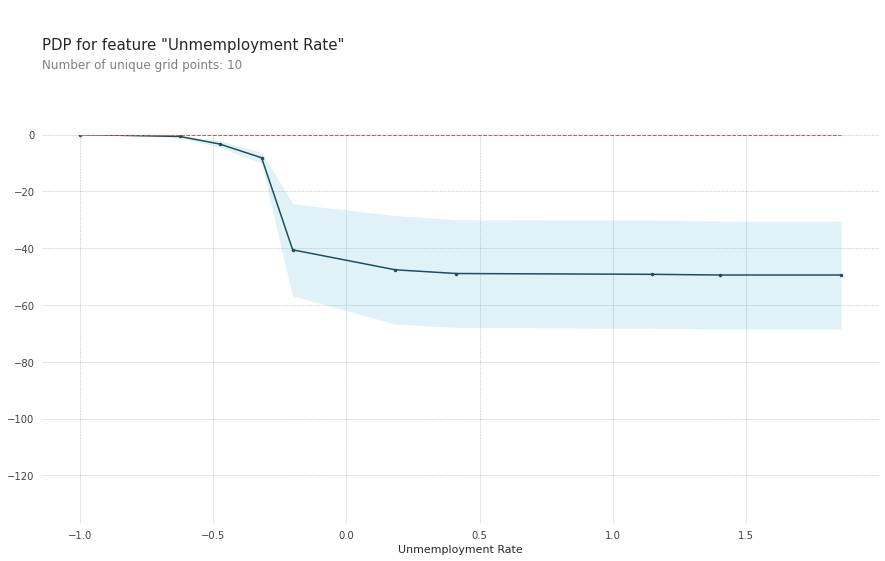

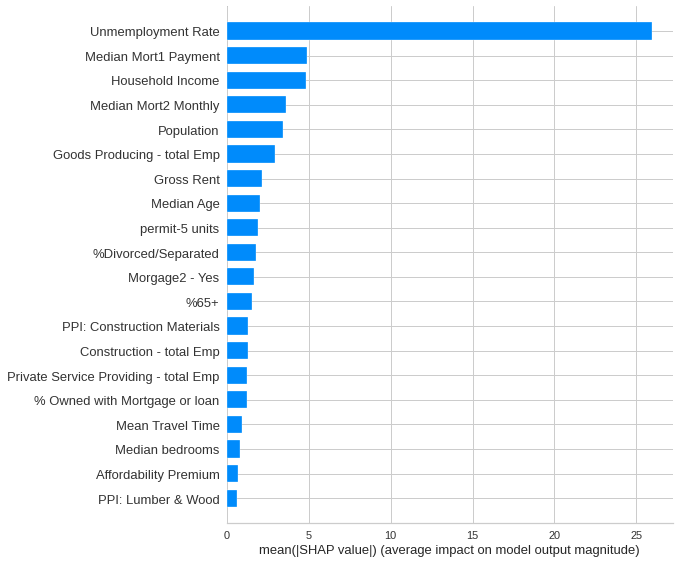

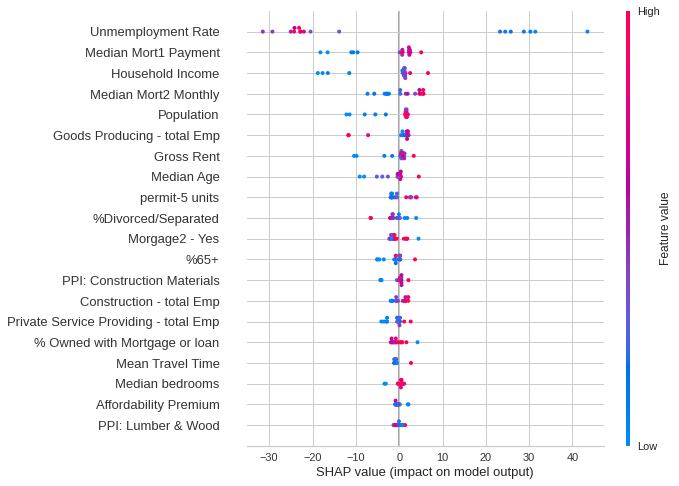

********************************************************************************************************************************************************************************************************
District of Columbia
train score:  0.9923648280811518
test score:  0.9617723671453783
explained variance score:  0.9624719232611397
mean absolute error:  22.486211111111018
mean square error:  804.1595722011093
root mean square error:  28.35770745672346
r2 error:  0.9617723671453783


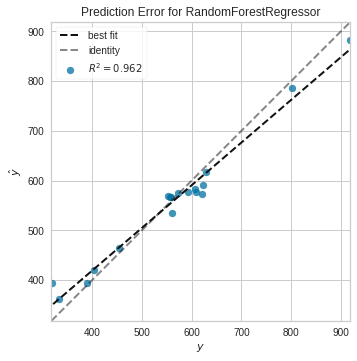

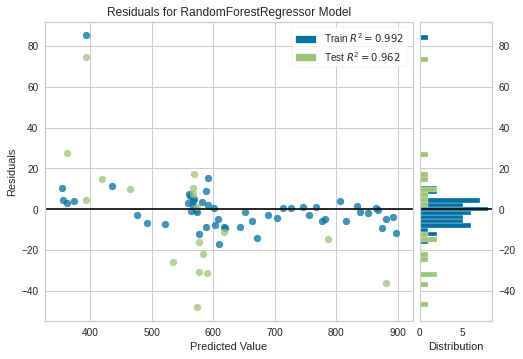

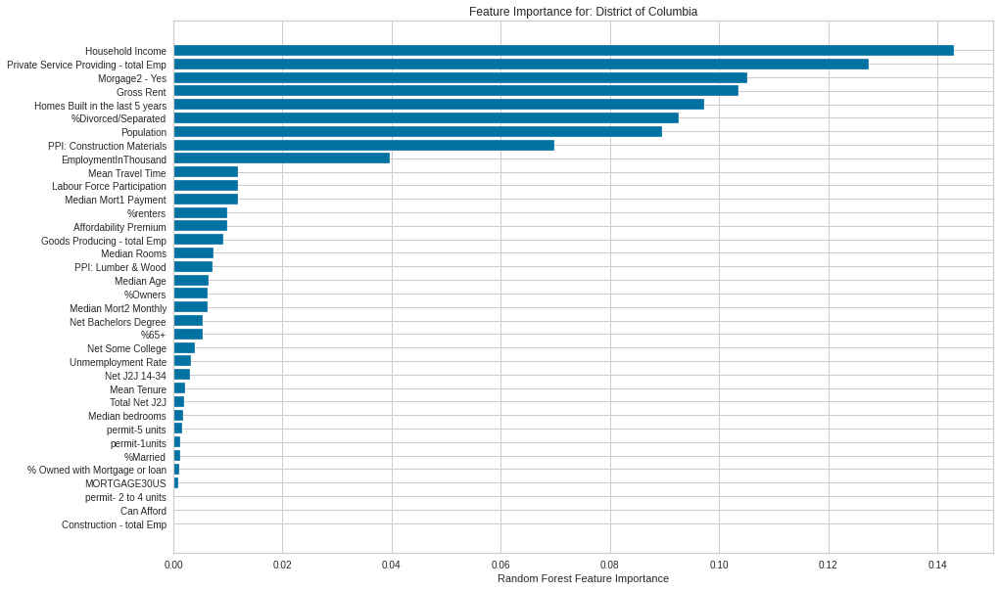

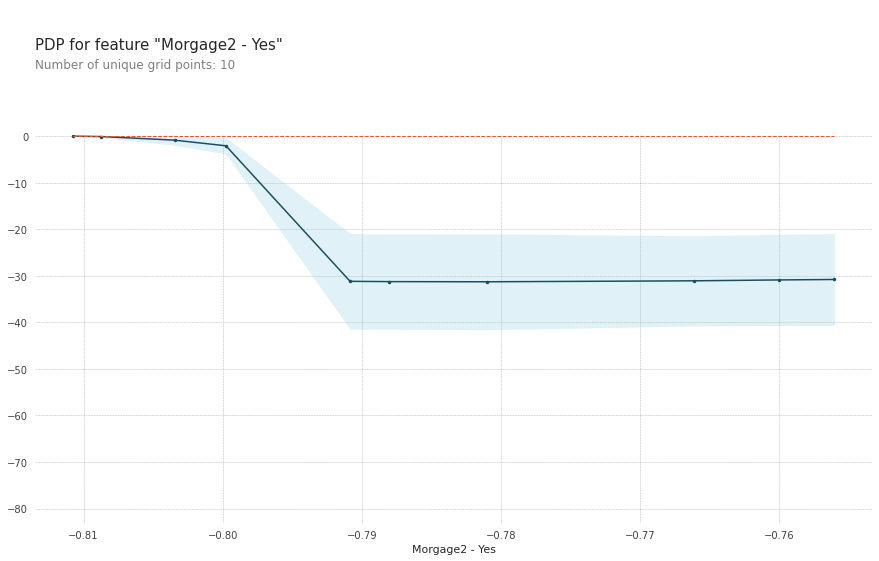

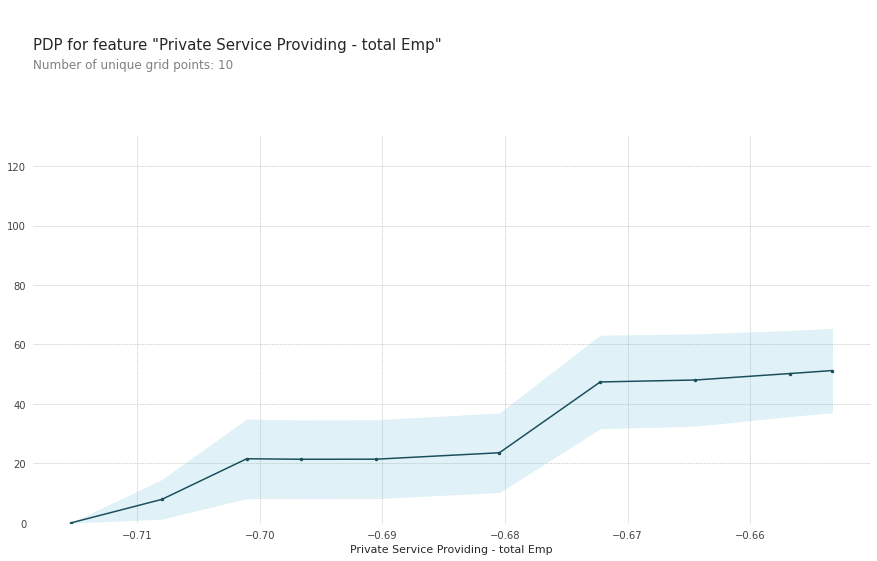

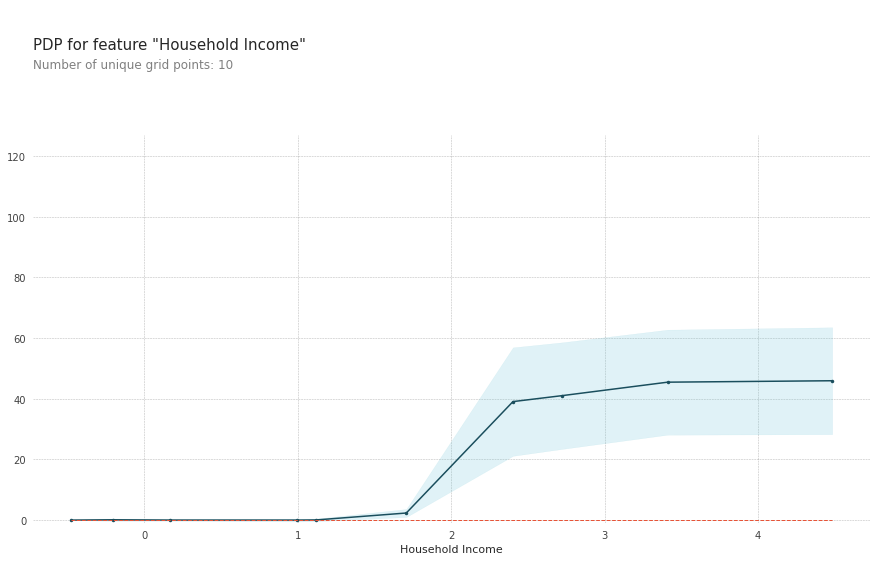

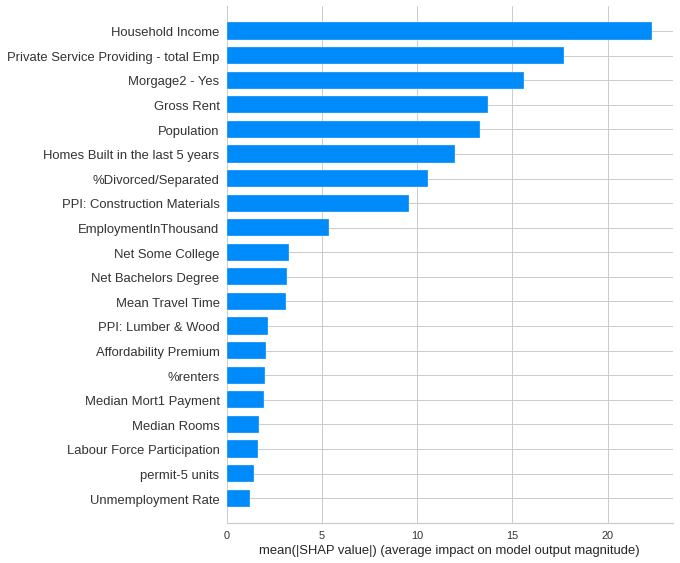

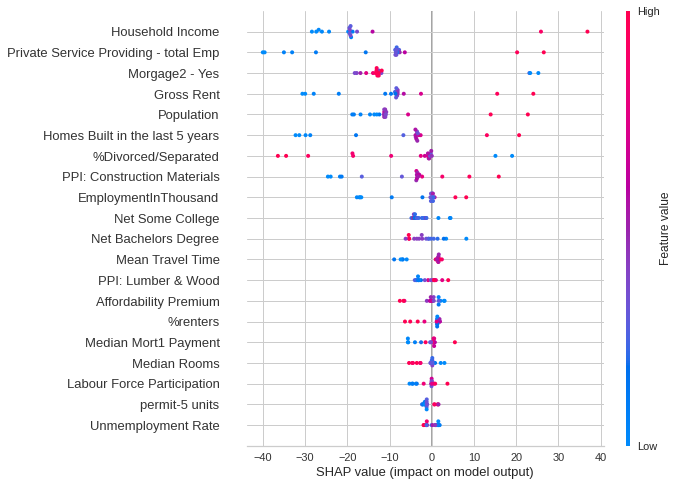

In [112]:
for st in ["California", "Texas", "Florida", "New York", "District of Columbia"]:
  OutputModel(str(st)).predict(df3)

In [113]:
state2=df3[df3.Name2=="Texas"]
      # train test split, nomalization and reshape the data
X = state2.drop('HPI', axis=1)
y = state2['HPI']
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state = 21, test_size = 0.25)
# Ensemble method - collection of many decision trees
x_train = X_train.drop(columns=["Name2", "State Name", "Date"])
x_test = X_test.drop(columns=['Name2',"State Name", "Date"])
X_train.reset_index(inplace=True)
rfr = RandomForestRegressor(n_estimators=100, n_jobs=-1, random_state=42)
rfr.fit(x_train, y_train)

RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                      max_depth=None, max_features='auto', max_leaf_nodes=None,
                      max_samples=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      n_estimators=100, n_jobs=-1, oob_score=False,
                      random_state=42, verbose=0, warm_start=False)

In [114]:
def shap_plot(mdl, x_test , j):
    explainerModel = shap.TreeExplainer(mdl)
    shap_values_Model = explainerModel.shap_values(x_test)
    p = shap.force_plot(explainerModel.expected_value, shap_values_Model[j], x_test.iloc[j])
    display(p)
    # q = shap.plots.force(explainerModel.expected_value, shap_values_Model, feature_names=x_train.columns)
    # display(q)

In [115]:
shap.initjs()
for i in range(0, 5):
  shap_plot(rfr, x_test, i)

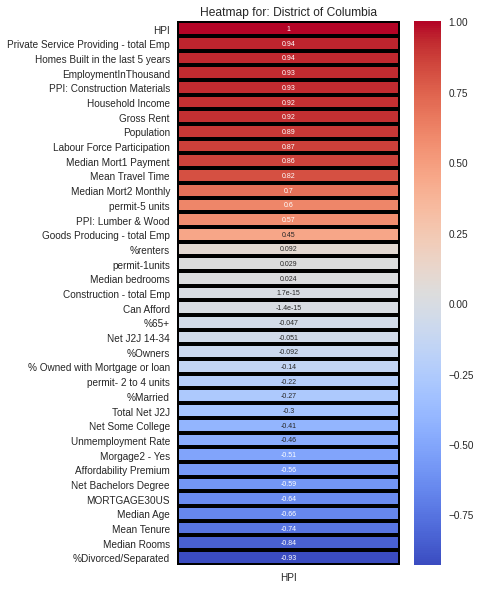

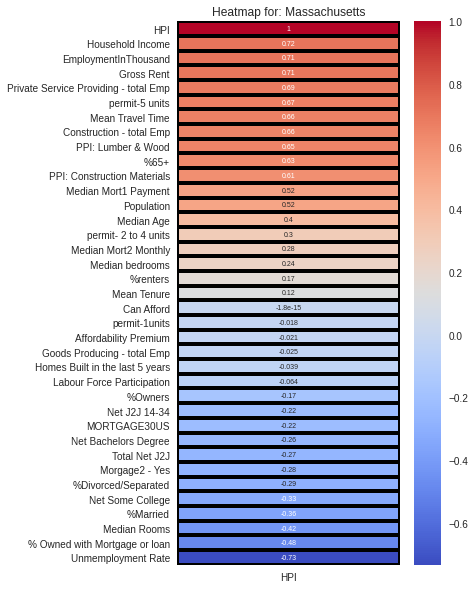

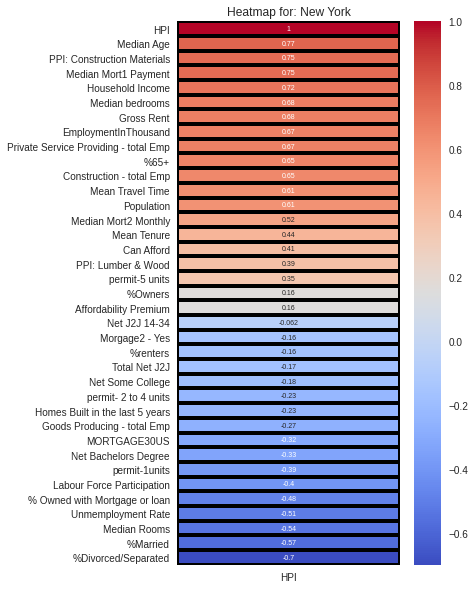

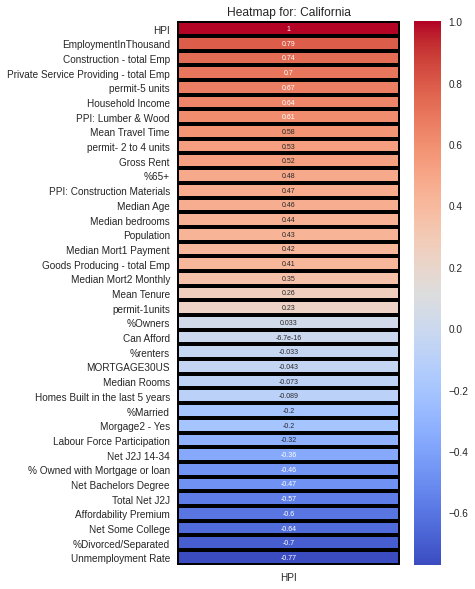

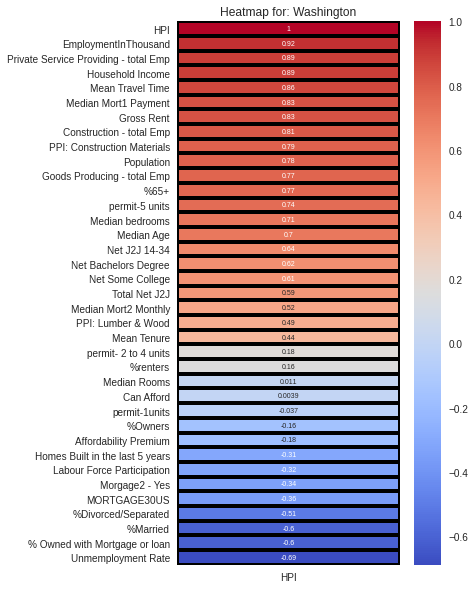

...

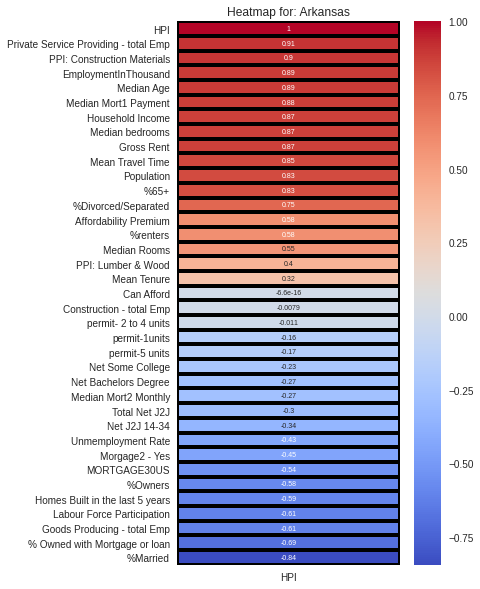

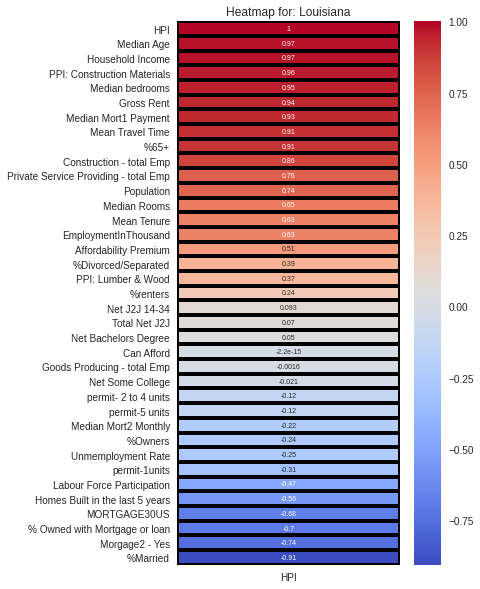

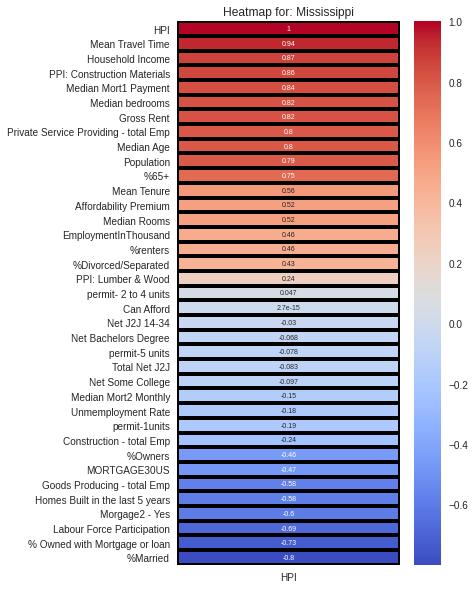

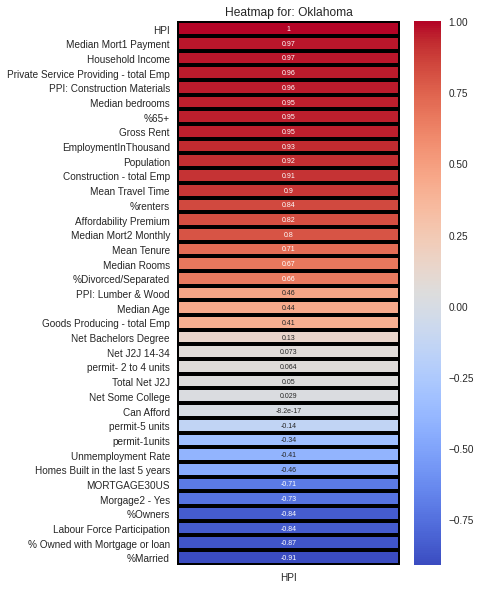

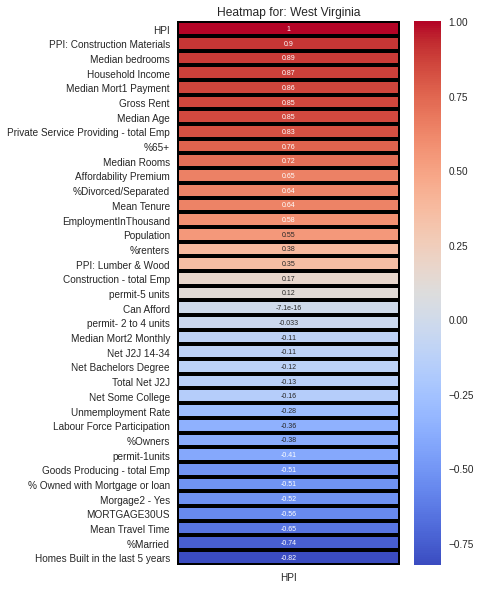

In [116]:
for i in range(len(state_name)): 
     # obtian one state's data 
    state2=df3[df3.Name2==state_name[i]]
    #heatmap
    fig, ax = plt.subplots(figsize=(5,10))
    sns.heatmap(state2.corr().loc[:,['HPI']].sort_values(by='HPI', ascending=False), ax = ax, annot=True, annot_kws={"size": 7},cmap='coolwarm', linewidths=3, linecolor='black')
    plt.title('Heatmap for: '+state_name[i])

In [117]:
def Avg_feature_importance(df, name):
  print("***" *60)
  print("0. Heatmaps - "+ name)
  state2=df3[df3.Name2==name]
      # train test split, nomalization and reshape the data
  #heatmap
  fig, ax = plt.subplots(figsize=(5,10))
  sns.heatmap(state2.corr().loc[:,['HPI']].sort_values(by='HPI', ascending=False), ax = ax, annot=True, annot_kws={"size": 7})
  plt.title('Heatmap for: '+name)
  plt.show()

  X = state2.drop('HPI', axis=1)
  y = state2['HPI']
  X_train, X_test, y_train, y_test = train_test_split(X, y, random_state = 21, test_size = 0.25)
  # Ensemble method - collection of many decision trees
  x_train = X_train.drop(columns=["Name2", "State Name", "Date"])
  x_test = X_test.drop(columns=['Name2',"State Name", "Date"])
  X_train.reset_index(inplace=True)
  # model1
  print("---" *60)
  print("1 . Errors From model - "+name)
  cbr = CatBoostRegressor(random_state=42)
  train_pool = Pool(x_train, y_train)
  cbr.fit(train_pool, verbose=0)
  f1 = pd.DataFrame(cbr.feature_importances_,x_train.columns, columns=["cbr"])
  print("CBR Accuracy score: ", cbr.score(x_test, y_test))
  # model2
  gbr = GradientBoostingRegressor(random_state=42)
  gbr.fit(x_train, y_train)
  print("GBR Accuracy score: ",gbr.score(x_test, y_test))
  f2 = pd.DataFrame(gbr.feature_importances_,x_train.columns, columns=["gbr"])
  # model3
  rfr = RandomForestRegressor(n_estimators=100, n_jobs=-1, random_state=42)
  rfr.fit(x_train, y_train)
  f3 = pd.DataFrame(rfr.feature_importances_,x_train.columns, columns=['rfr'])
  print("RFR Accuracy score: ",rfr.score(x_test, y_test))
  #model for coefficients
  lr = LinearRegression()
  lr.fit(x_train, y_train)
  print("LR Accuracy Score: ", lr.score(x_test, y_test))
  f4 = pd.DataFrame(lr.coef_, x_train.columns, columns=['linear'])
  # print('Coefficients: \n', lr.coef_)
  print("---" *60)
  print("2 . Shapley Value for Random Forest - "+ name)
  shap_plot(gbr, x_test, -1)
  shap_plot(gbr, x_test, 1)
  shap_plot(gbr, x_test, 3)
  final = f1.merge(f2.merge(f3.merge(f4, left_index=True, right_index=True), left_index=True, right_index=True), left_index=True, right_index=True)
  final['total'] = (final['cbr']+final['gbr']+final['rfr'] )/3
  final = final.sort_values(by=['total'])
  print("---" *60)
  print("3. Linear Coeff - "+ name)
  plt.figure(figsize=(10, 10))
  temp = final.sort_values(by='linear')
  sns.barplot(y = temp.index, x=temp['linear'])
  plt.show()
  print("---" *60)
  print("4. Feature Importance - "+name)
  plt.figure(figsize=(15, 10))
  plt.barh(final.index, final.total)
  plt.xlabel("Random Forest Feature Importance")
  plt.title('Feature Importance for: '+ name)
  plt.show()
  

************************************************************************************************************************************************************************************
0. Heatmaps - District of Columbia


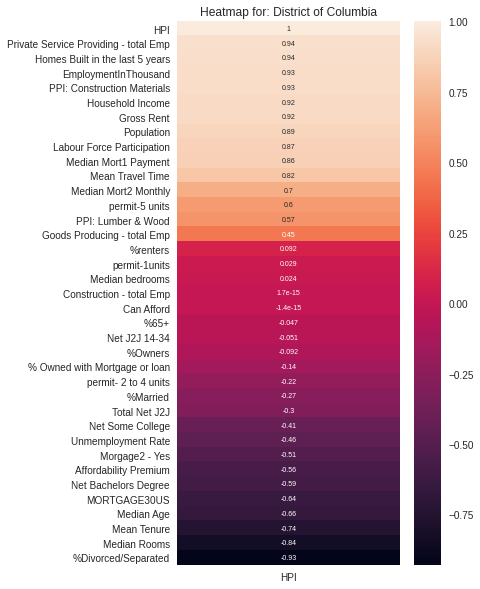

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1 . Errors From model - District of Columbia
CBR Accuracy score:  0.9783503027003468
GBR Accuracy score:  0.9789035242086619
RFR Accuracy score:  0.9734138183547785
LR Accuracy Score:  0.9979312988776694
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
2 . Shapley Value for Random Forest - District of Columbia


------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
3. Linear Coeff - District of Columbia


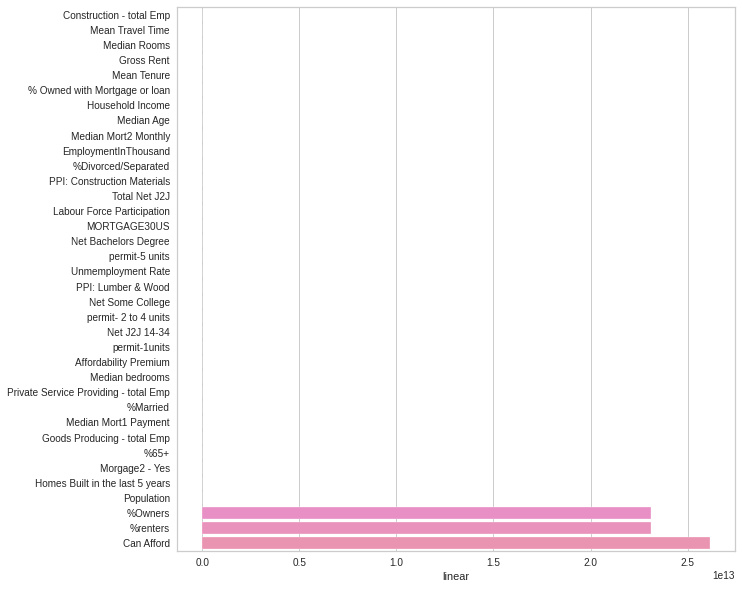

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
4. Feature Importance - District of Columbia


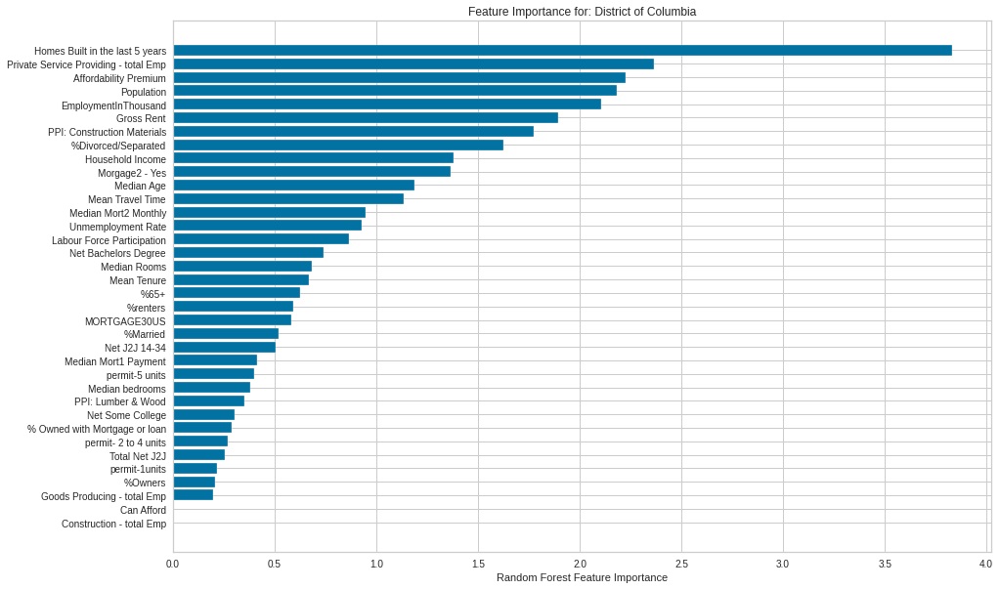

************************************************************************************************************************************************************************************
0. Heatmaps - Massachusetts


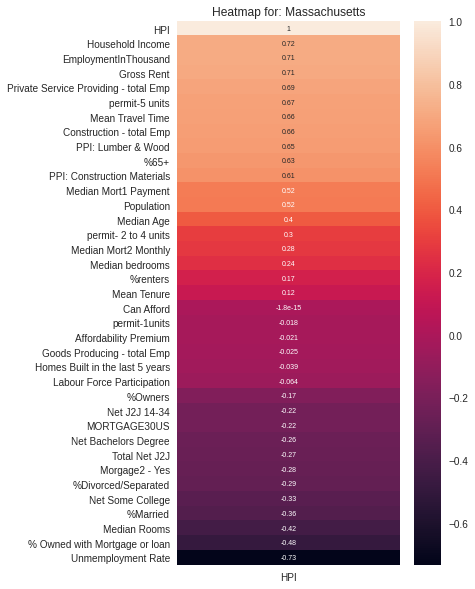

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1 . Errors From model - Massachusetts
CBR Accuracy score:  0.9322183286905249
GBR Accuracy score:  0.9481347184005169
RFR Accuracy score:  0.8020853426233945
LR Accuracy Score:  0.9914997940334759
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
2 . Shapley Value for Random Forest - Massachusetts


------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
3. Linear Coeff - Massachusetts


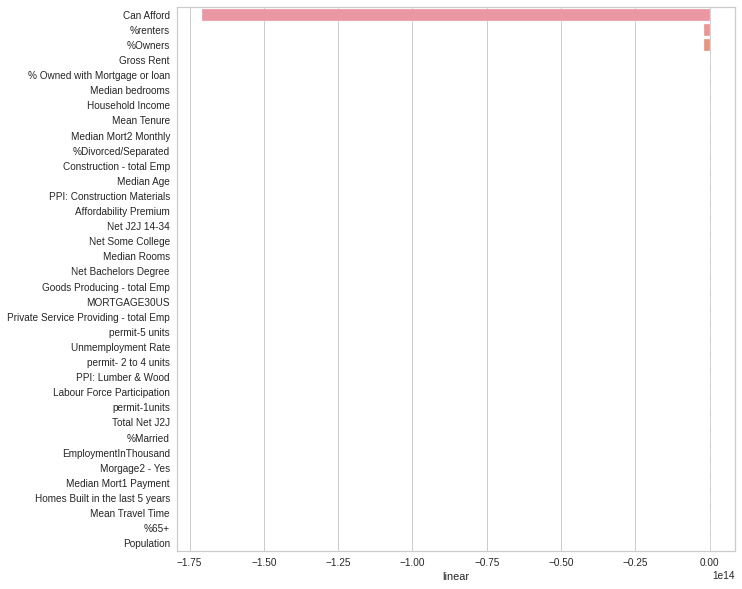

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
4. Feature Importance - Massachusetts


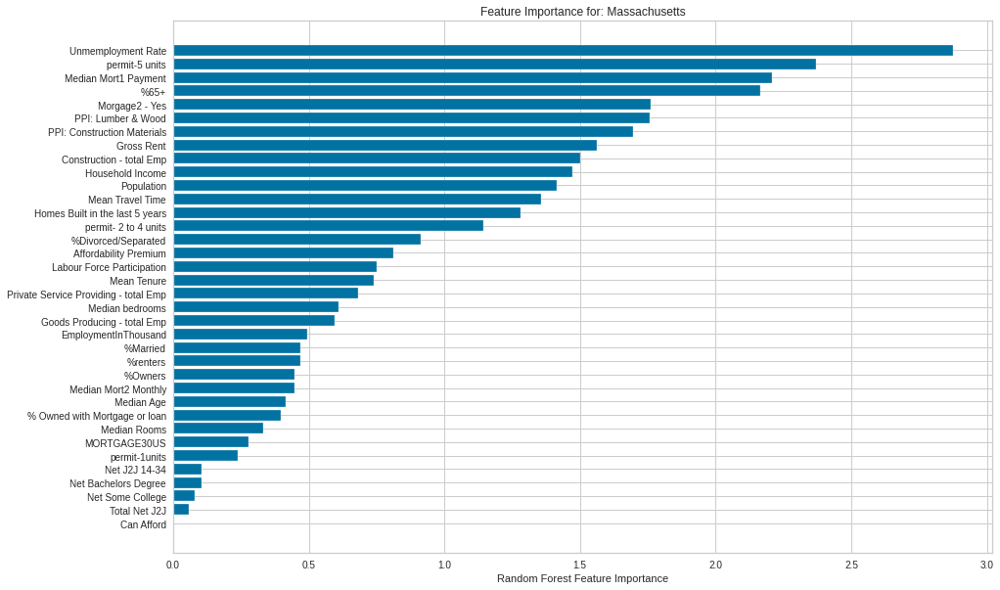

************************************************************************************************************************************************************************************
0. Heatmaps - New York


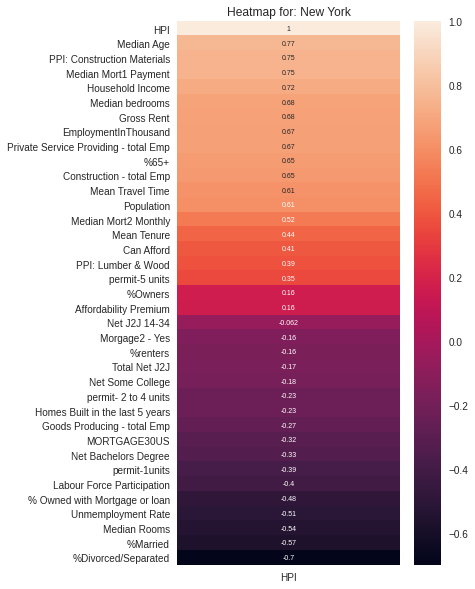

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1 . Errors From model - New York
CBR Accuracy score:  0.9677552853340772
GBR Accuracy score:  0.9736315265006462
RFR Accuracy score:  0.957910825492304
LR Accuracy Score:  0.9926469708727843
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
2 . Shapley Value for Random Forest - New York


------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
3. Linear Coeff - New York


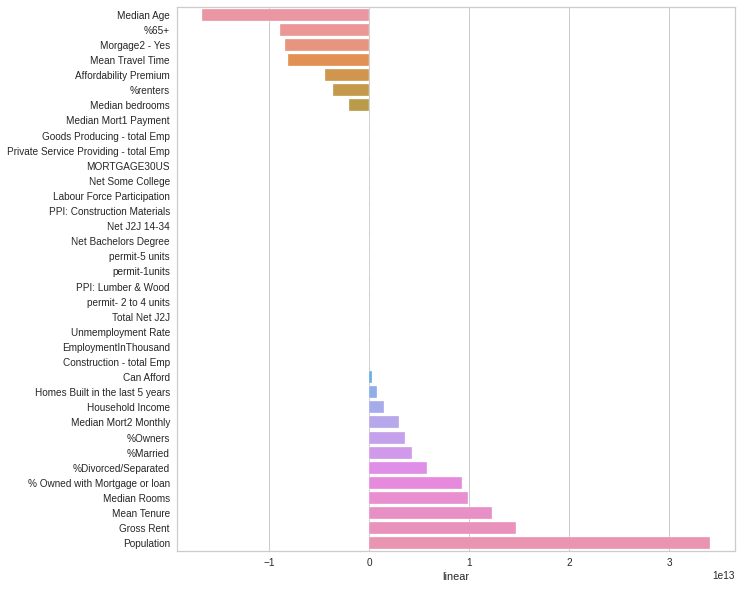

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
4. Feature Importance - New York


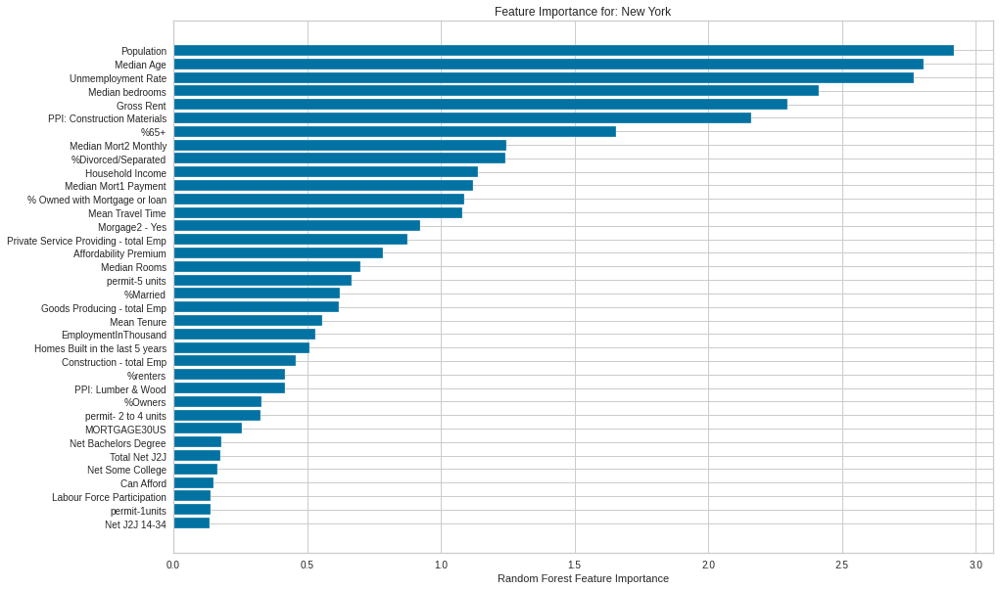

************************************************************************************************************************************************************************************
0. Heatmaps - California


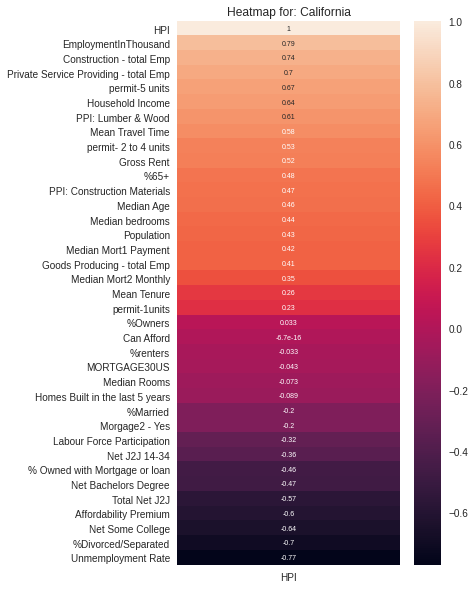

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1 . Errors From model - California
CBR Accuracy score:  0.975194383378422
GBR Accuracy score:  0.9574194878115108
RFR Accuracy score:  0.9663011983083494
LR Accuracy Score:  0.9882482686645677
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
2 . Shapley Value for Random Forest - California


------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
3. Linear Coeff - California


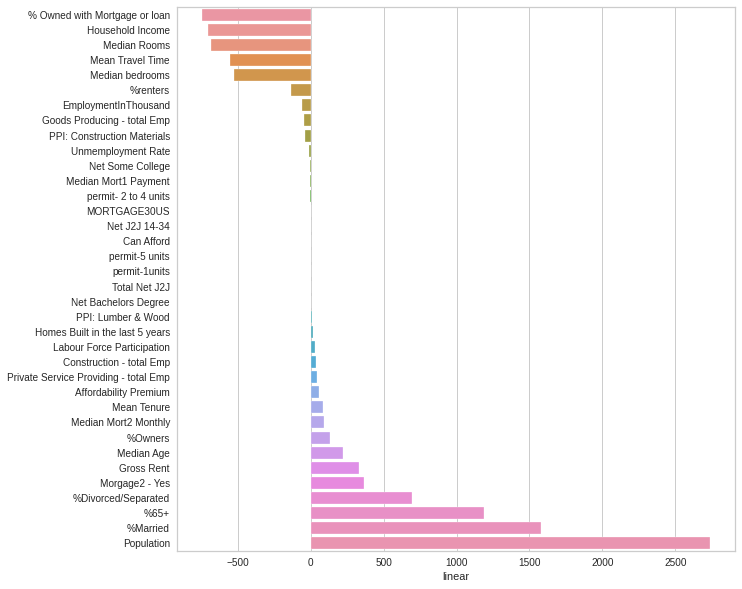

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
4. Feature Importance - California


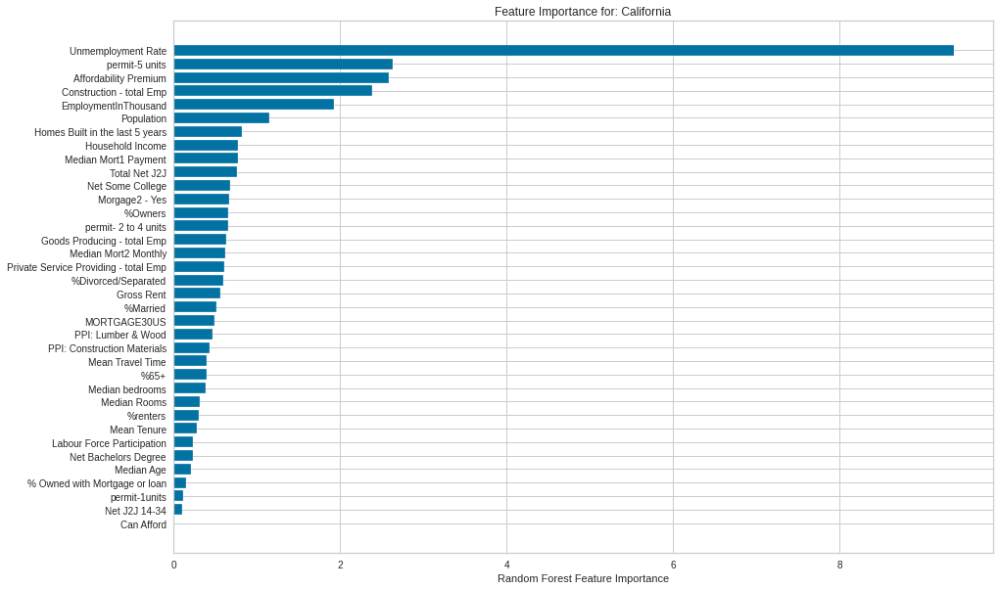

************************************************************************************************************************************************************************************
0. Heatmaps - Washington


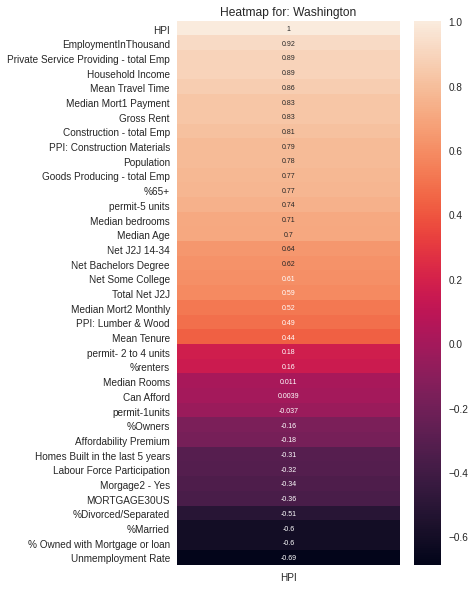

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1 . Errors From model - Washington
CBR Accuracy score:  0.9778499603614976
GBR Accuracy score:  0.9868571338827553
RFR Accuracy score:  0.9665084625133565
LR Accuracy Score:  0.9914711767790865
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
2 . Shapley Value for Random Forest - Washington


------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
3. Linear Coeff - Washington


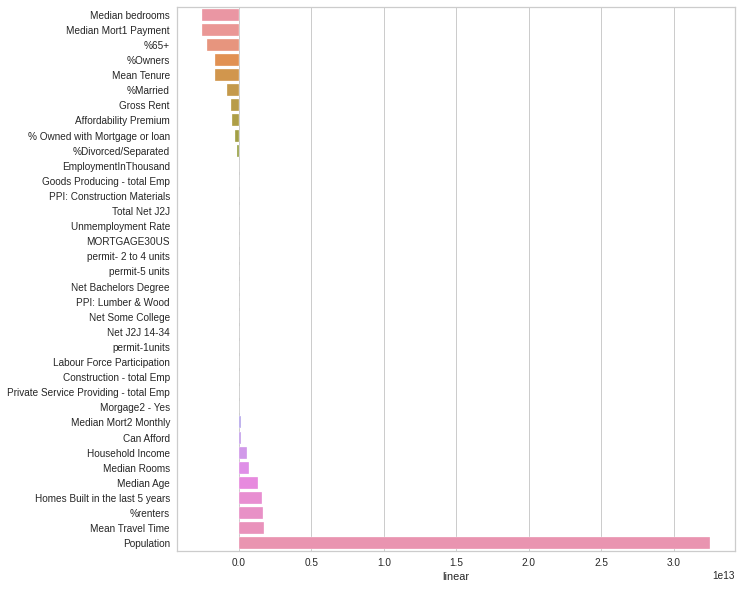

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
4. Feature Importance - Washington


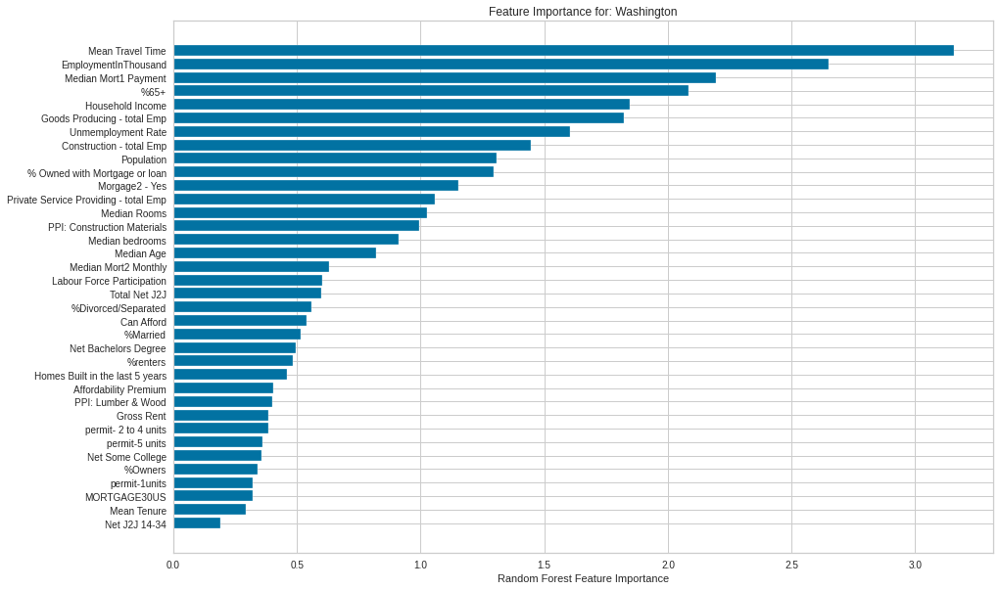

************************************************************************************************************************************************************************************
0. Heatmaps - Hawaii


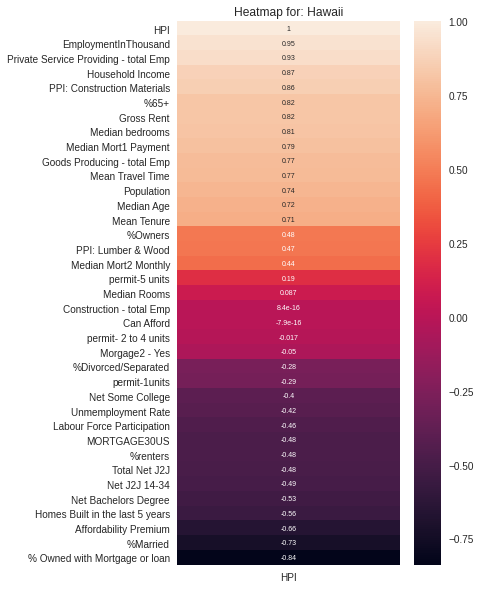

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1 . Errors From model - Hawaii
CBR Accuracy score:  0.9908750401010609
GBR Accuracy score:  0.9901931480658758
RFR Accuracy score:  0.989149950860376
LR Accuracy Score:  0.995834102088458
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
2 . Shapley Value for Random Forest - Hawaii


------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
3. Linear Coeff - Hawaii


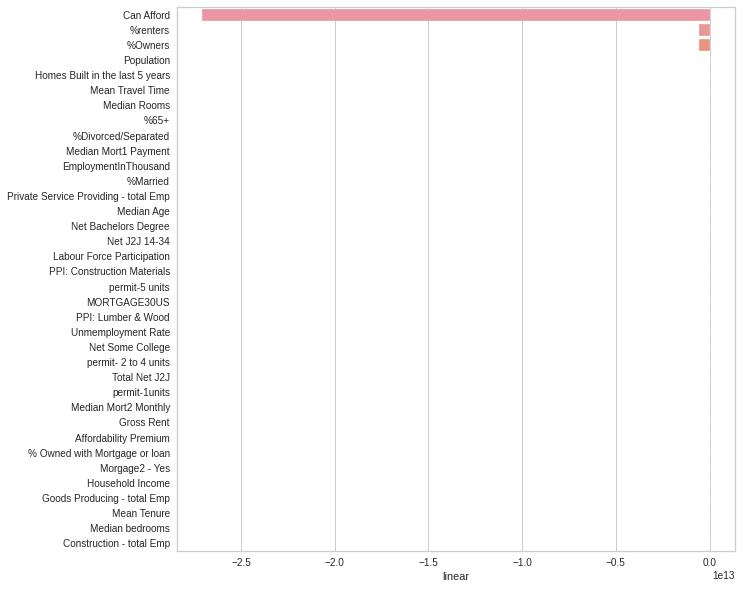

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
4. Feature Importance - Hawaii


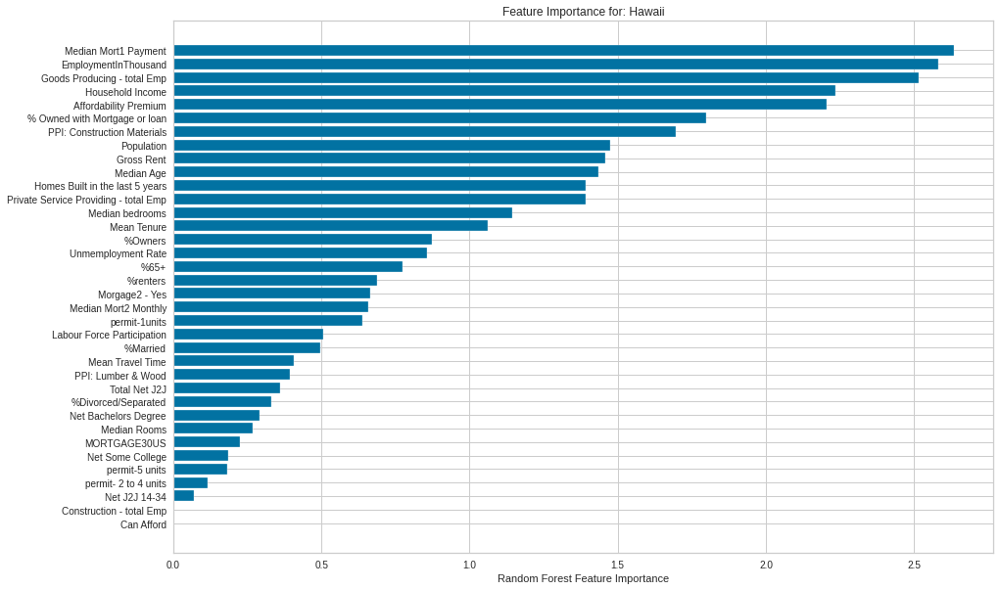

************************************************************************************************************************************************************************************
0. Heatmaps - Oregon


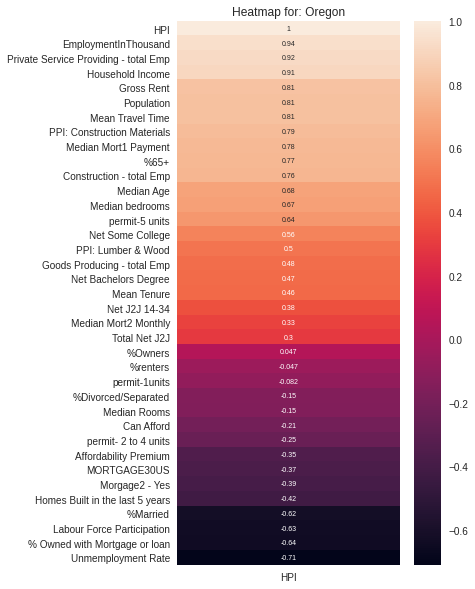

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1 . Errors From model - Oregon
CBR Accuracy score:  0.9669401704632852
GBR Accuracy score:  0.9777142798320826
RFR Accuracy score:  0.9743621468418097
LR Accuracy Score:  0.9961028356514057
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
2 . Shapley Value for Random Forest - Oregon


------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
3. Linear Coeff - Oregon


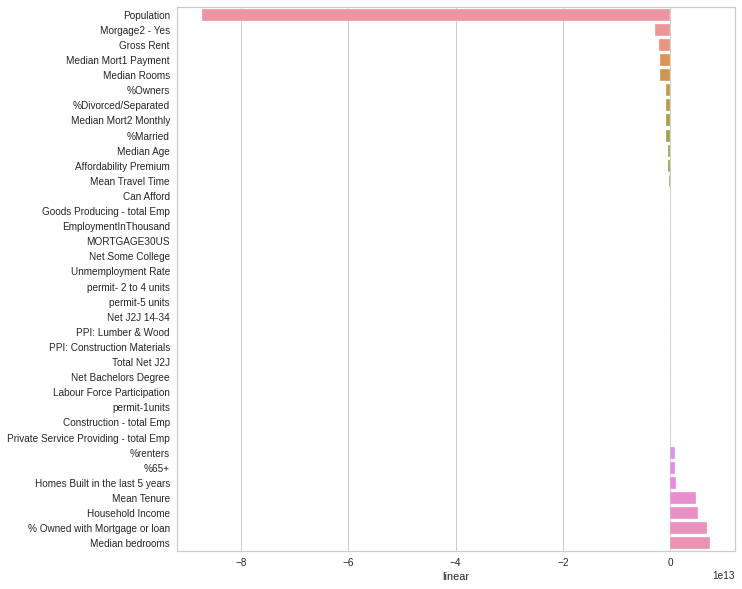

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
4. Feature Importance - Oregon


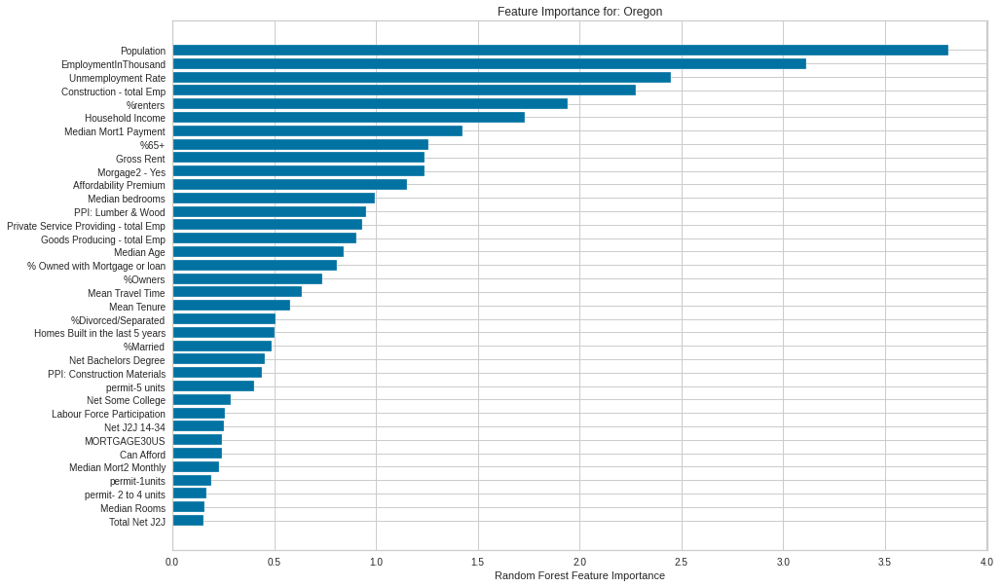

************************************************************************************************************************************************************************************
0. Heatmaps - Colorado


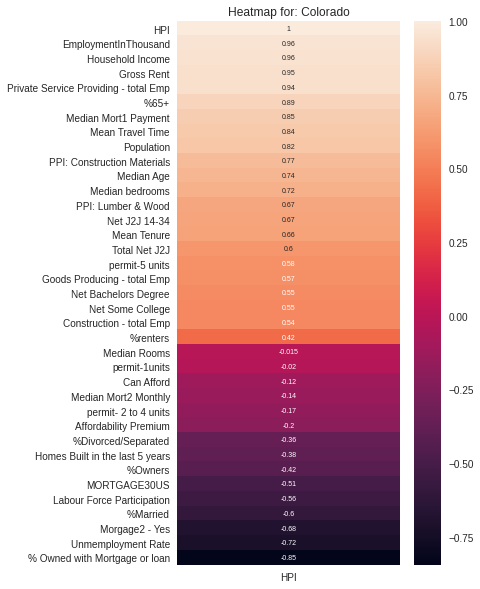

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1 . Errors From model - Colorado
CBR Accuracy score:  0.9824104332030211
GBR Accuracy score:  0.9903050691469429
RFR Accuracy score:  0.9791492955380252
LR Accuracy Score:  0.9961476706945852
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
2 . Shapley Value for Random Forest - Colorado


------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
3. Linear Coeff - Colorado


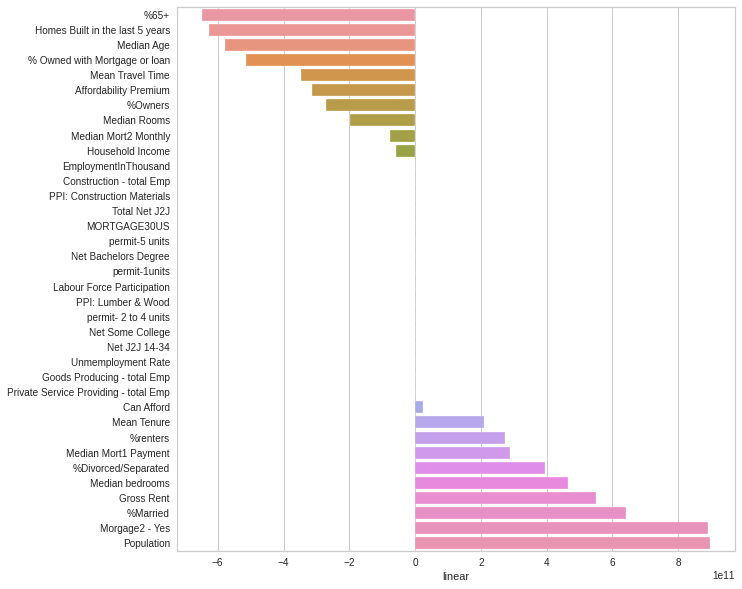

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
4. Feature Importance - Colorado


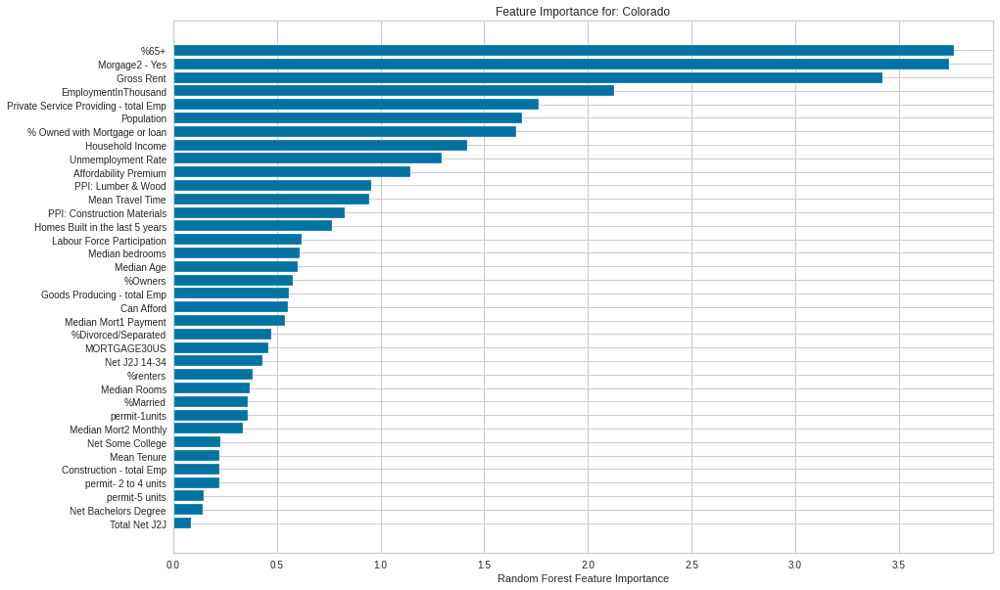

************************************************************************************************************************************************************************************
0. Heatmaps - Maine


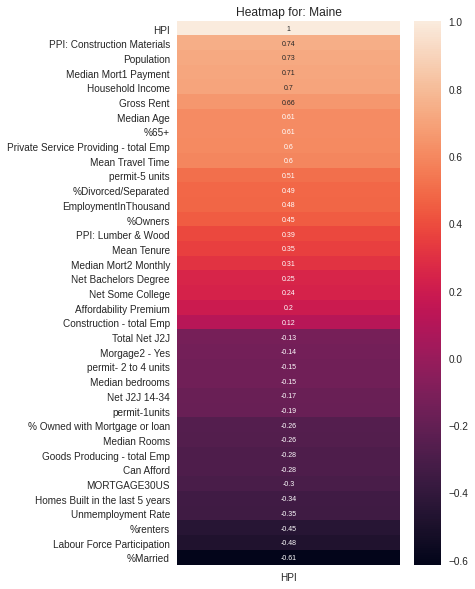

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1 . Errors From model - Maine
CBR Accuracy score:  0.948337342442035
GBR Accuracy score:  0.9473646868989624
RFR Accuracy score:  0.9477907562521636
LR Accuracy Score:  0.9908334569911916
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
2 . Shapley Value for Random Forest - Maine


------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
3. Linear Coeff - Maine


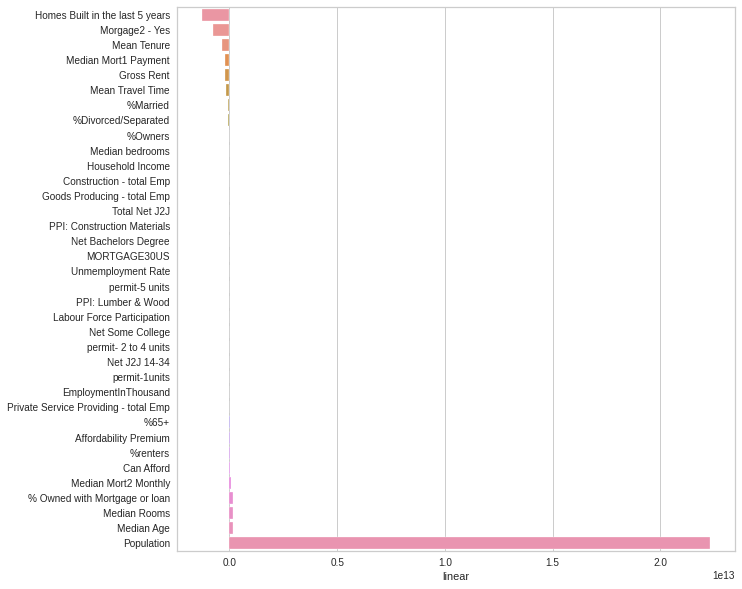

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
4. Feature Importance - Maine


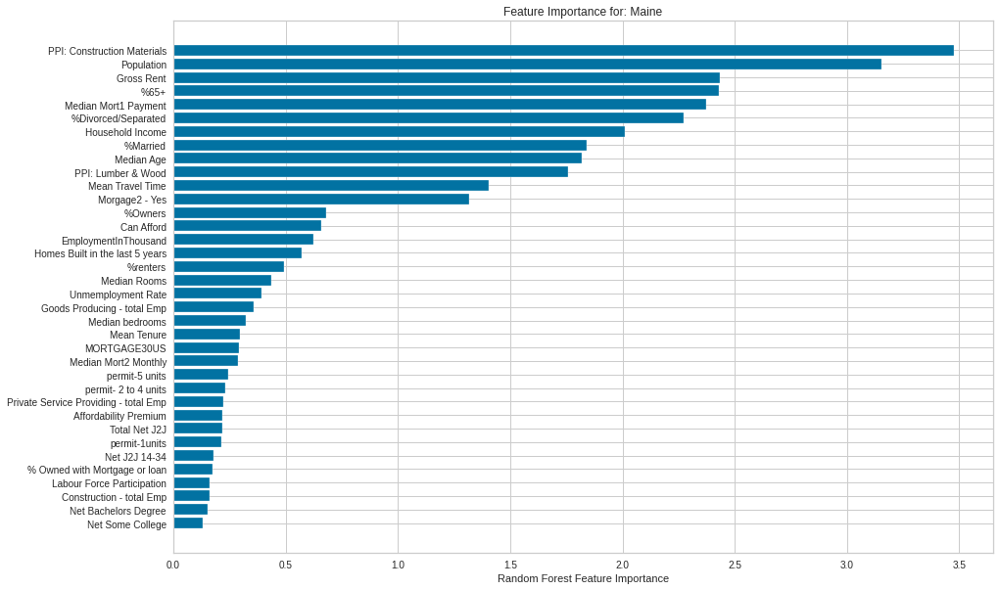

************************************************************************************************************************************************************************************
0. Heatmaps - New Jersey


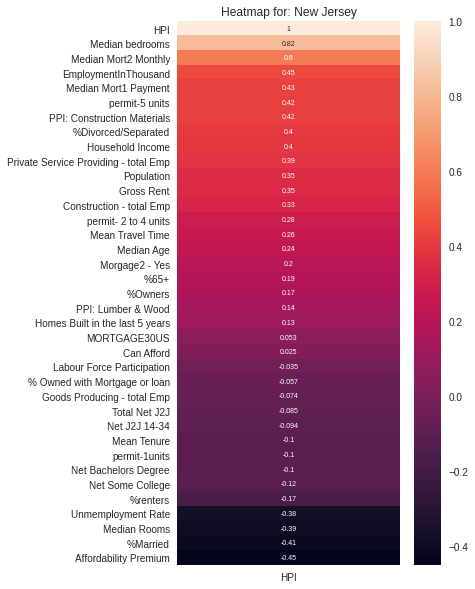

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1 . Errors From model - New Jersey
CBR Accuracy score:  0.9863568321240169
GBR Accuracy score:  0.9850405896229895
RFR Accuracy score:  0.9718739521862793
LR Accuracy Score:  0.9921867133552903
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
2 . Shapley Value for Random Forest - New Jersey


------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
3. Linear Coeff - New Jersey


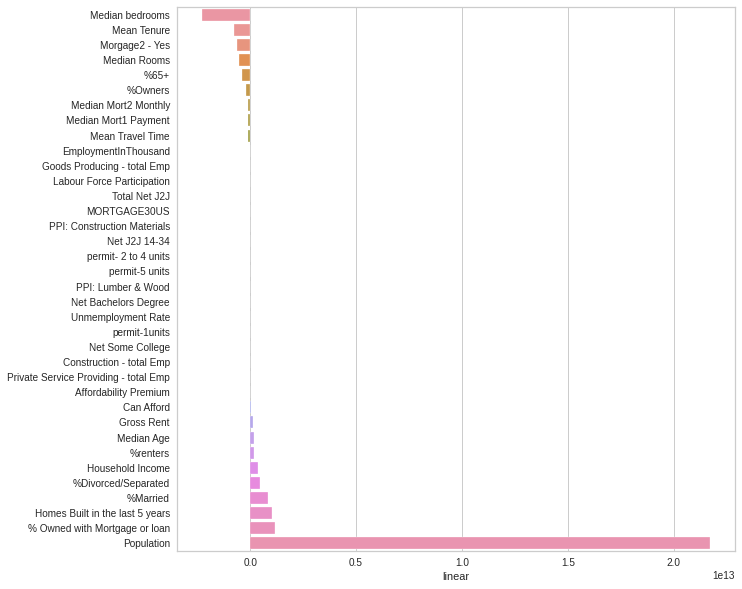

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
4. Feature Importance - New Jersey


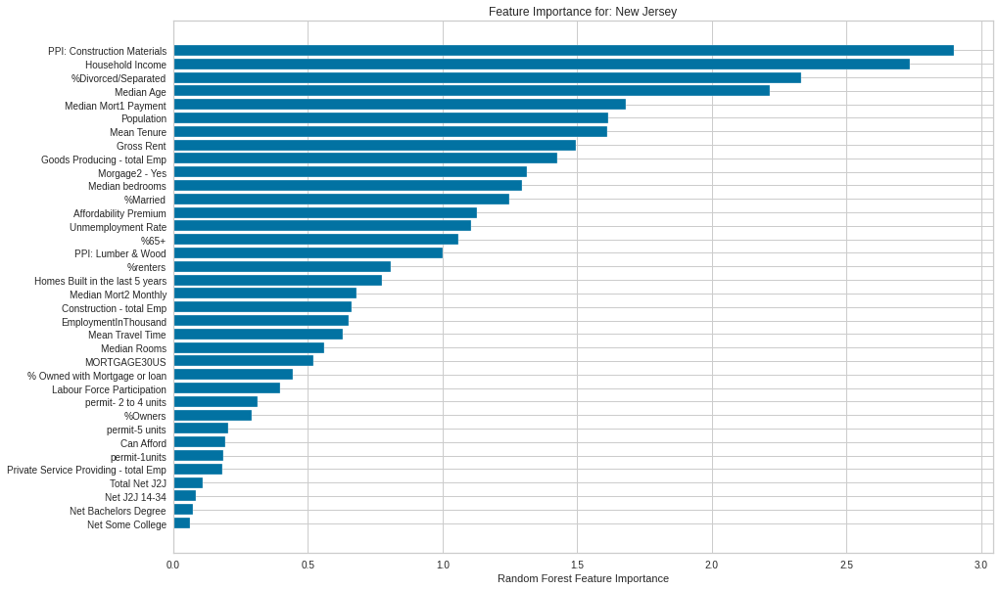

************************************************************************************************************************************************************************************
0. Heatmaps - Utah


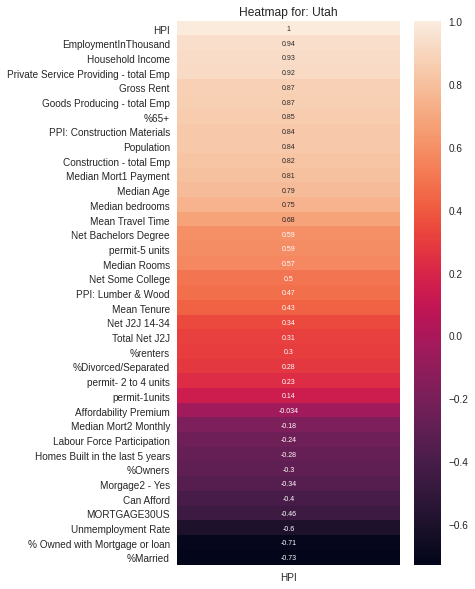

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1 . Errors From model - Utah
CBR Accuracy score:  0.9626824202820634
GBR Accuracy score:  0.9818372369689424
RFR Accuracy score:  0.971420766223189
LR Accuracy Score:  0.9913848190779123
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
2 . Shapley Value for Random Forest - Utah


------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
3. Linear Coeff - Utah


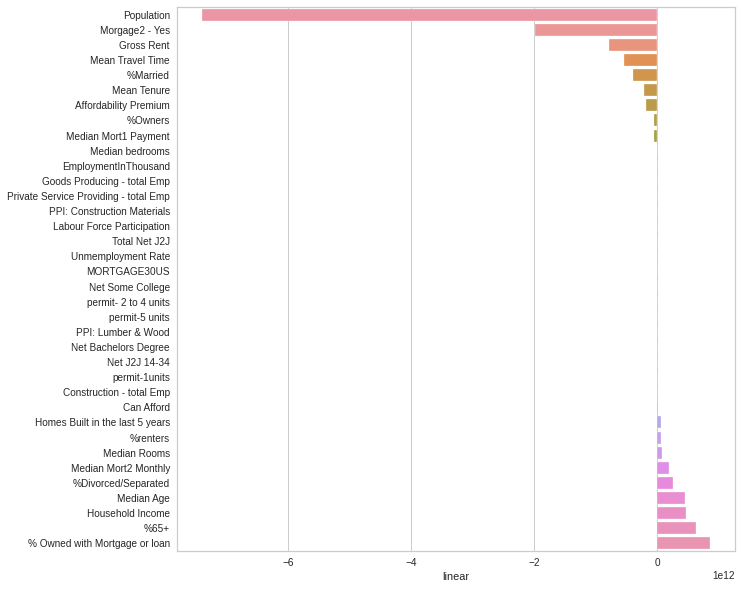

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
4. Feature Importance - Utah


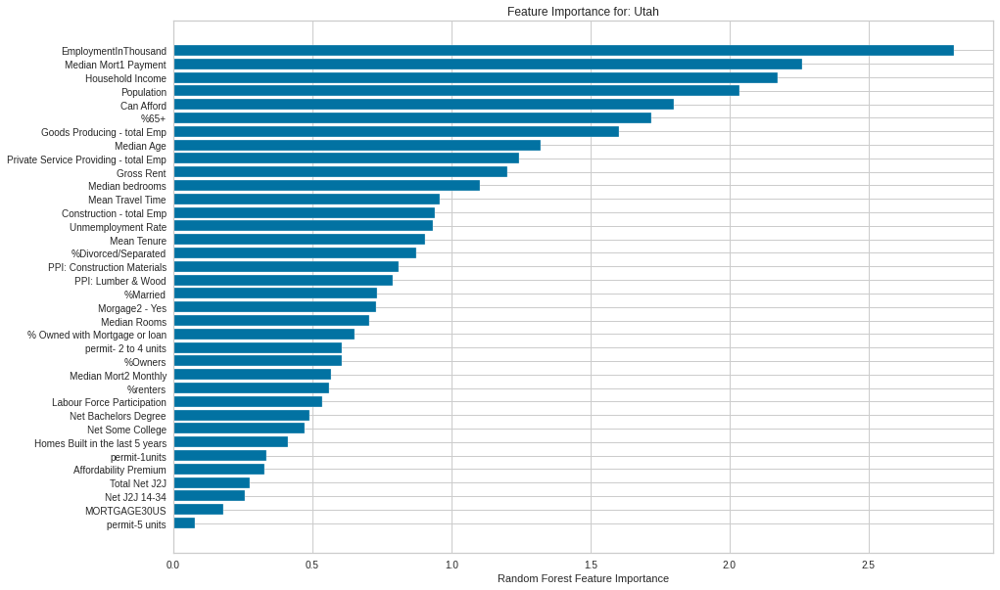

************************************************************************************************************************************************************************************
0. Heatmaps - New Hampshire


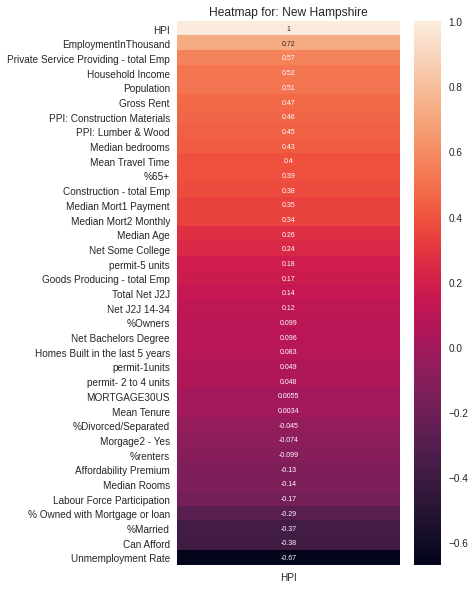

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1 . Errors From model - New Hampshire
CBR Accuracy score:  0.9351947798482008
GBR Accuracy score:  0.9160024457515411
RFR Accuracy score:  0.8976280982387496
LR Accuracy Score:  0.9849148521020541
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
2 . Shapley Value for Random Forest - New Hampshire


------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
3. Linear Coeff - New Hampshire


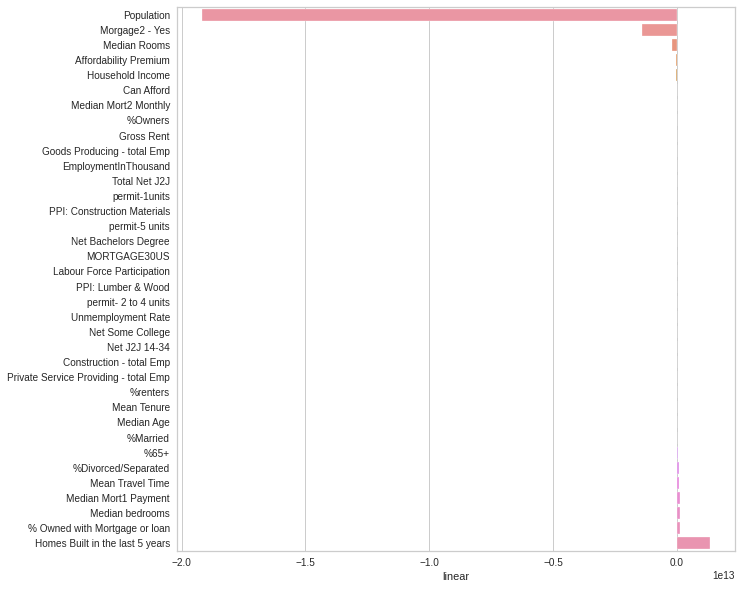

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
4. Feature Importance - New Hampshire


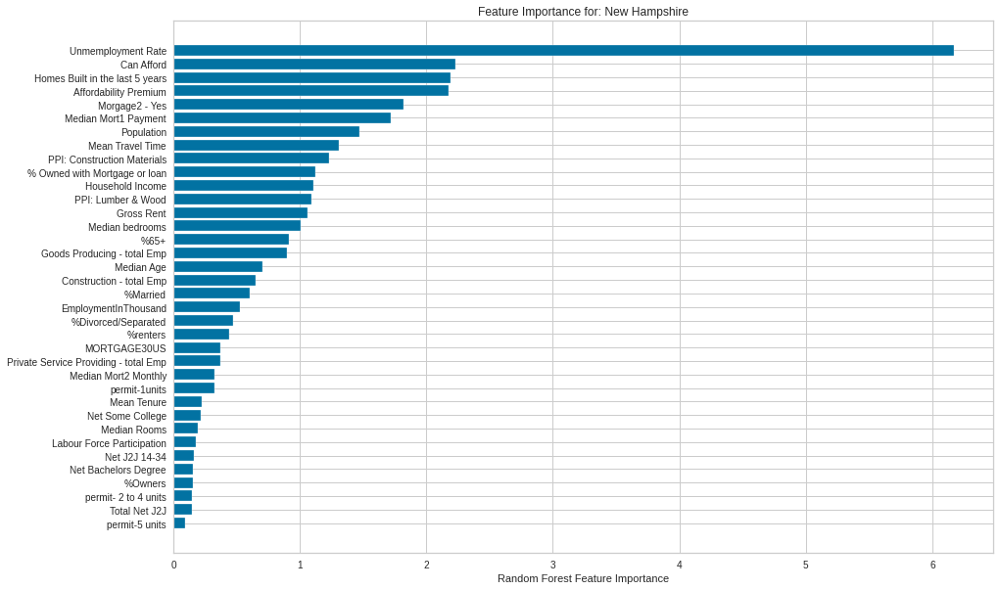

************************************************************************************************************************************************************************************
0. Heatmaps - Vermont


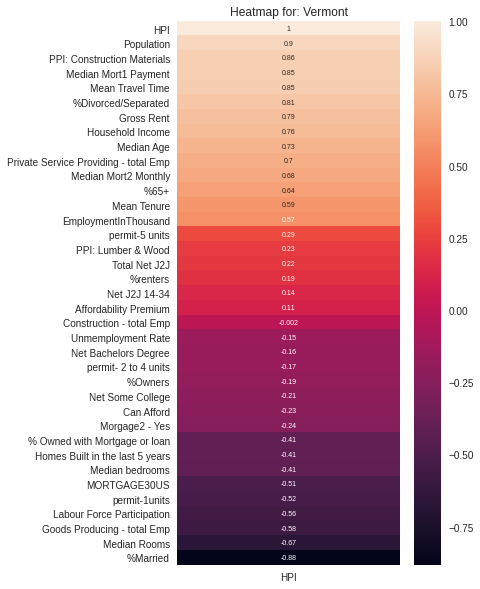

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1 . Errors From model - Vermont
CBR Accuracy score:  0.9856824440115408
GBR Accuracy score:  0.9960286771110296
RFR Accuracy score:  0.9816201351281714
LR Accuracy Score:  0.9918194455615067
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
2 . Shapley Value for Random Forest - Vermont


------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
3. Linear Coeff - Vermont


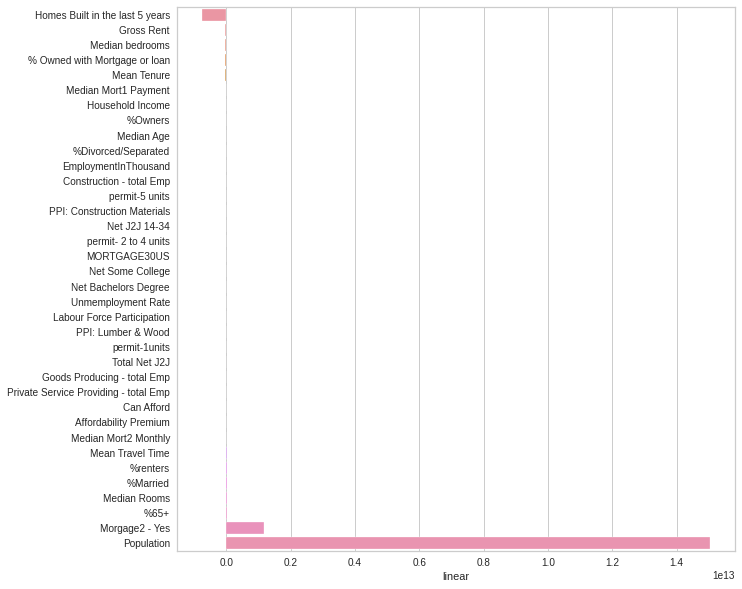

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
4. Feature Importance - Vermont


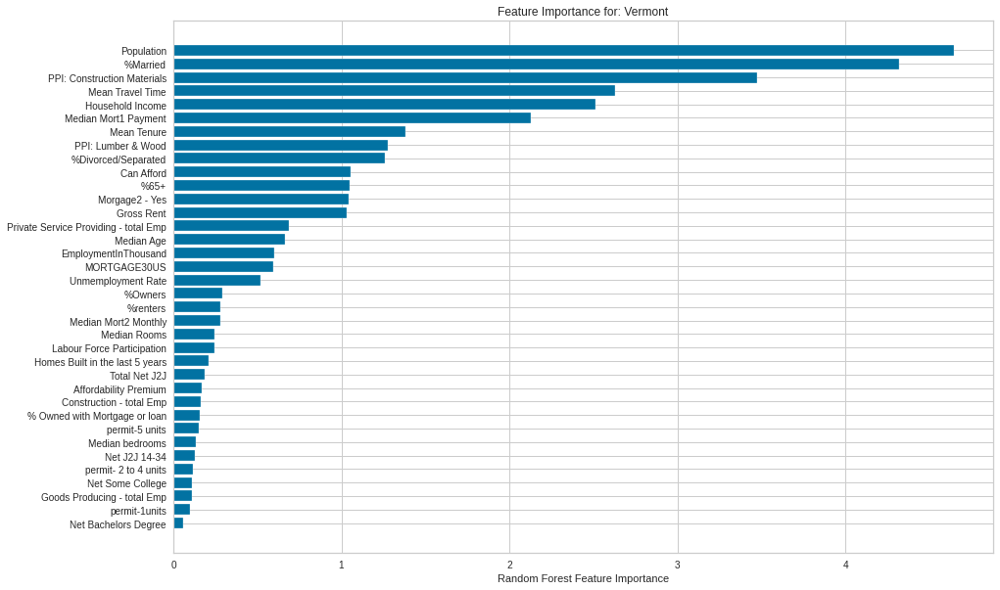

************************************************************************************************************************************************************************************
0. Heatmaps - Montana


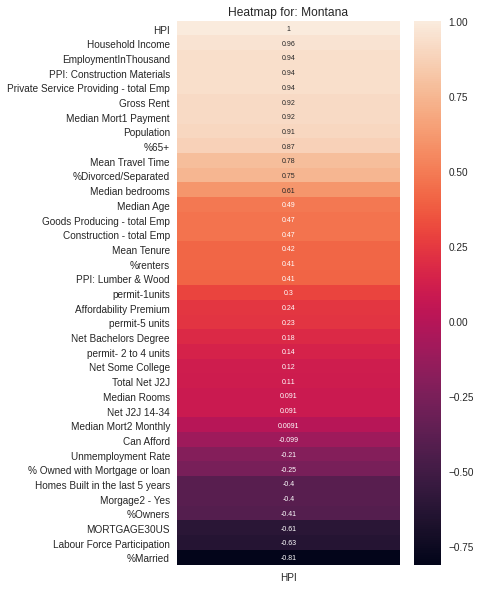

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1 . Errors From model - Montana
CBR Accuracy score:  0.9660796229261727
GBR Accuracy score:  0.9878264141173279
RFR Accuracy score:  0.9804689852480475
LR Accuracy Score:  0.996232410495682
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
2 . Shapley Value for Random Forest - Montana


------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
3. Linear Coeff - Montana


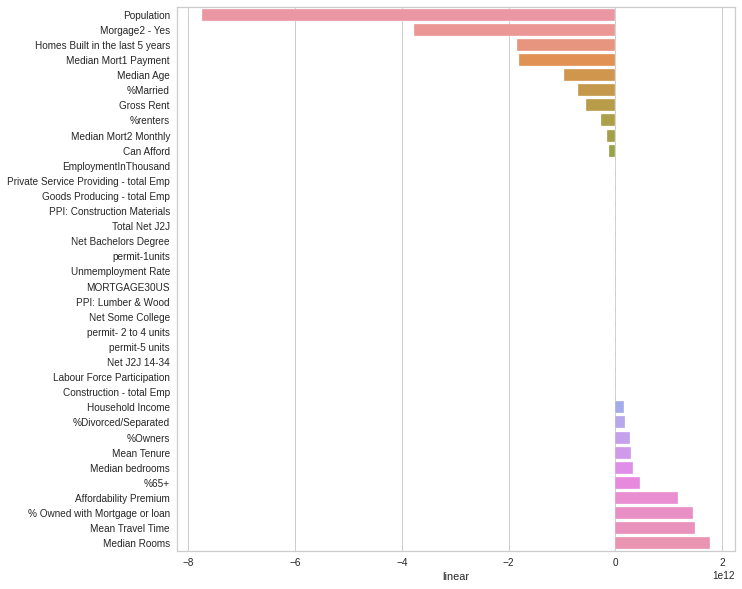

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
4. Feature Importance - Montana


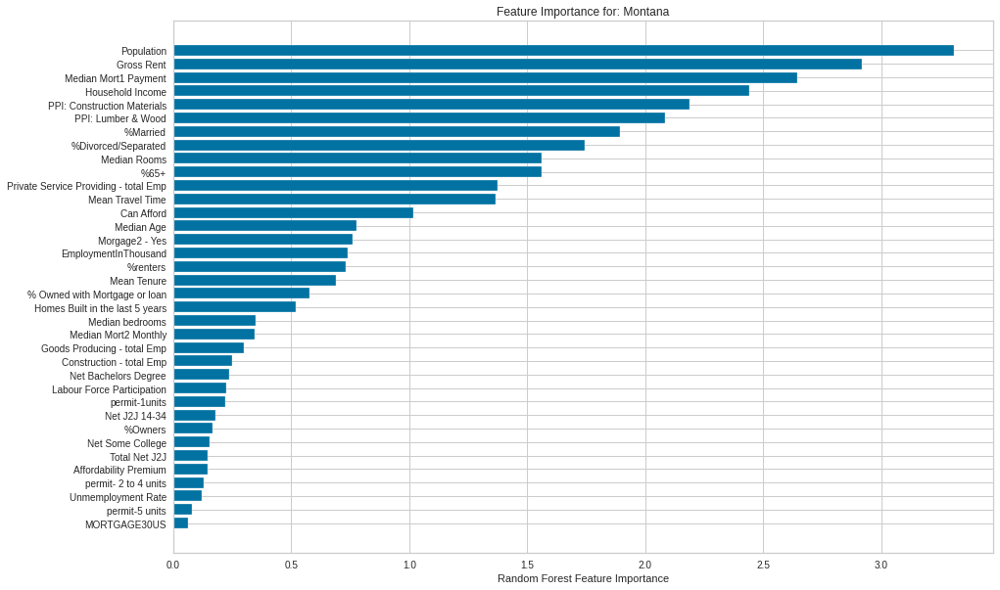

************************************************************************************************************************************************************************************
0. Heatmaps - Maryland


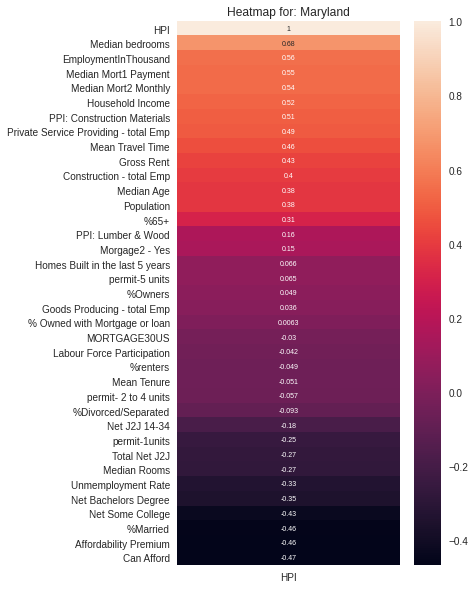

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1 . Errors From model - Maryland
CBR Accuracy score:  0.9803315518902984
GBR Accuracy score:  0.979119600523081
RFR Accuracy score:  0.9852960046959434
LR Accuracy Score:  0.9946854710015403
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
2 . Shapley Value for Random Forest - Maryland


------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
3. Linear Coeff - Maryland


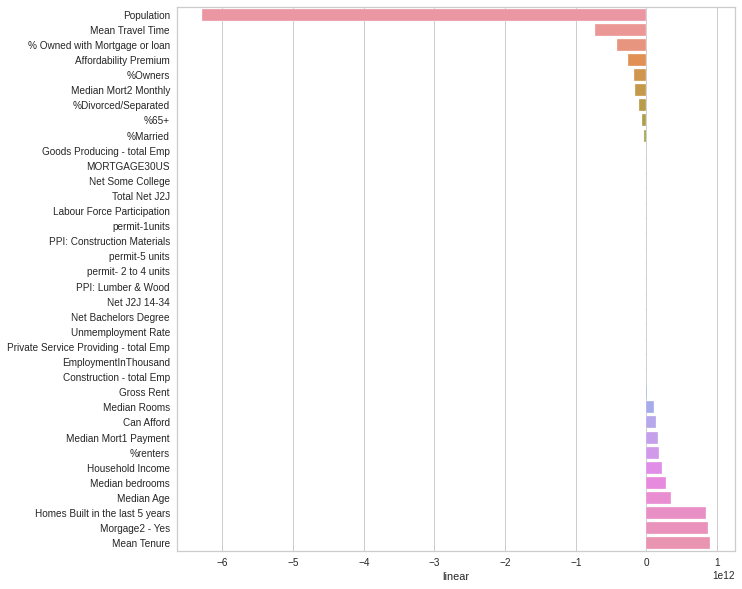

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
4. Feature Importance - Maryland


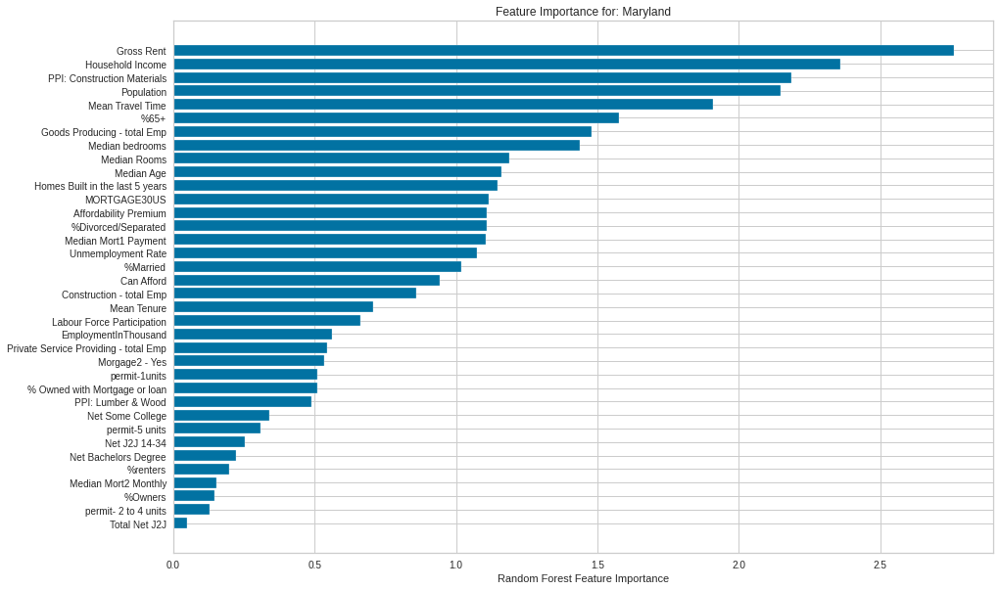

************************************************************************************************************************************************************************************
0. Heatmaps - Virginia


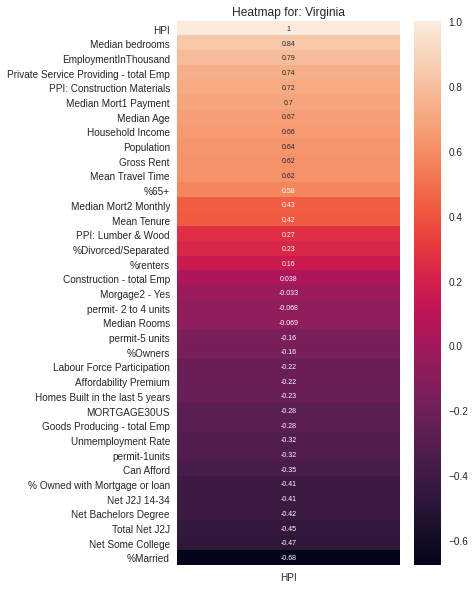

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1 . Errors From model - Virginia
CBR Accuracy score:  0.9820289616942174
GBR Accuracy score:  0.9736684265652585
RFR Accuracy score:  0.9234097668409315
LR Accuracy Score:  0.9979804964201391
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
2 . Shapley Value for Random Forest - Virginia


------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
3. Linear Coeff - Virginia


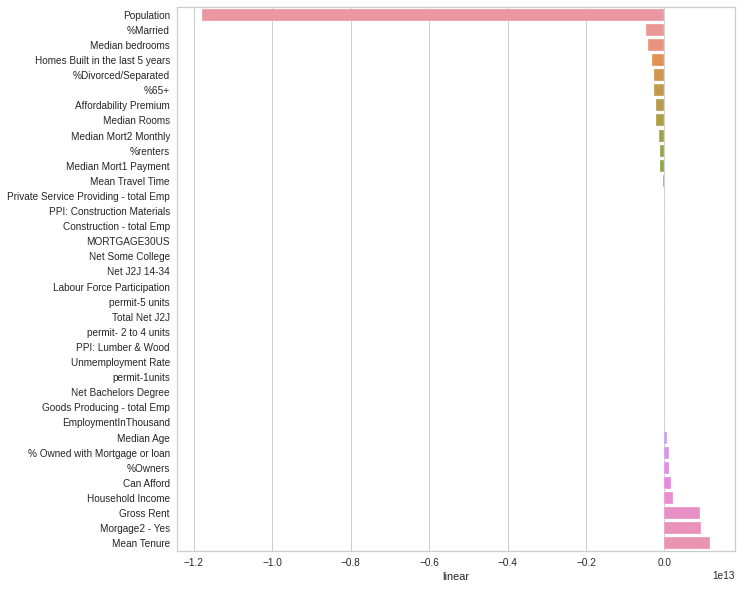

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
4. Feature Importance - Virginia


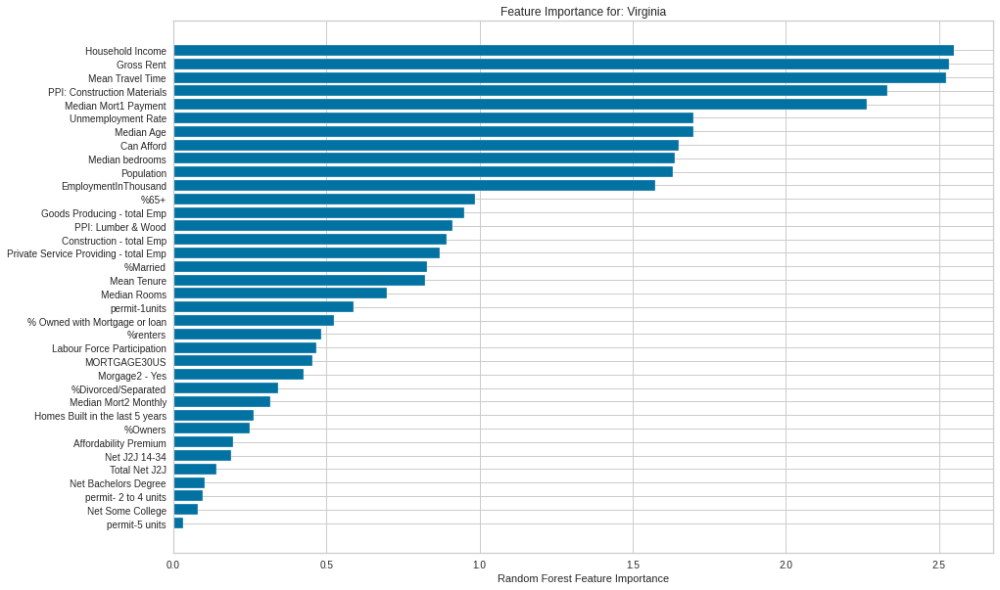

************************************************************************************************************************************************************************************
0. Heatmaps - Delaware


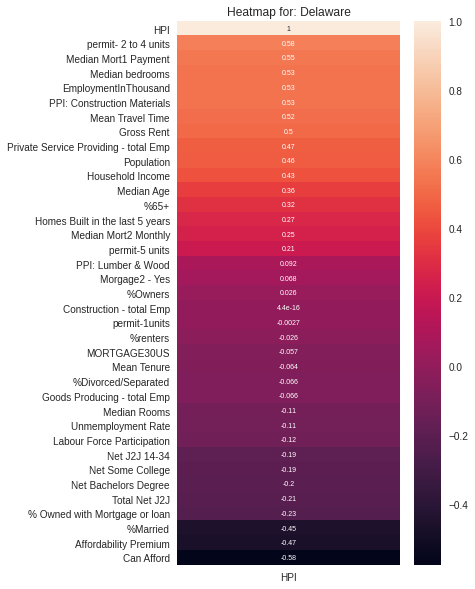

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1 . Errors From model - Delaware
CBR Accuracy score:  0.9758205659973724
GBR Accuracy score:  0.9793430735987786
RFR Accuracy score:  0.9675187216846908
LR Accuracy Score:  0.9950333190512672
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
2 . Shapley Value for Random Forest - Delaware


------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
3. Linear Coeff - Delaware


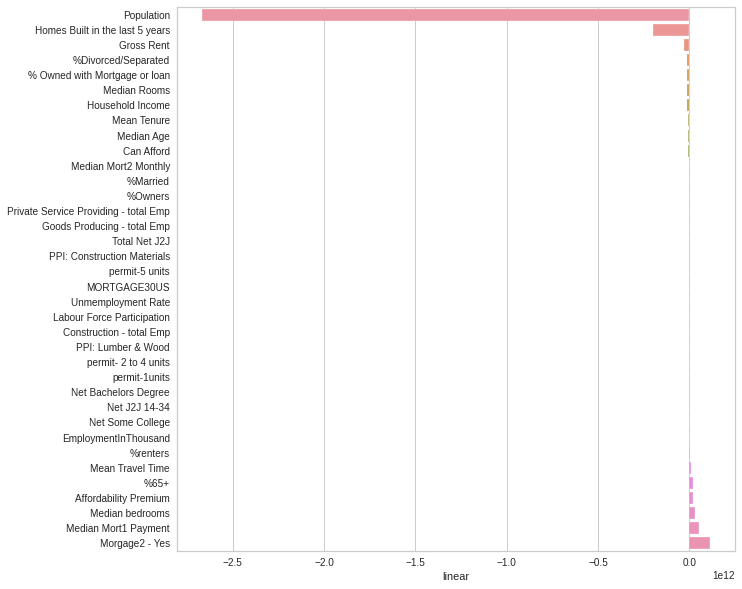

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
4. Feature Importance - Delaware


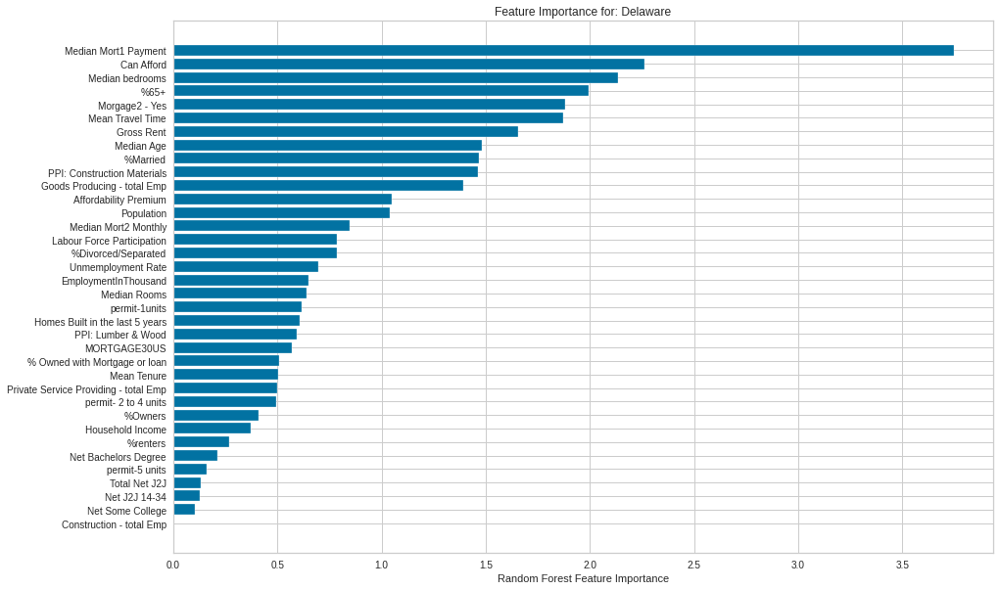

************************************************************************************************************************************************************************************
0. Heatmaps - Florida


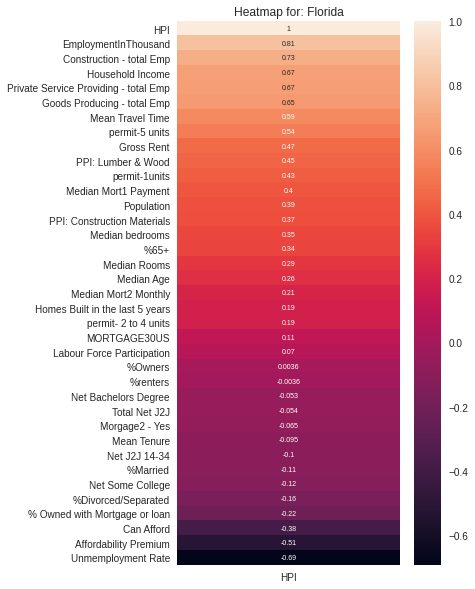

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1 . Errors From model - Florida
CBR Accuracy score:  0.9708074275542952
GBR Accuracy score:  0.9644629067959504
RFR Accuracy score:  0.9594630751434151
LR Accuracy Score:  0.9947408354303329
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
2 . Shapley Value for Random Forest - Florida


------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
3. Linear Coeff - Florida


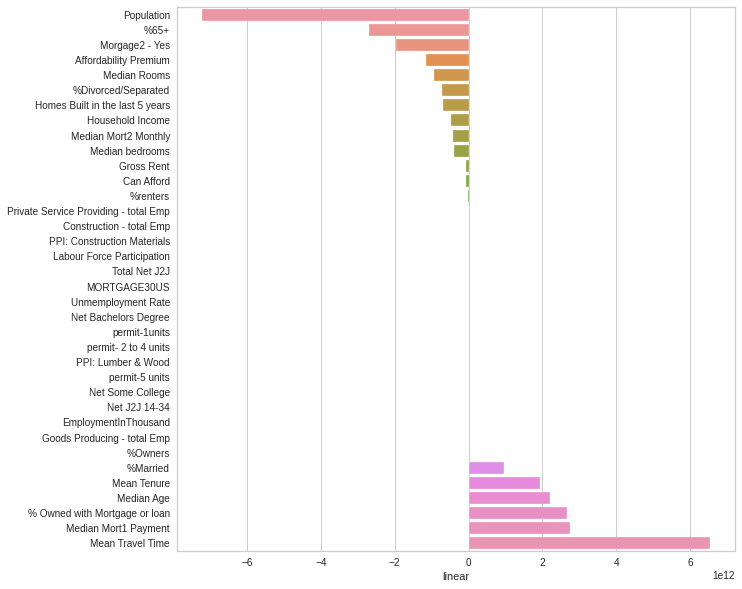

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
4. Feature Importance - Florida


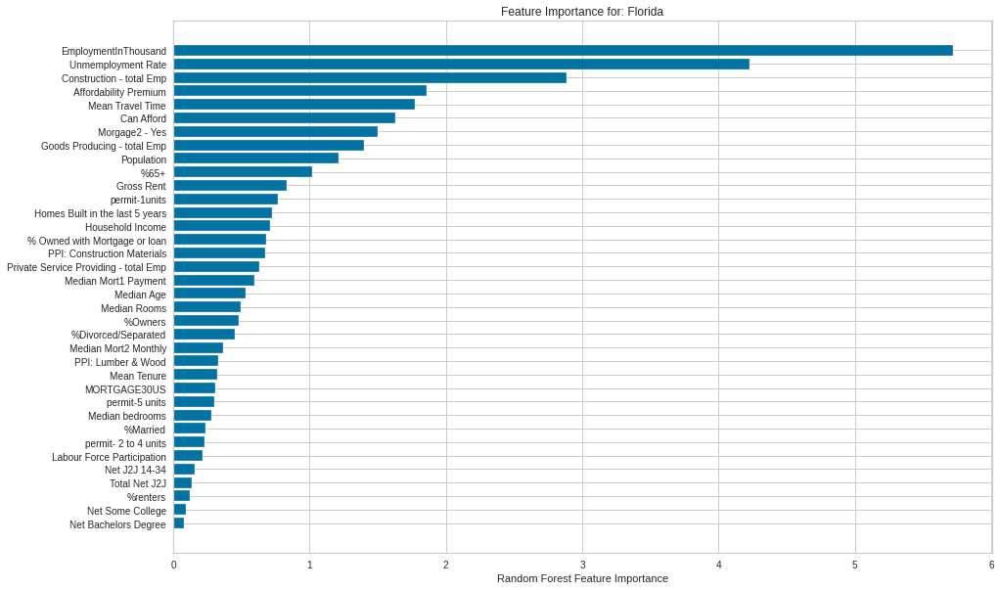

************************************************************************************************************************************************************************************
0. Heatmaps - Idaho


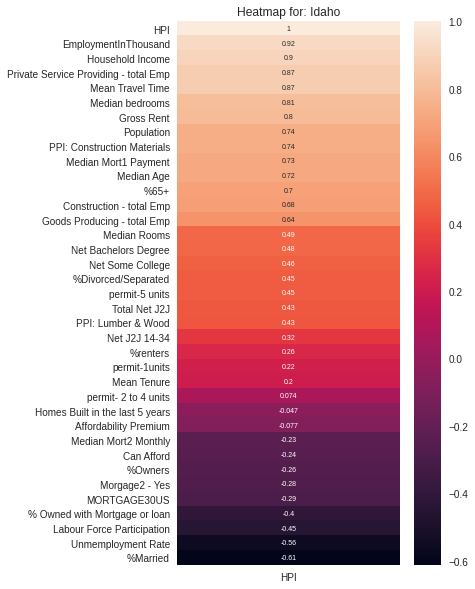

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1 . Errors From model - Idaho
CBR Accuracy score:  0.9720147388982193
GBR Accuracy score:  0.9512692041465162
RFR Accuracy score:  0.9501063968373122
LR Accuracy Score:  0.9954019316290043
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
2 . Shapley Value for Random Forest - Idaho


------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
3. Linear Coeff - Idaho


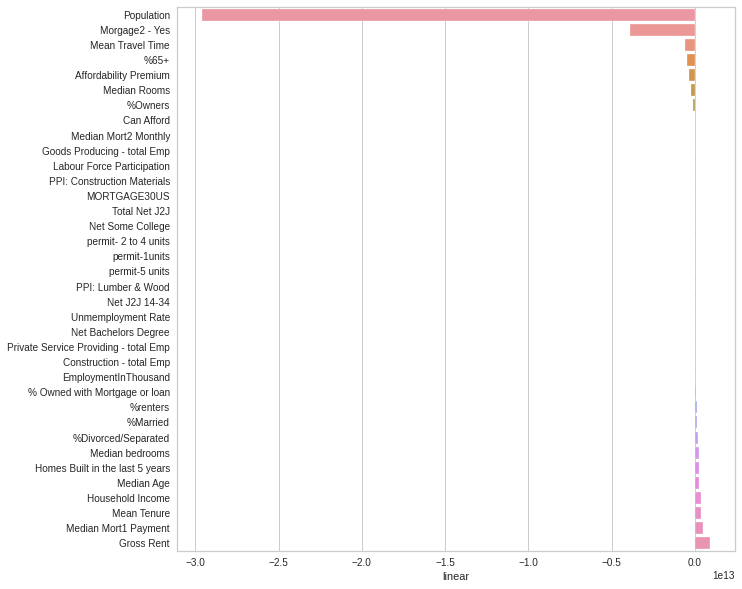

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
4. Feature Importance - Idaho


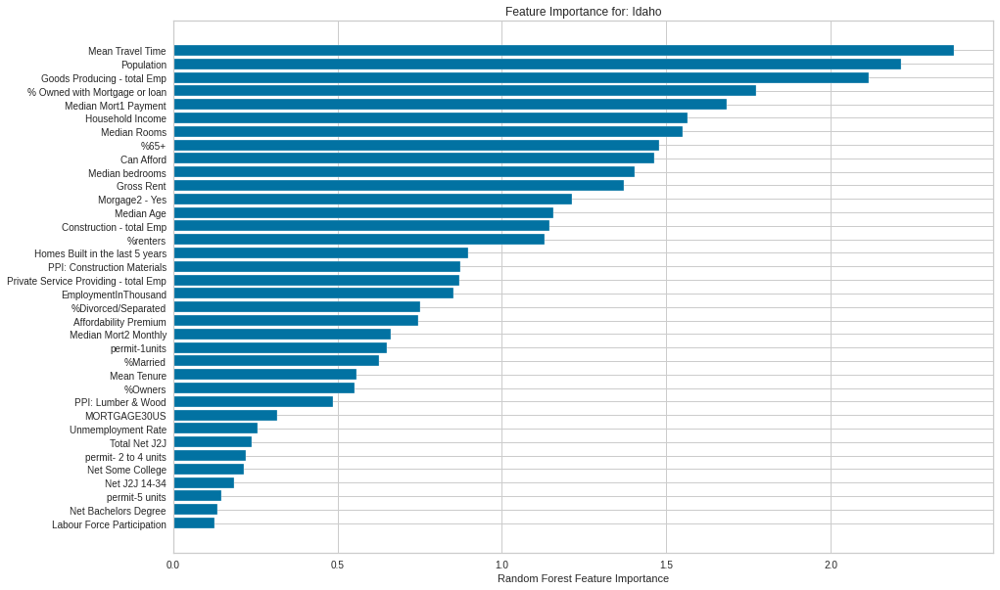

************************************************************************************************************************************************************************************
0. Heatmaps - Pennsylvania


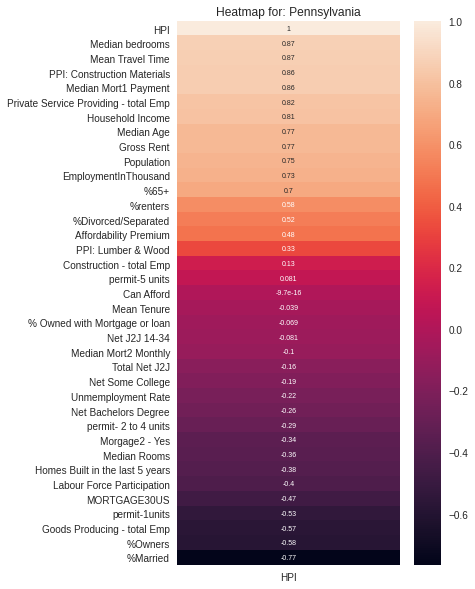

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1 . Errors From model - Pennsylvania
CBR Accuracy score:  0.9697231450892445
GBR Accuracy score:  0.9939954393690215
RFR Accuracy score:  0.9835245546929124
LR Accuracy Score:  0.9971971384073591
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
2 . Shapley Value for Random Forest - Pennsylvania


------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
3. Linear Coeff - Pennsylvania


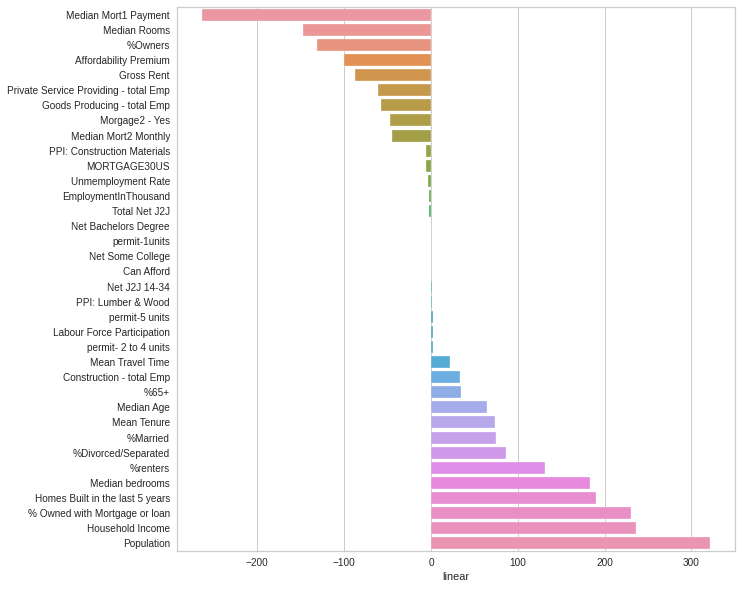

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
4. Feature Importance - Pennsylvania


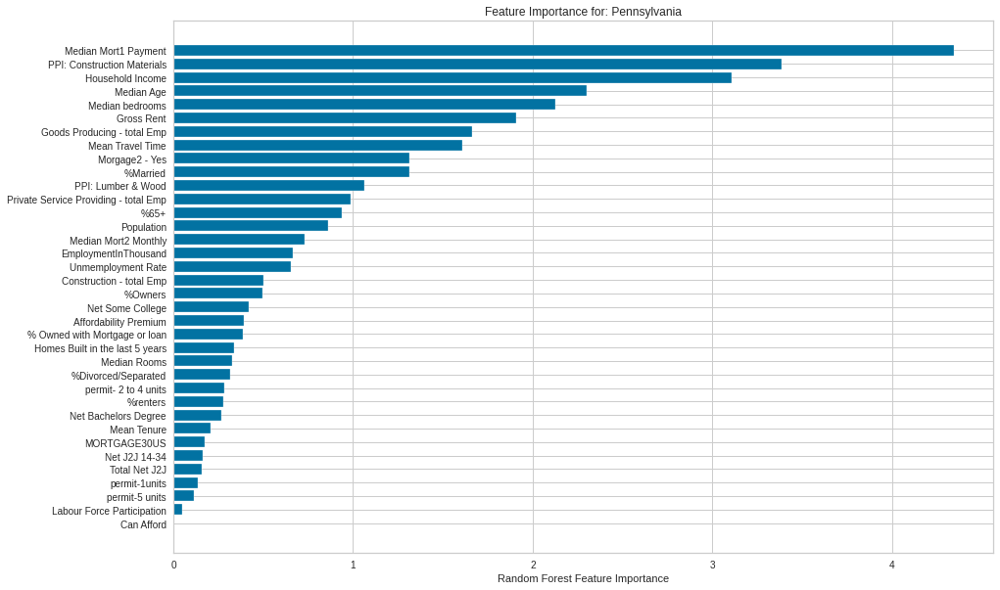

************************************************************************************************************************************************************************************
0. Heatmaps - Arizona


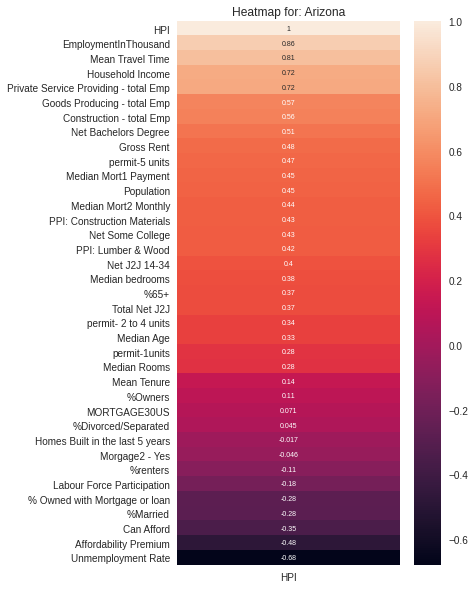

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1 . Errors From model - Arizona
CBR Accuracy score:  0.972306083788278
GBR Accuracy score:  0.9448809539740955
RFR Accuracy score:  0.9295218698994545
LR Accuracy Score:  0.9915093085286604
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
2 . Shapley Value for Random Forest - Arizona


------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
3. Linear Coeff - Arizona


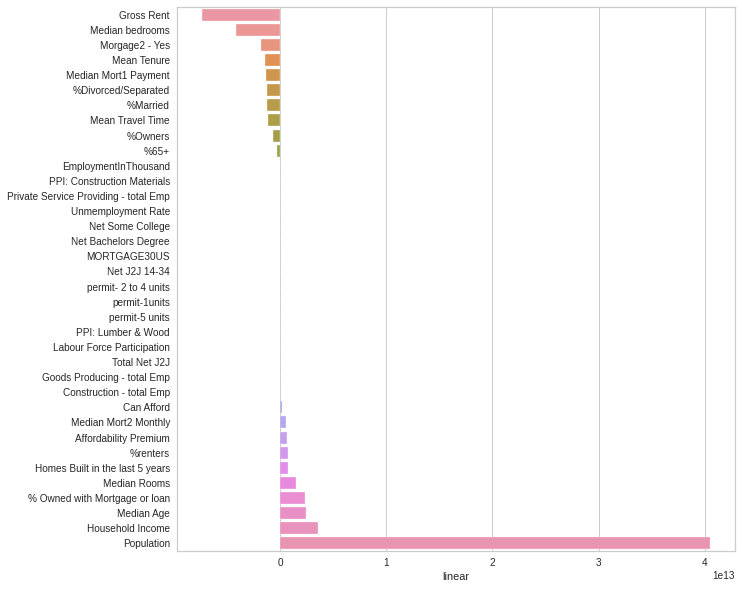

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
4. Feature Importance - Arizona


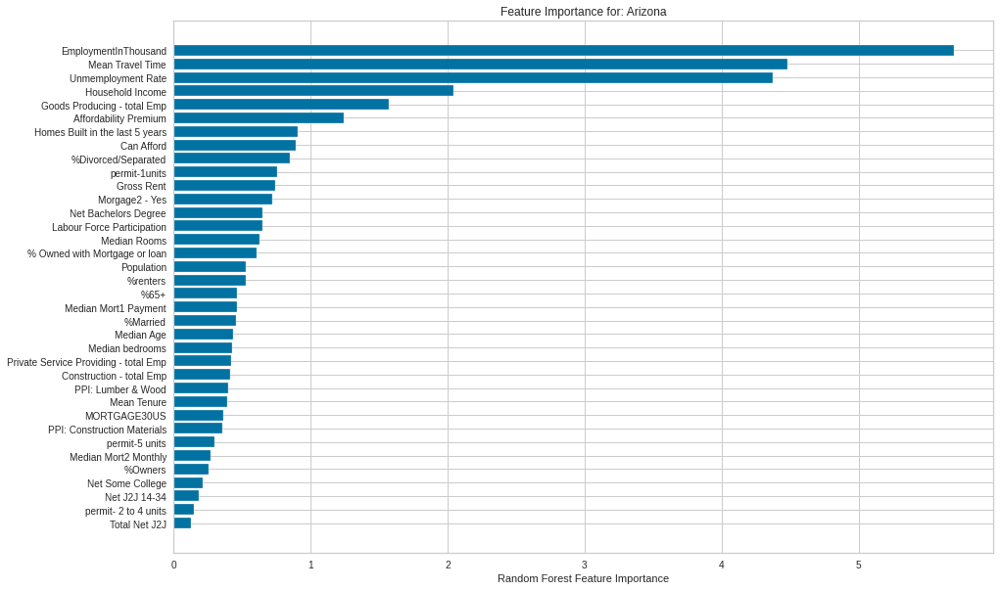

************************************************************************************************************************************************************************************
0. Heatmaps - Minnesota


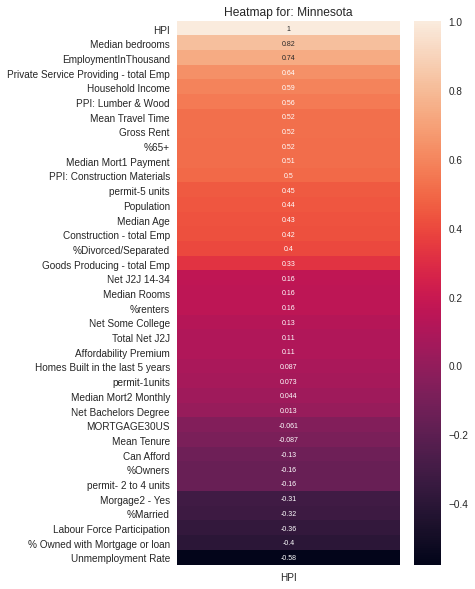

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1 . Errors From model - Minnesota
CBR Accuracy score:  0.9621307830524497
GBR Accuracy score:  0.9717021937091845
RFR Accuracy score:  0.926849284634862
LR Accuracy Score:  0.985104068777037
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
2 . Shapley Value for Random Forest - Minnesota


------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
3. Linear Coeff - Minnesota


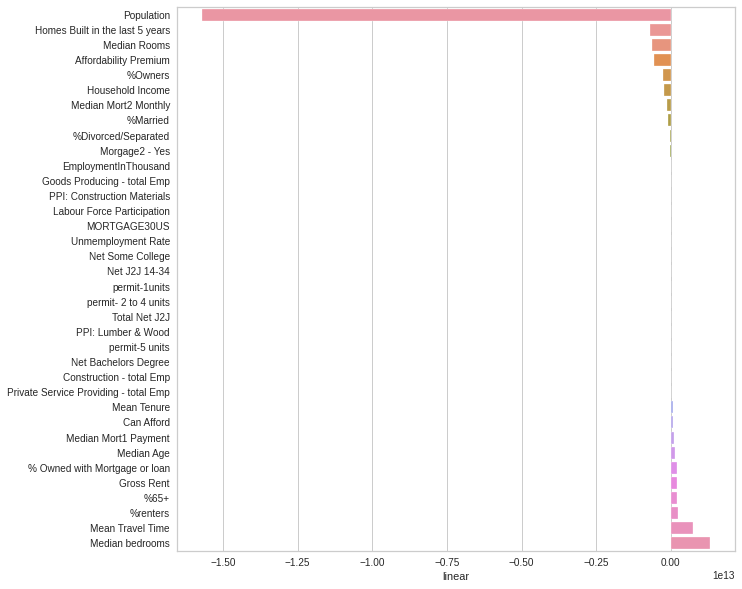

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
4. Feature Importance - Minnesota


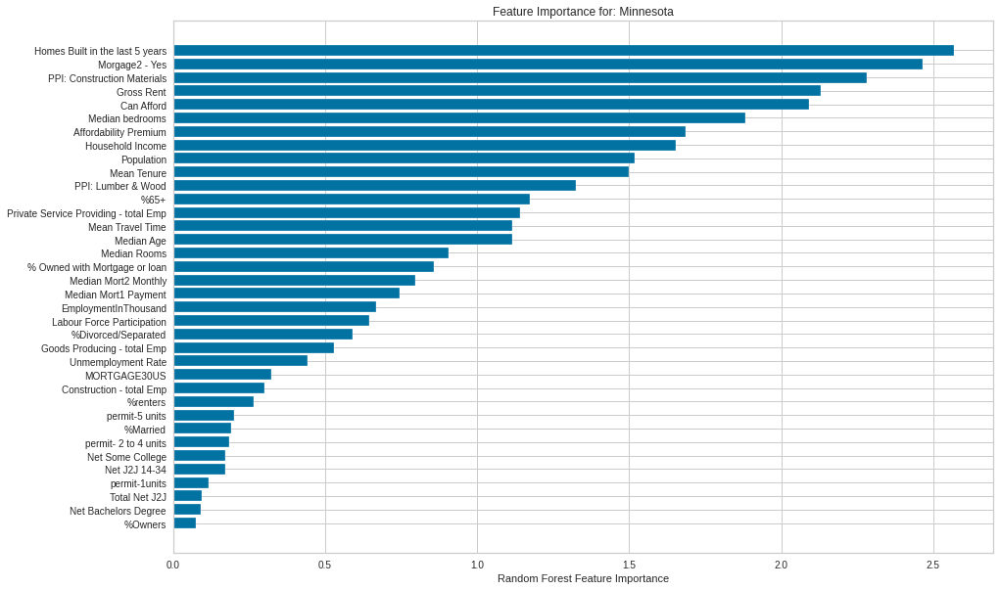

************************************************************************************************************************************************************************************
0. Heatmaps - Connecticut


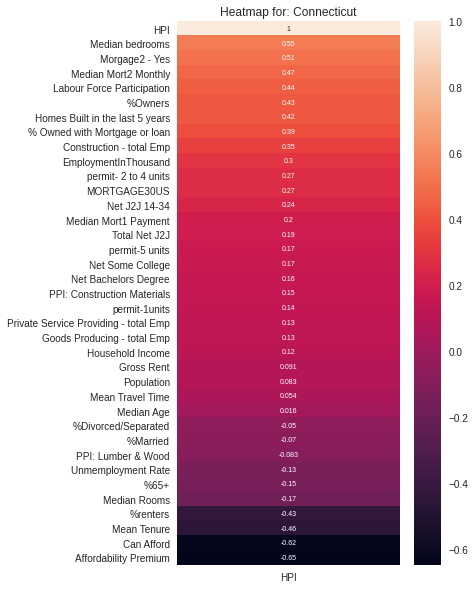

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1 . Errors From model - Connecticut
CBR Accuracy score:  0.9778830796079179
GBR Accuracy score:  0.969283930350221
RFR Accuracy score:  0.9598215359787178
LR Accuracy Score:  0.9847526972764027
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
2 . Shapley Value for Random Forest - Connecticut


------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
3. Linear Coeff - Connecticut


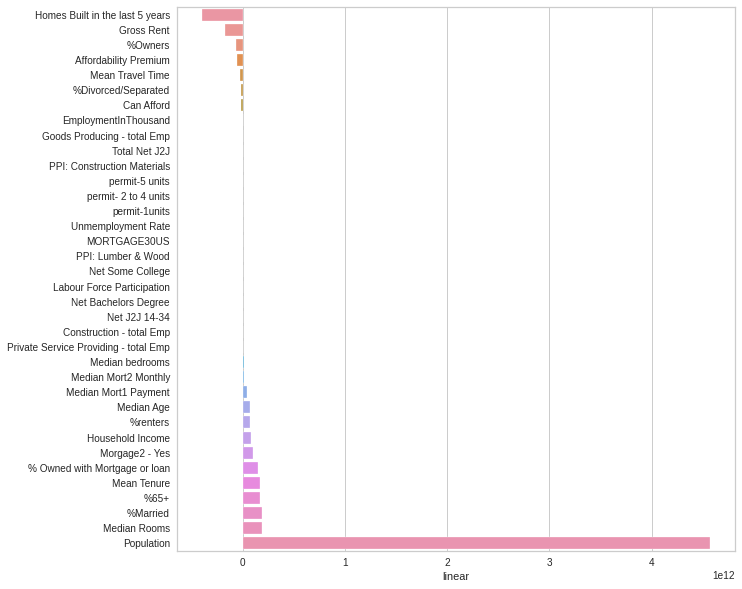

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
4. Feature Importance - Connecticut


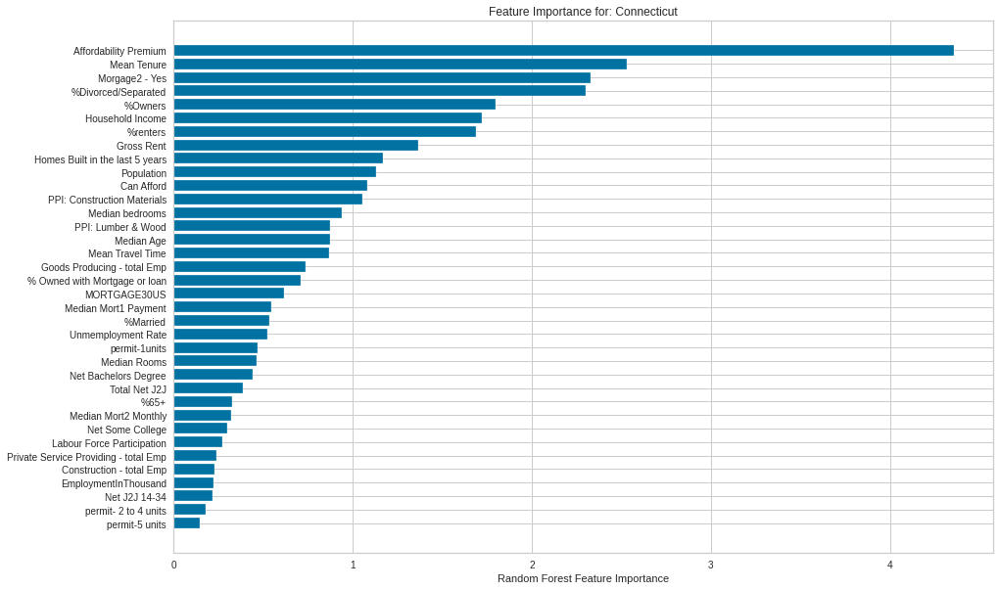

************************************************************************************************************************************************************************************
0. Heatmaps - South Carolina


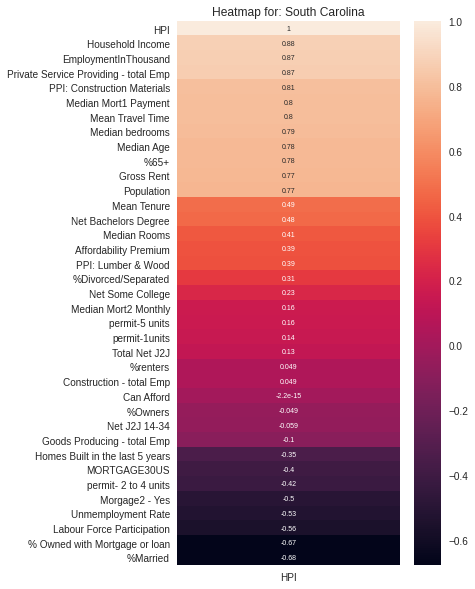

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1 . Errors From model - South Carolina
CBR Accuracy score:  0.966120143162486
GBR Accuracy score:  0.9741283452207617
RFR Accuracy score:  0.9598719320246635
LR Accuracy Score:  0.9944326183054026
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
2 . Shapley Value for Random Forest - South Carolina


------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
3. Linear Coeff - South Carolina


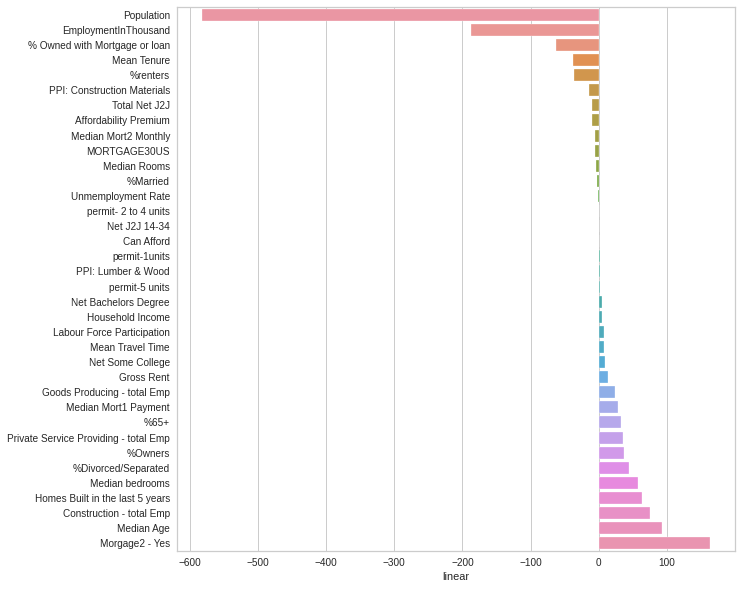

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
4. Feature Importance - South Carolina


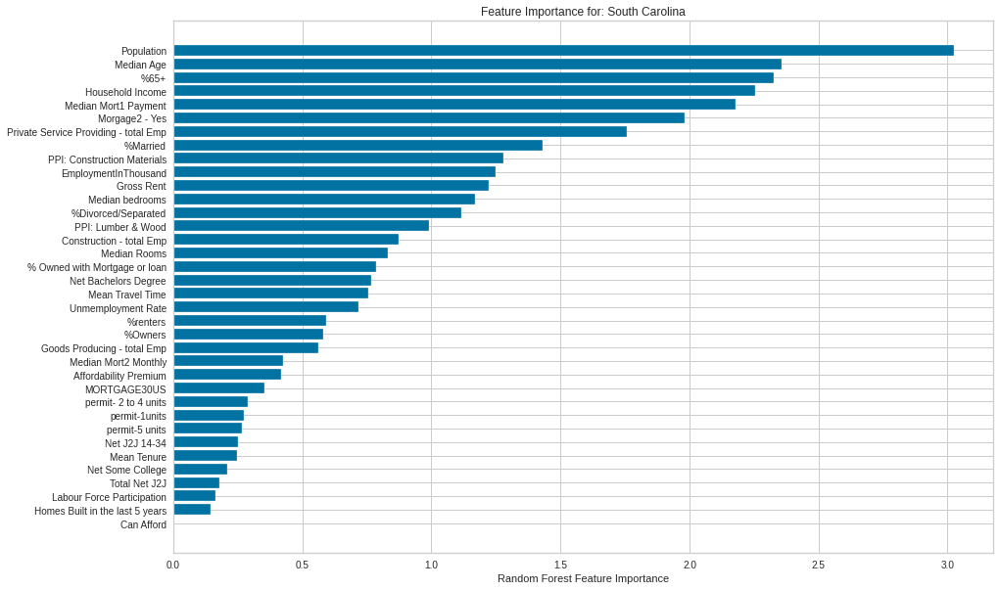

************************************************************************************************************************************************************************************
0. Heatmaps - Tennessee


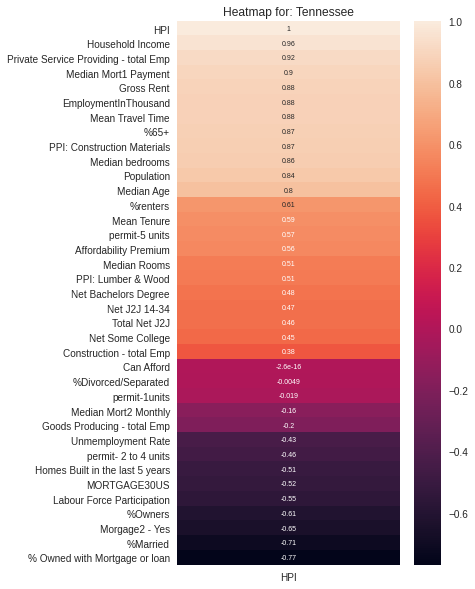

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1 . Errors From model - Tennessee
CBR Accuracy score:  0.9872468159855126
GBR Accuracy score:  0.9911229374483859
RFR Accuracy score:  0.9855885832154031
LR Accuracy Score:  0.995655611594957
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
2 . Shapley Value for Random Forest - Tennessee


------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
3. Linear Coeff - Tennessee


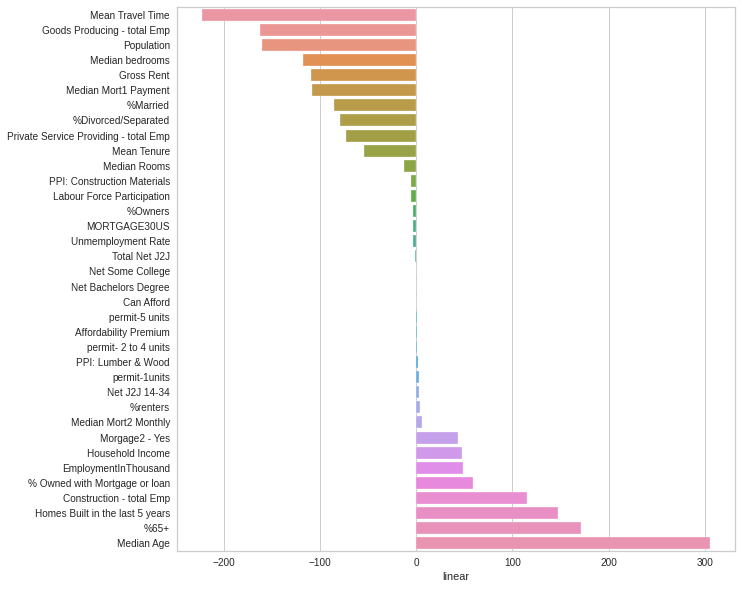

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
4. Feature Importance - Tennessee


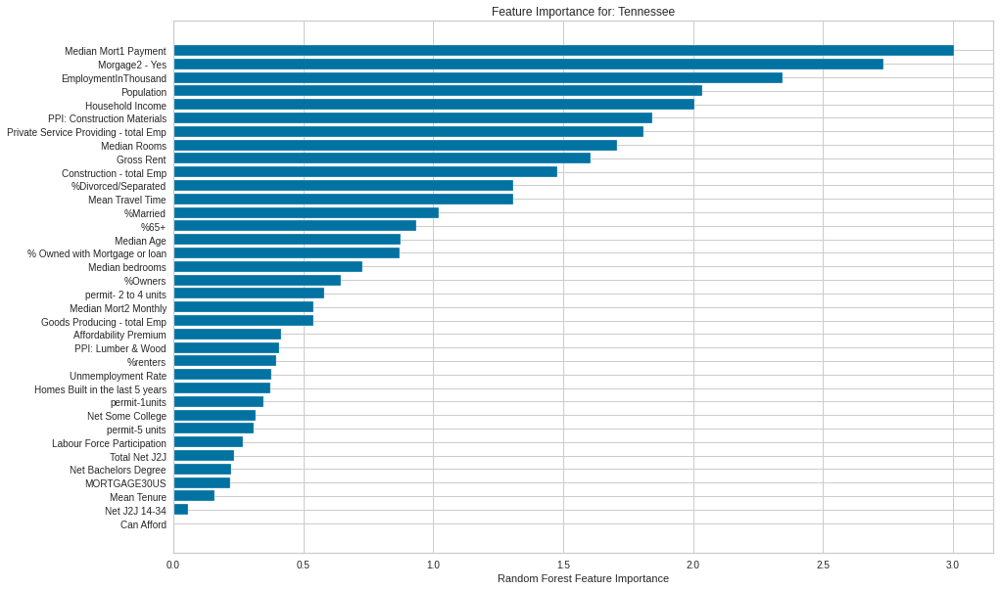

************************************************************************************************************************************************************************************
0. Heatmaps - North Carolina


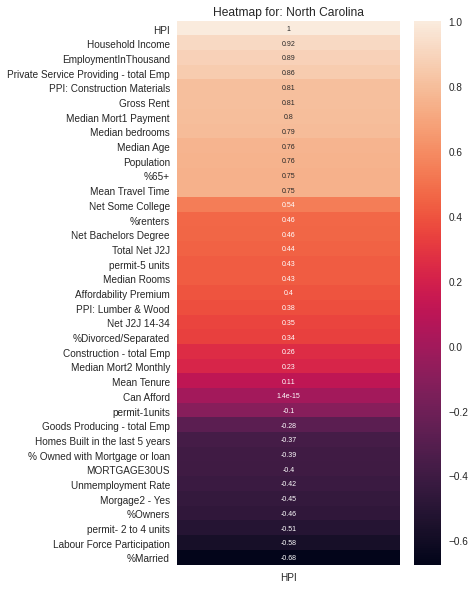

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1 . Errors From model - North Carolina
CBR Accuracy score:  0.9811992147470234
GBR Accuracy score:  0.98423186665724
RFR Accuracy score:  0.9686954119984273
LR Accuracy Score:  0.9964122252786553
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
2 . Shapley Value for Random Forest - North Carolina


------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
3. Linear Coeff - North Carolina


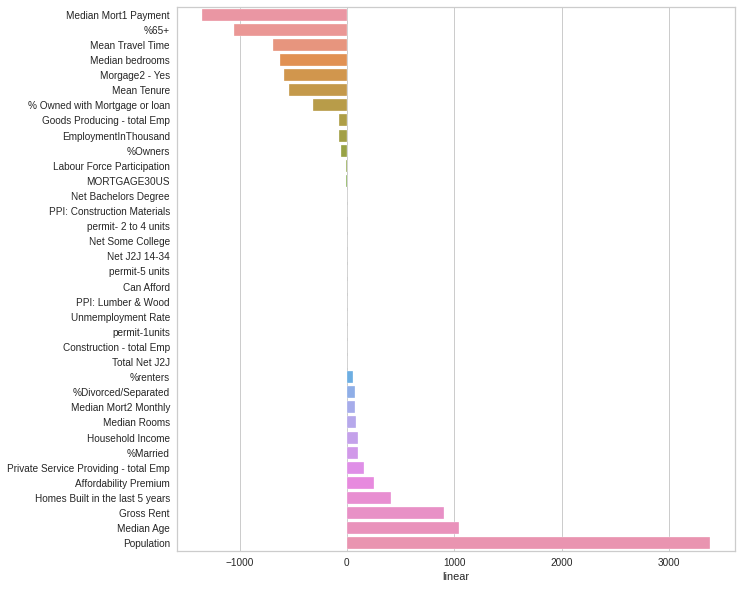

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
4. Feature Importance - North Carolina


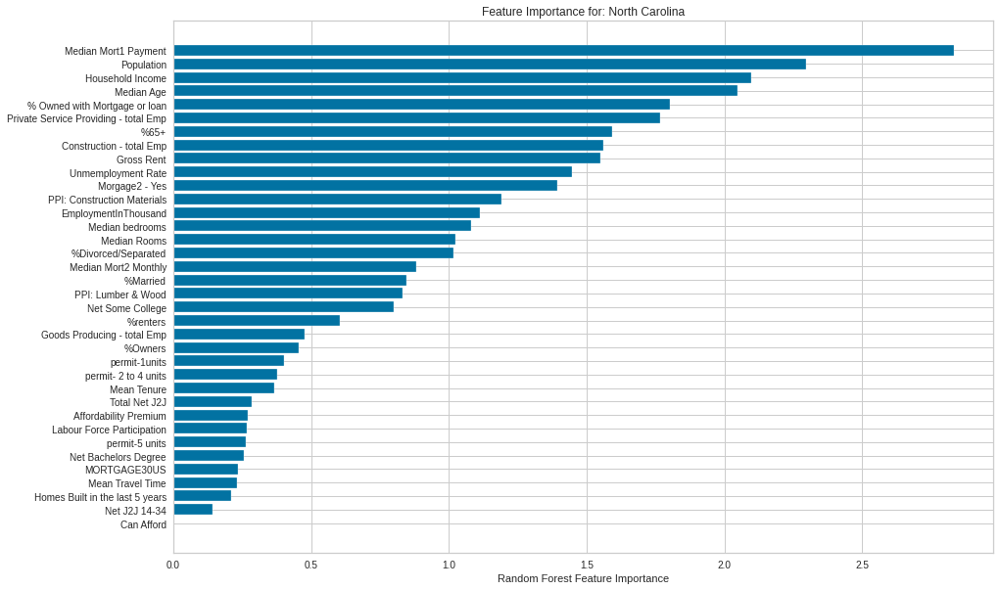

************************************************************************************************************************************************************************************
0. Heatmaps - Nevada


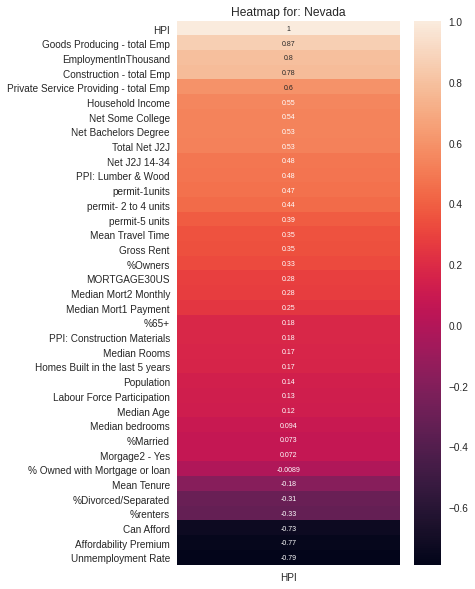

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1 . Errors From model - Nevada
CBR Accuracy score:  0.9792930199423104
GBR Accuracy score:  0.8875575135440068
RFR Accuracy score:  0.8658449174179623
LR Accuracy Score:  0.9899458607379644
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
2 . Shapley Value for Random Forest - Nevada


------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
3. Linear Coeff - Nevada


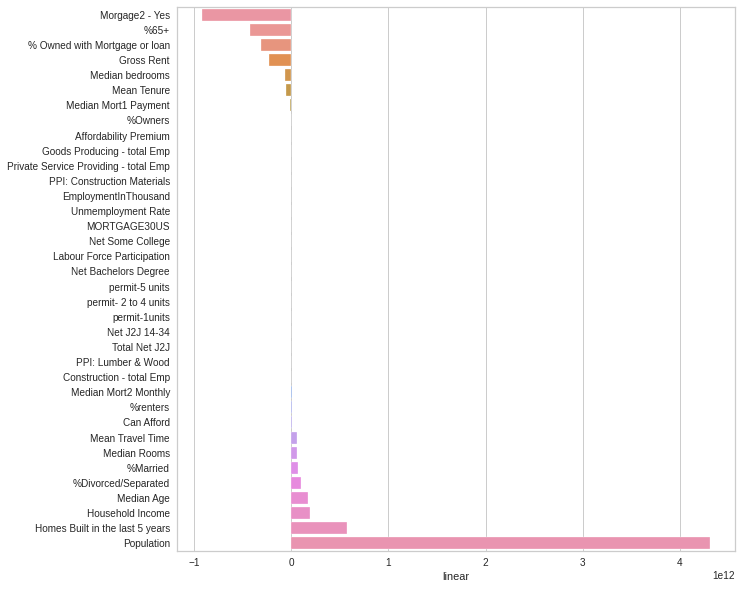

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
4. Feature Importance - Nevada


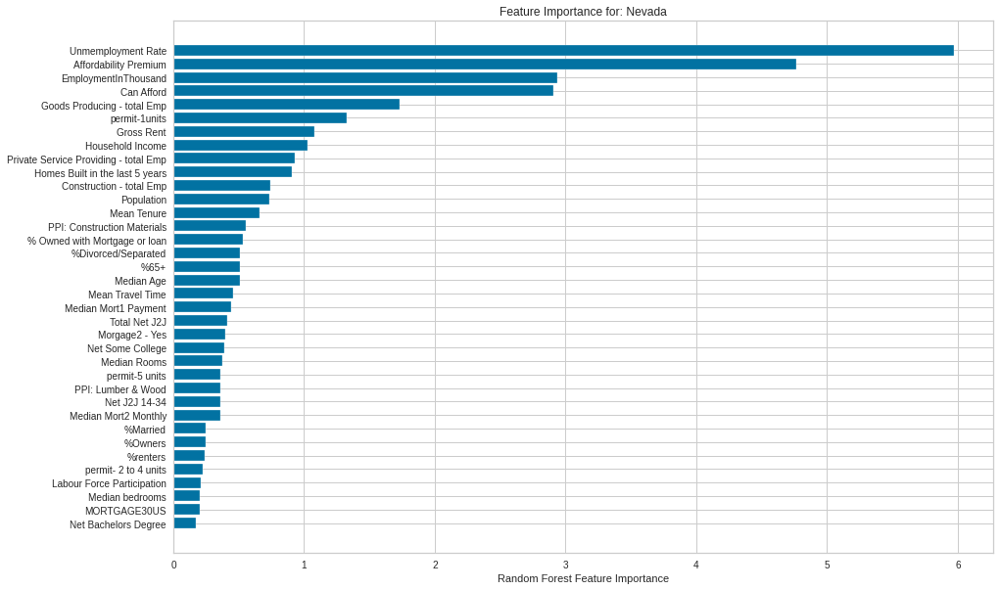

************************************************************************************************************************************************************************************
0. Heatmaps - South Dakota


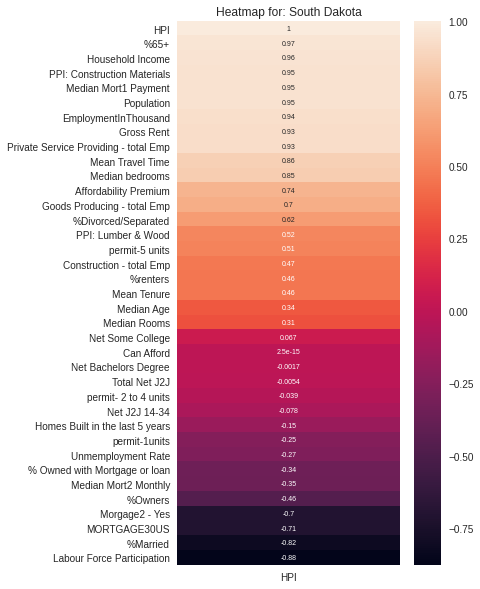

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1 . Errors From model - South Dakota
CBR Accuracy score:  0.9732704802487518
GBR Accuracy score:  0.9864293824385048
RFR Accuracy score:  0.9747628117111802
LR Accuracy Score:  0.998029287999363
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
2 . Shapley Value for Random Forest - South Dakota


------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
3. Linear Coeff - South Dakota


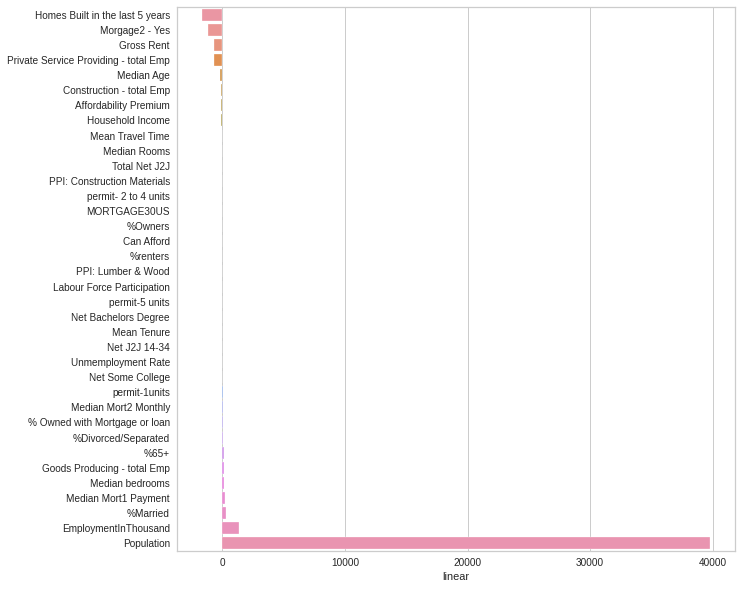

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
4. Feature Importance - South Dakota


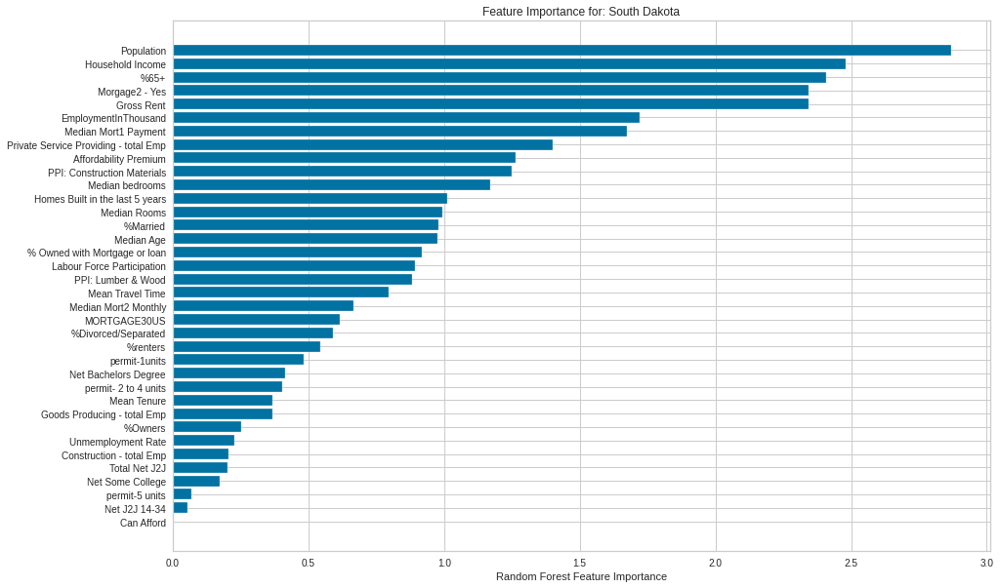

************************************************************************************************************************************************************************************
0. Heatmaps - Georgia


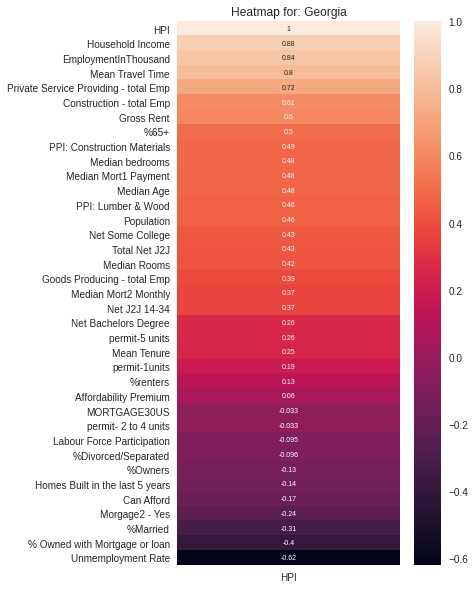

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1 . Errors From model - Georgia
CBR Accuracy score:  0.9665538334128125
GBR Accuracy score:  0.929331287491615
RFR Accuracy score:  0.7362685135153711
LR Accuracy Score:  0.9663710585191815
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
2 . Shapley Value for Random Forest - Georgia


------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
3. Linear Coeff - Georgia


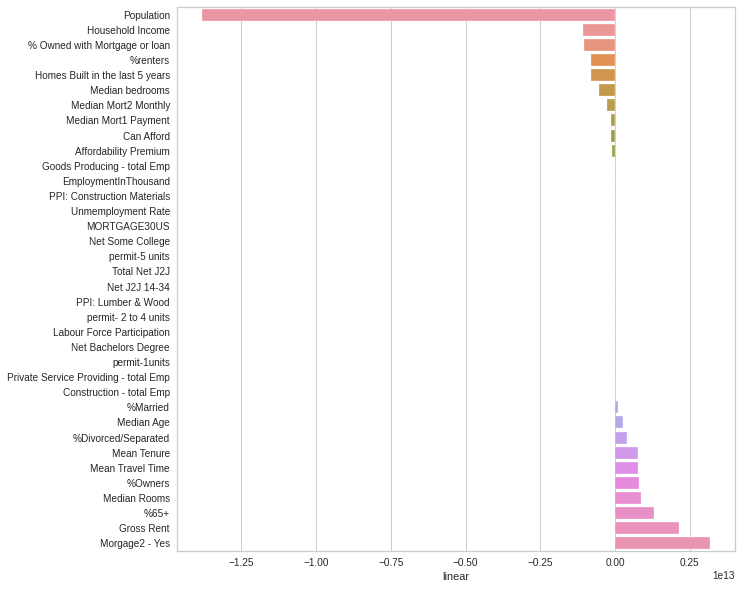

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
4. Feature Importance - Georgia


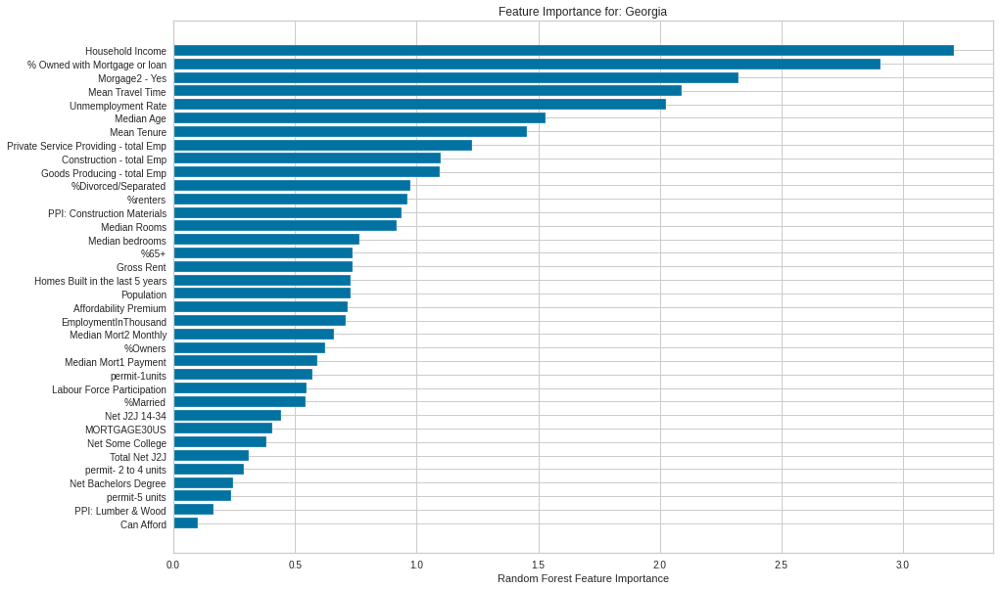

************************************************************************************************************************************************************************************
0. Heatmaps - North Dakota


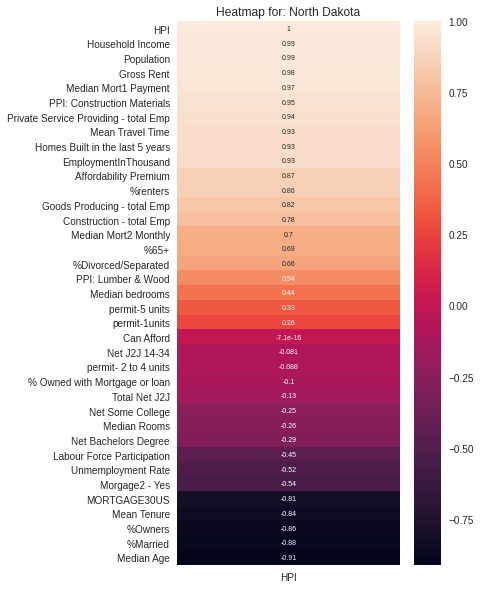

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1 . Errors From model - North Dakota
CBR Accuracy score:  0.9891566333743983
GBR Accuracy score:  0.9968686443573339
RFR Accuracy score:  0.9917499643909807
LR Accuracy Score:  0.9984133576472187
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
2 . Shapley Value for Random Forest - North Dakota


------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
3. Linear Coeff - North Dakota


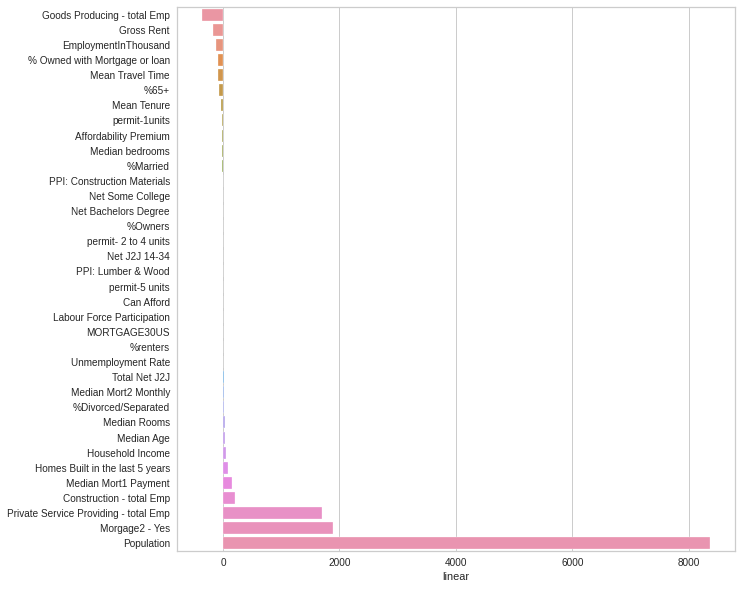

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
4. Feature Importance - North Dakota


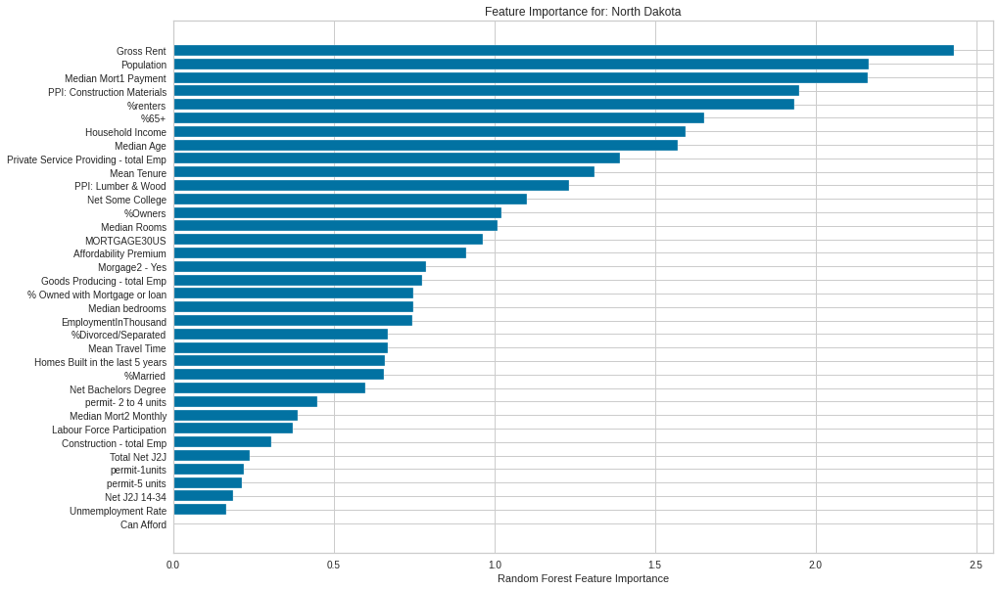

************************************************************************************************************************************************************************************
0. Heatmaps - Wisconsin


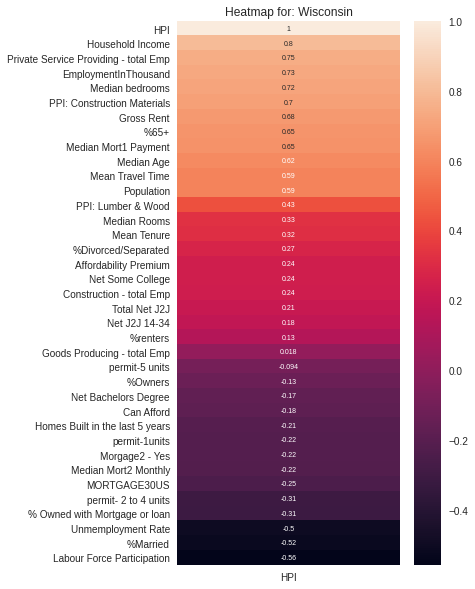

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1 . Errors From model - Wisconsin
CBR Accuracy score:  0.956061672682195
GBR Accuracy score:  0.9667463054627106
RFR Accuracy score:  0.9658589259478517
LR Accuracy Score:  0.9786767956215856
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
2 . Shapley Value for Random Forest - Wisconsin


------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
3. Linear Coeff - Wisconsin


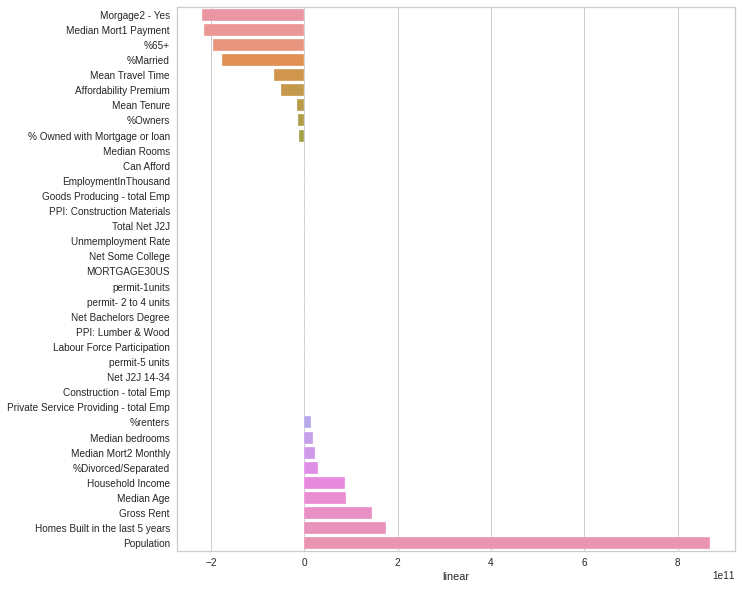

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
4. Feature Importance - Wisconsin


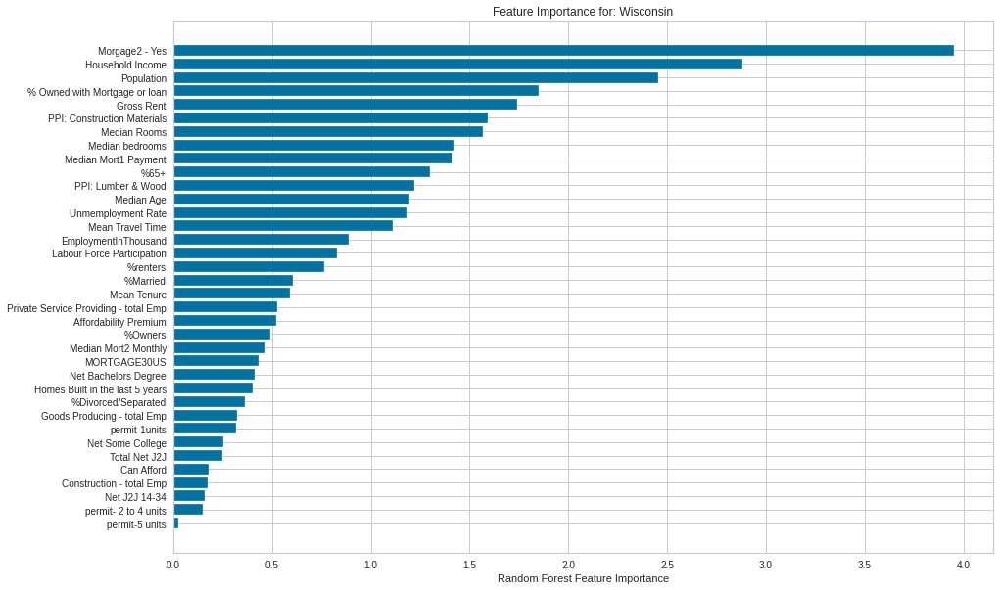

************************************************************************************************************************************************************************************
0. Heatmaps - Kentucky


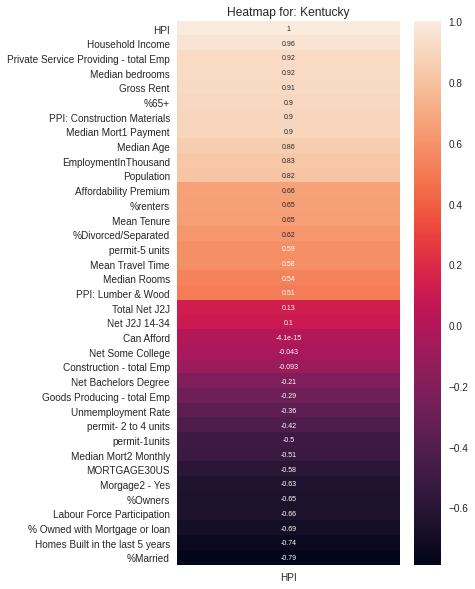

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1 . Errors From model - Kentucky
CBR Accuracy score:  0.9670446946769446
GBR Accuracy score:  0.9804000422439659
RFR Accuracy score:  0.9798627370311837
LR Accuracy Score:  0.9948264460942678
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
2 . Shapley Value for Random Forest - Kentucky


------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
3. Linear Coeff - Kentucky


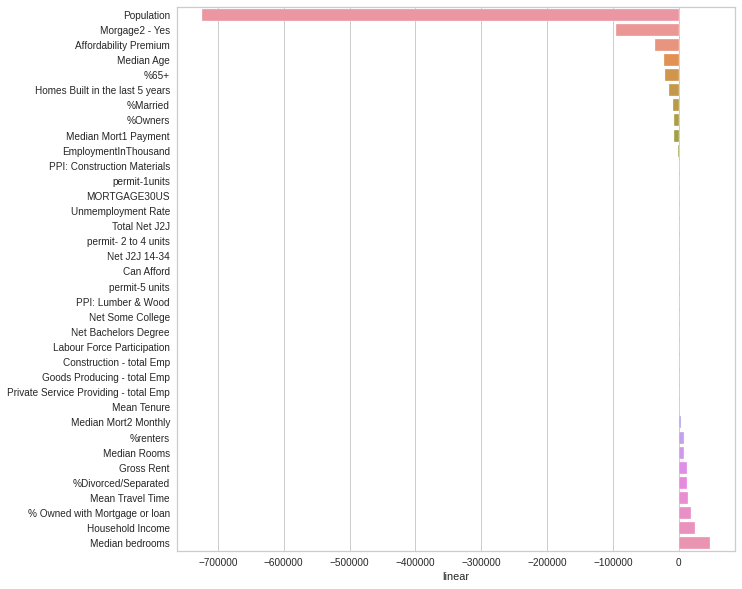

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
4. Feature Importance - Kentucky


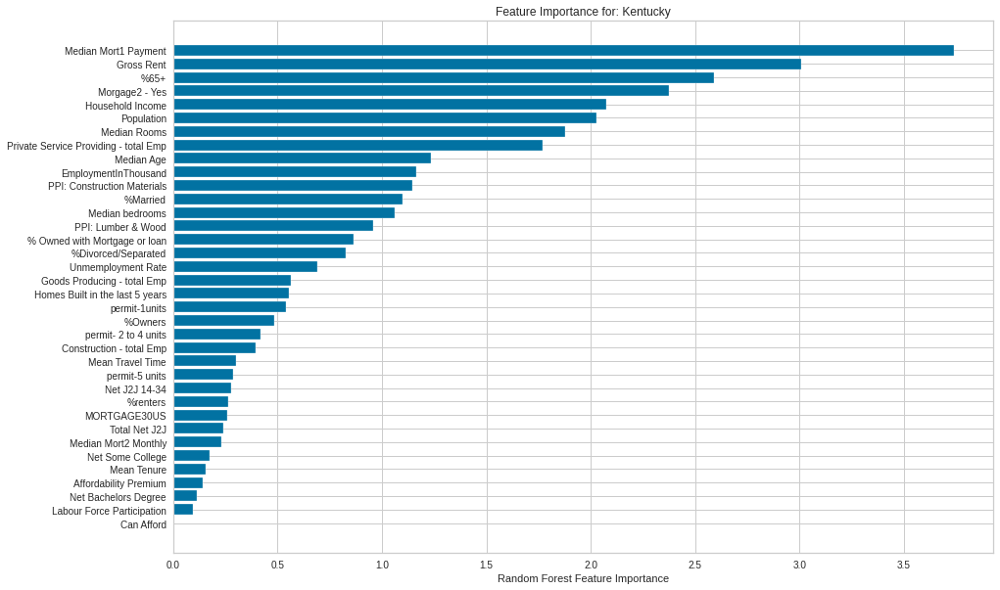

************************************************************************************************************************************************************************************
0. Heatmaps - Illinois


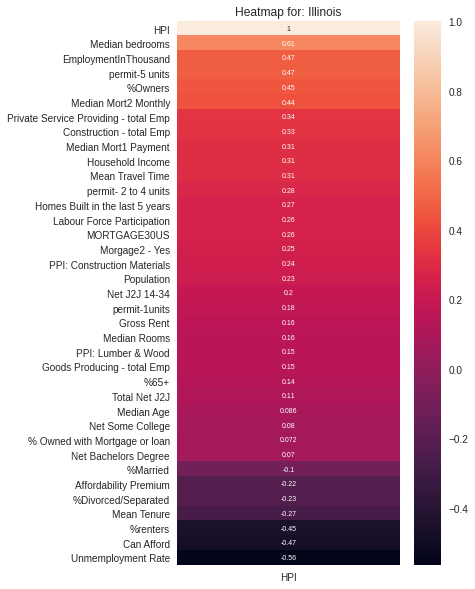

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1 . Errors From model - Illinois
CBR Accuracy score:  0.978877745014824
GBR Accuracy score:  0.9374827905791667
RFR Accuracy score:  0.9082989728707103
LR Accuracy Score:  0.9888362690841266
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
2 . Shapley Value for Random Forest - Illinois


------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
3. Linear Coeff - Illinois


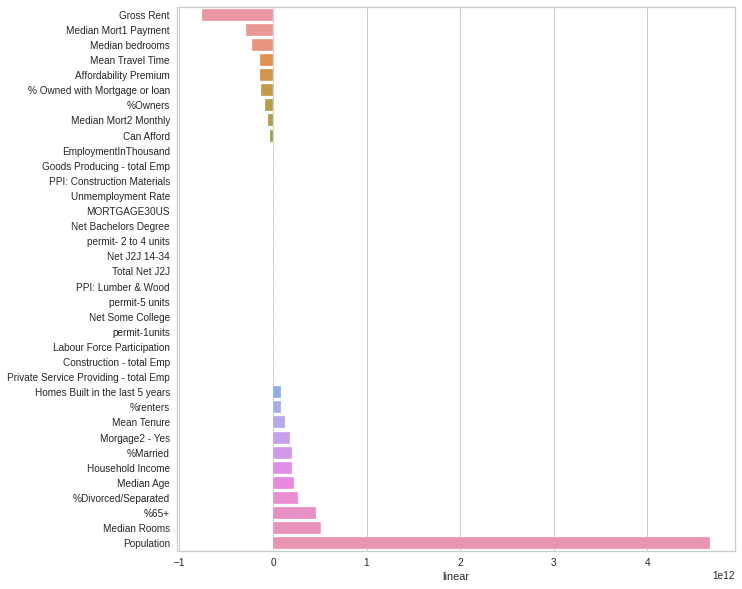

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
4. Feature Importance - Illinois


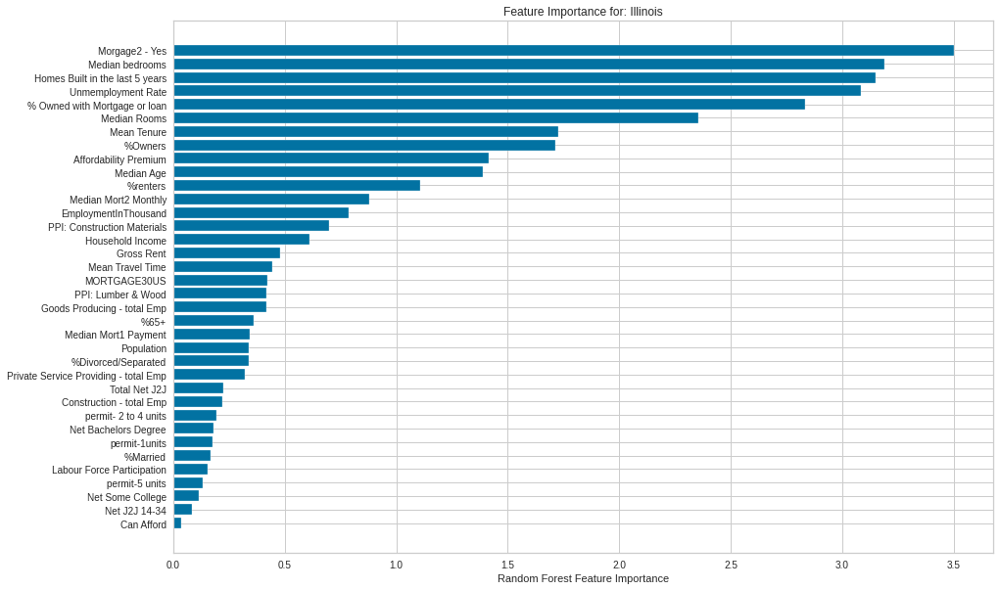

************************************************************************************************************************************************************************************
0. Heatmaps - Michigan


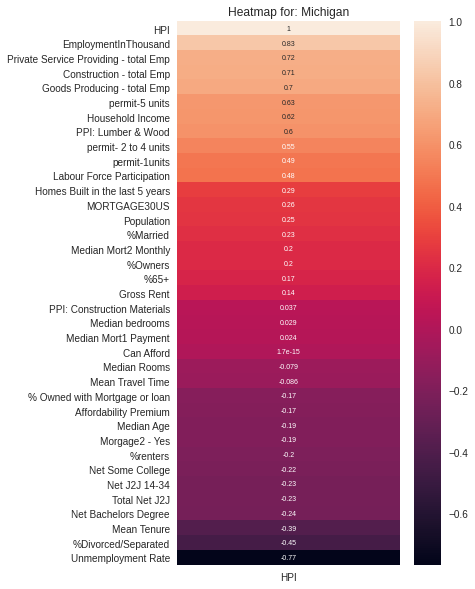

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1 . Errors From model - Michigan
CBR Accuracy score:  0.9437642875569919
GBR Accuracy score:  0.9263471757645021
RFR Accuracy score:  0.9258203284265422
LR Accuracy Score:  0.9814441943604384
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
2 . Shapley Value for Random Forest - Michigan


------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
3. Linear Coeff - Michigan


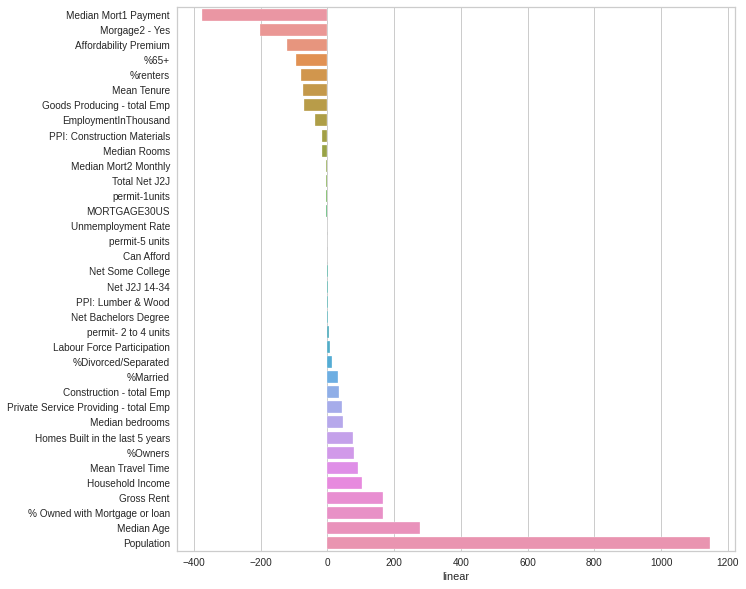

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
4. Feature Importance - Michigan


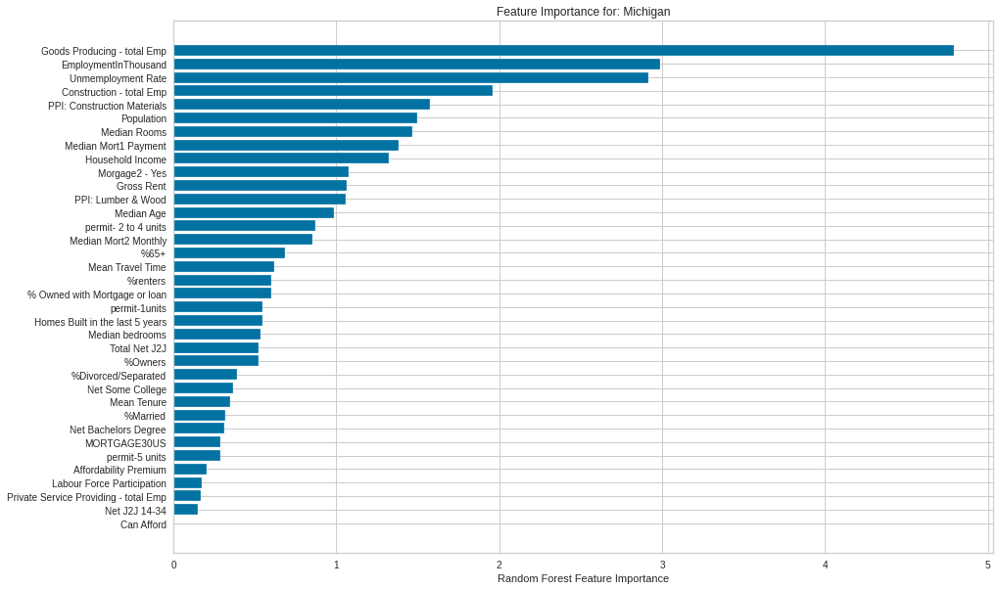

************************************************************************************************************************************************************************************
0. Heatmaps - Missouri


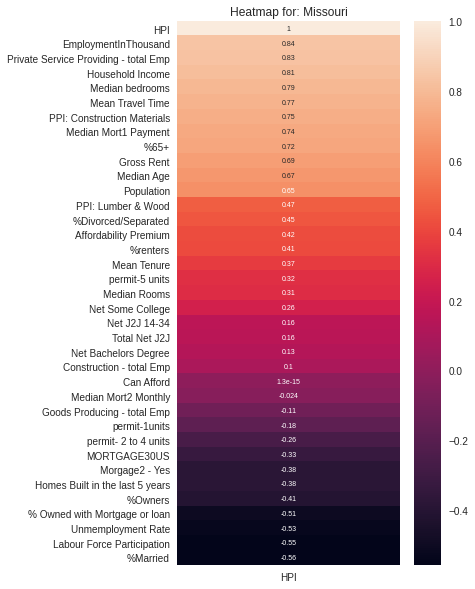

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1 . Errors From model - Missouri
CBR Accuracy score:  0.9619463842979388
GBR Accuracy score:  0.9794054422502952
RFR Accuracy score:  0.963691436580179
LR Accuracy Score:  0.9808872357731196
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
2 . Shapley Value for Random Forest - Missouri


------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
3. Linear Coeff - Missouri


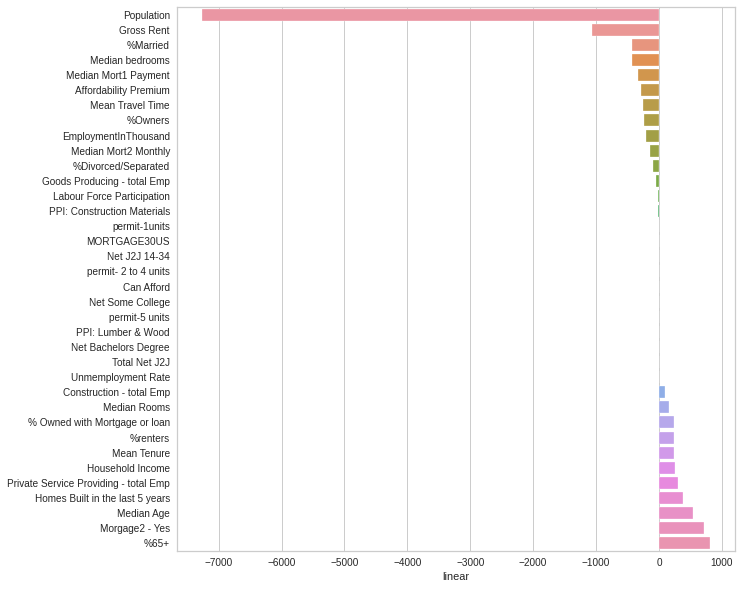

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
4. Feature Importance - Missouri


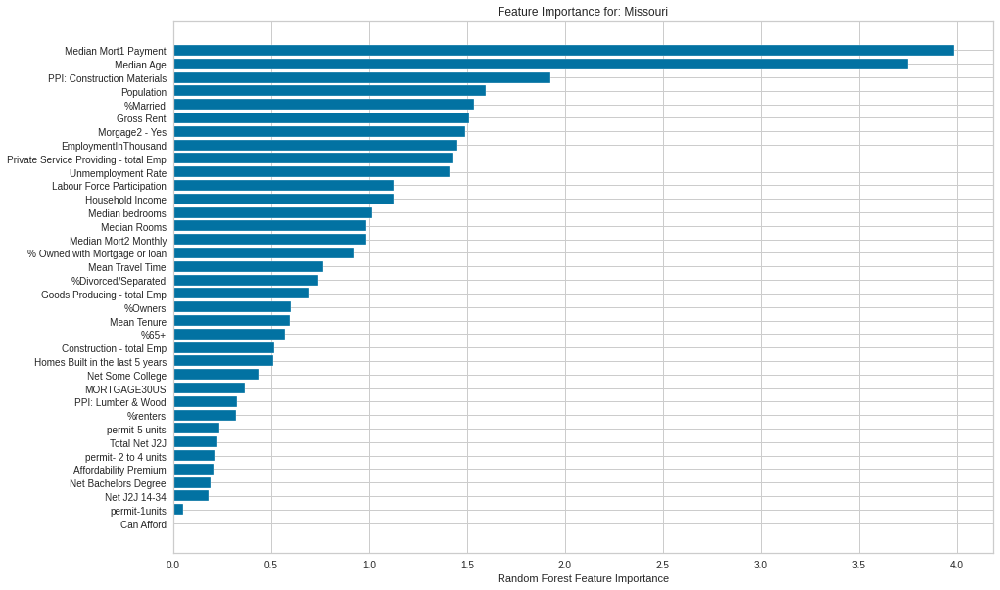

************************************************************************************************************************************************************************************
0. Heatmaps - Texas


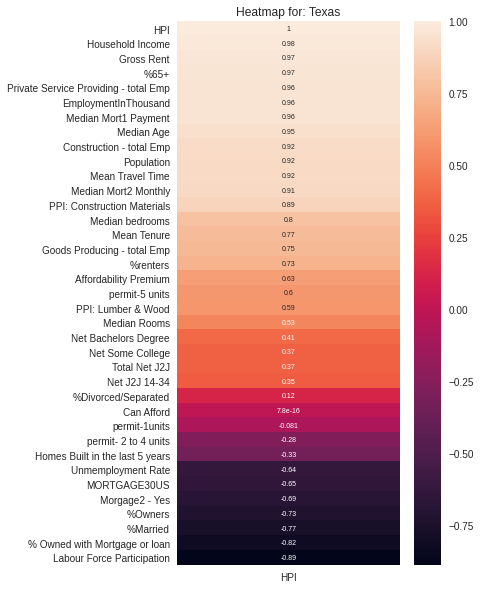

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1 . Errors From model - Texas
CBR Accuracy score:  0.9924258037961468
GBR Accuracy score:  0.9976022042050832
RFR Accuracy score:  0.9958400082705412
LR Accuracy Score:  0.9986899851901553
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
2 . Shapley Value for Random Forest - Texas


------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
3. Linear Coeff - Texas


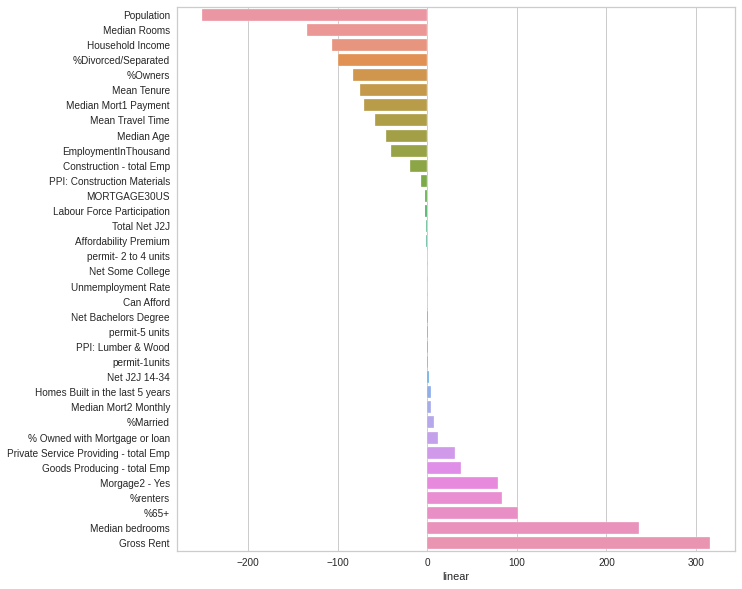

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
4. Feature Importance - Texas


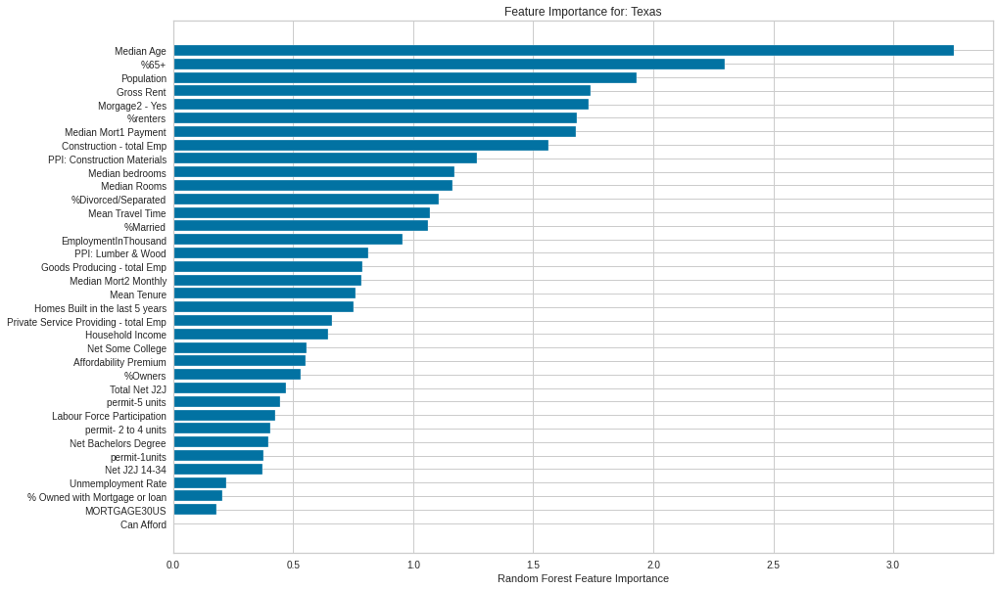

************************************************************************************************************************************************************************************
0. Heatmaps - New Mexico


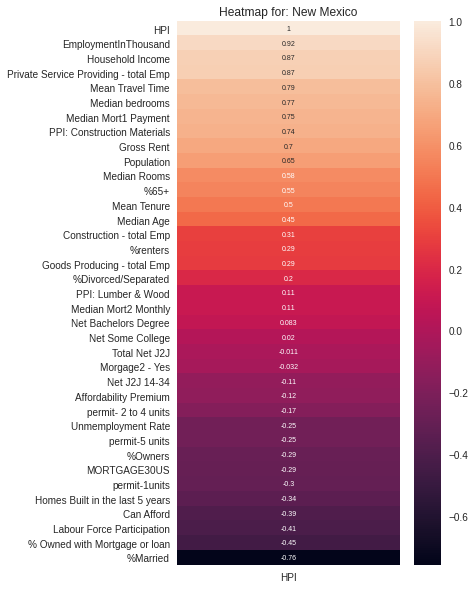

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1 . Errors From model - New Mexico
CBR Accuracy score:  0.9580930367404477
GBR Accuracy score:  0.9830643997327929
RFR Accuracy score:  0.9868460928410601
LR Accuracy Score:  0.9915100897143513
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
2 . Shapley Value for Random Forest - New Mexico


------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
3. Linear Coeff - New Mexico


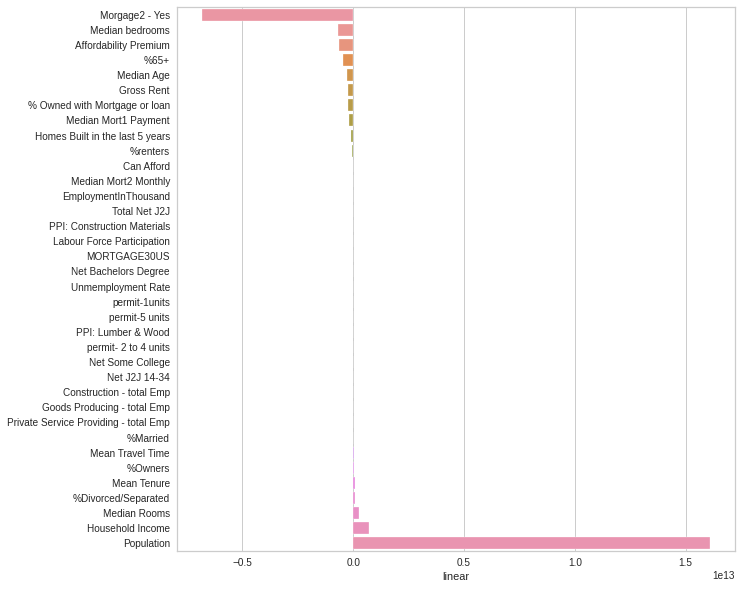

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
4. Feature Importance - New Mexico


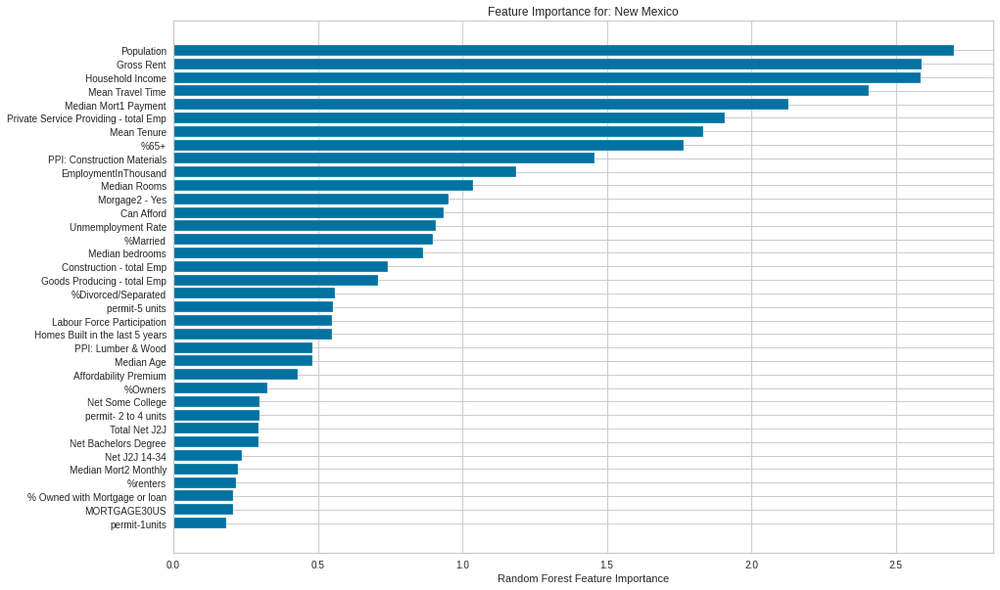

************************************************************************************************************************************************************************************
0. Heatmaps - Nebraska


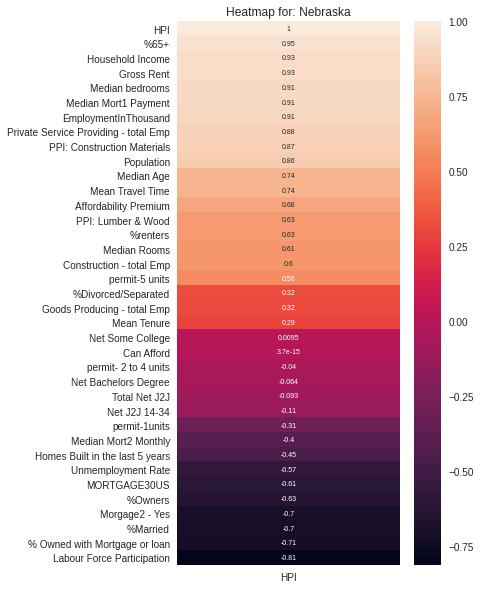

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1 . Errors From model - Nebraska
CBR Accuracy score:  0.9709523640206594
GBR Accuracy score:  0.9915235836297106
RFR Accuracy score:  0.9822920597761747
LR Accuracy Score:  0.9908762612306762
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
2 . Shapley Value for Random Forest - Nebraska


------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
3. Linear Coeff - Nebraska


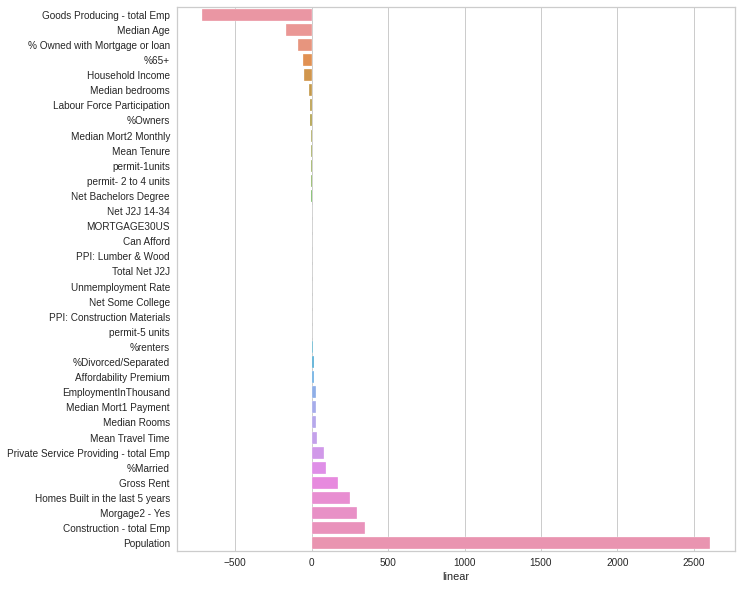

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
4. Feature Importance - Nebraska


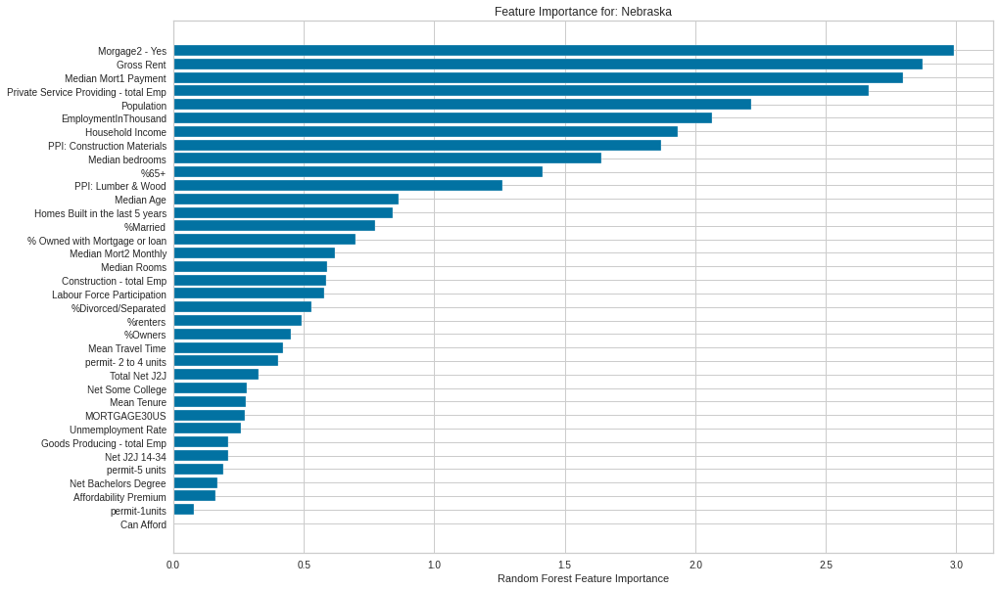

************************************************************************************************************************************************************************************
0. Heatmaps - Alabama


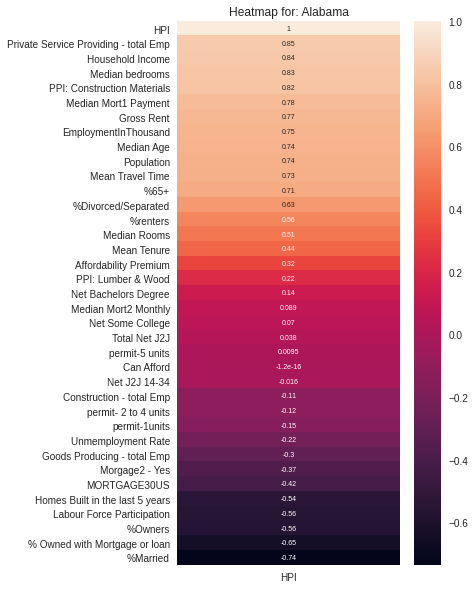

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1 . Errors From model - Alabama
CBR Accuracy score:  0.9682575176640826
GBR Accuracy score:  0.9829218921201411
RFR Accuracy score:  0.9569613846518678
LR Accuracy Score:  0.9921741589850952
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
2 . Shapley Value for Random Forest - Alabama


------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
3. Linear Coeff - Alabama


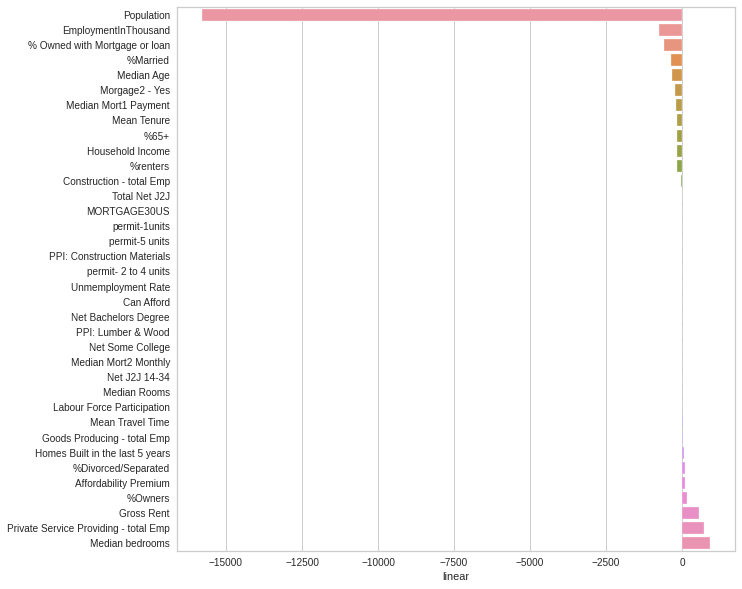

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
4. Feature Importance - Alabama


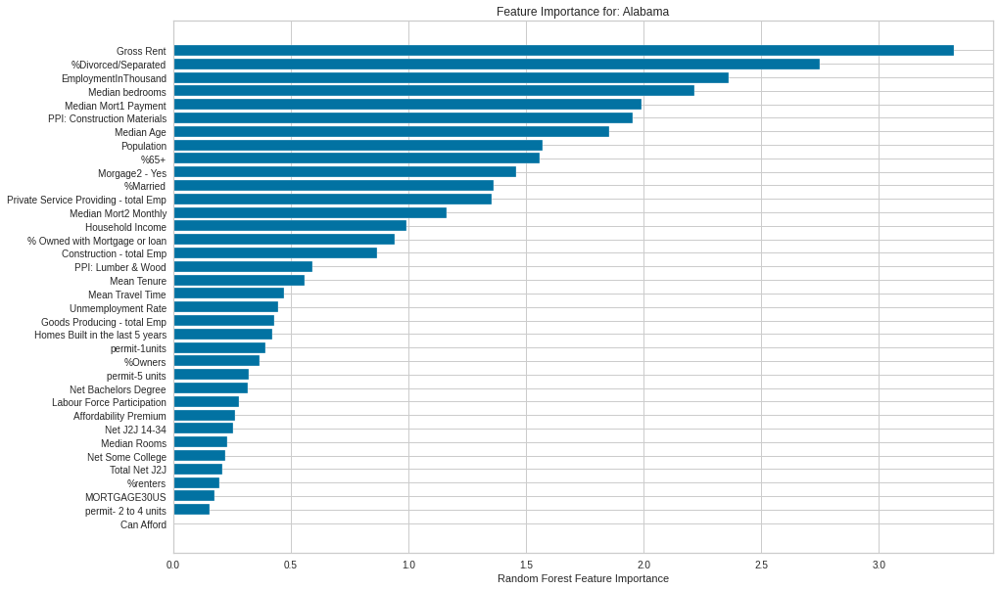

************************************************************************************************************************************************************************************
0. Heatmaps - Alaska


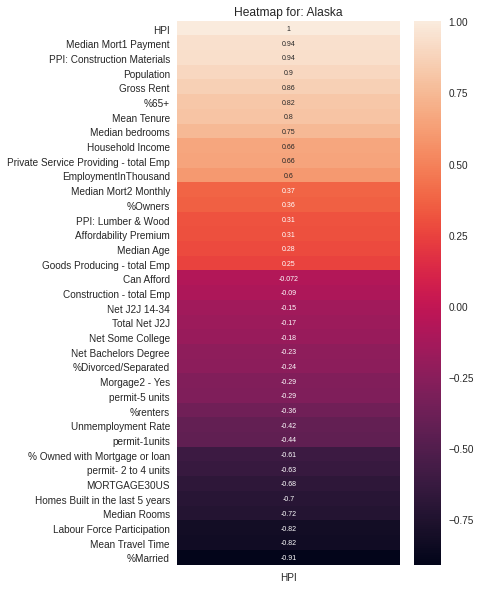

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1 . Errors From model - Alaska
CBR Accuracy score:  0.9325029633911417
GBR Accuracy score:  0.909409109611576
RFR Accuracy score:  0.9781543409603857
LR Accuracy Score:  0.7233134383003481
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
2 . Shapley Value for Random Forest - Alaska


------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
3. Linear Coeff - Alaska


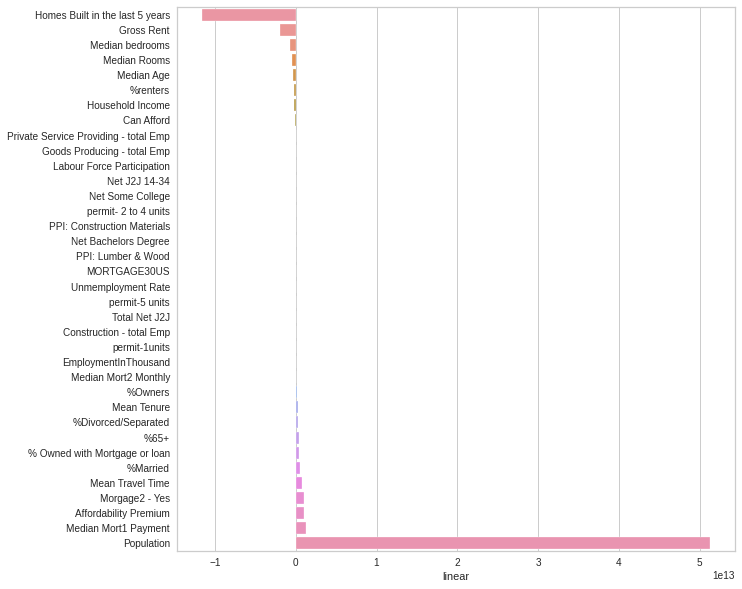

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
4. Feature Importance - Alaska


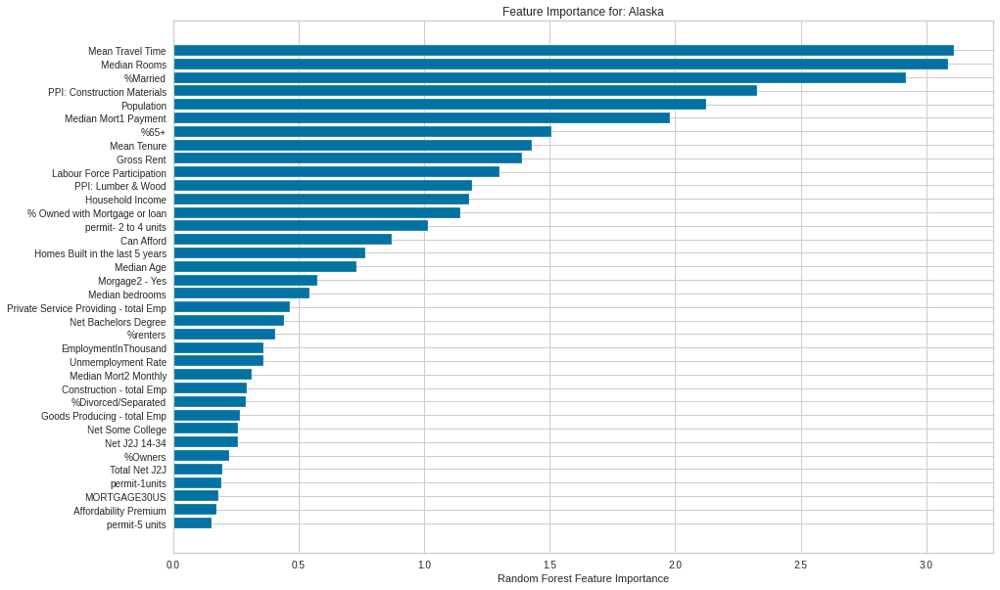

************************************************************************************************************************************************************************************
0. Heatmaps - Wyoming


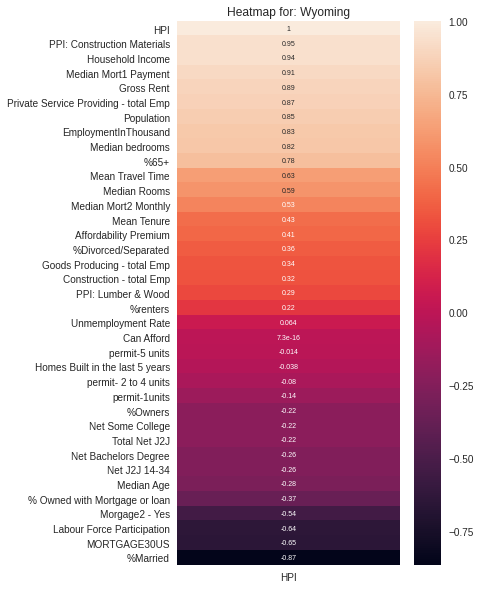

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1 . Errors From model - Wyoming
CBR Accuracy score:  0.9705928107404879
GBR Accuracy score:  0.9955040894935892
RFR Accuracy score:  0.9870950201848419
LR Accuracy Score:  0.9985836064683842
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
2 . Shapley Value for Random Forest - Wyoming


------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
3. Linear Coeff - Wyoming


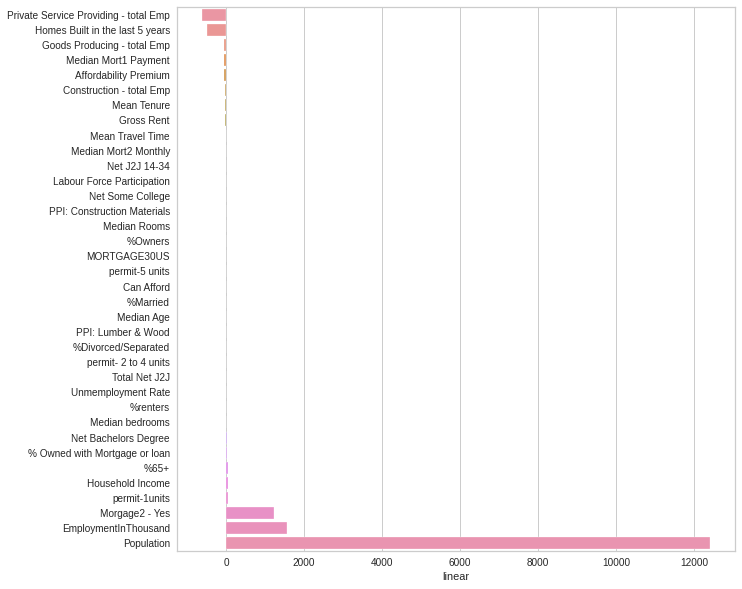

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
4. Feature Importance - Wyoming


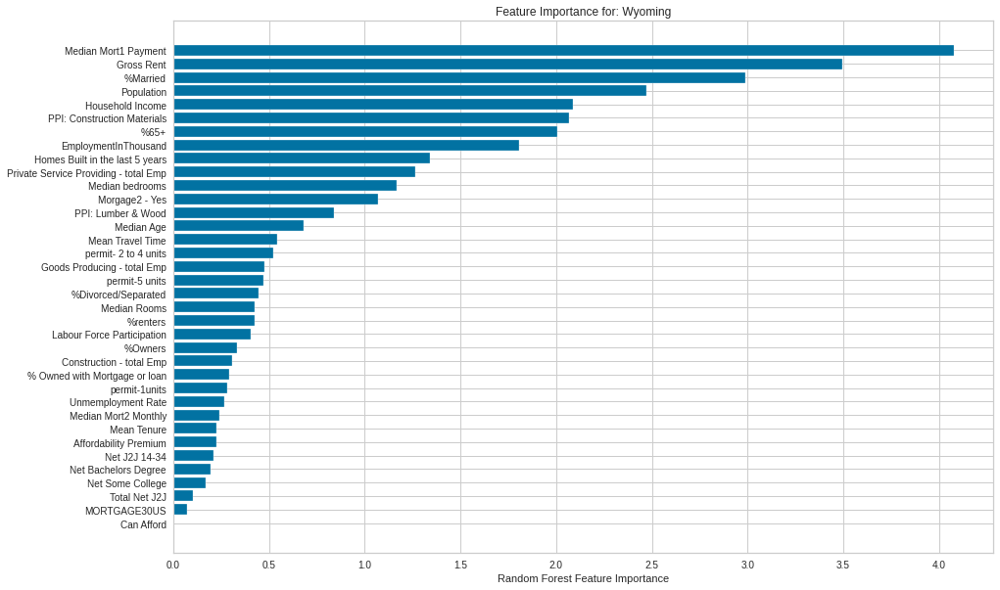

************************************************************************************************************************************************************************************
0. Heatmaps - Indiana


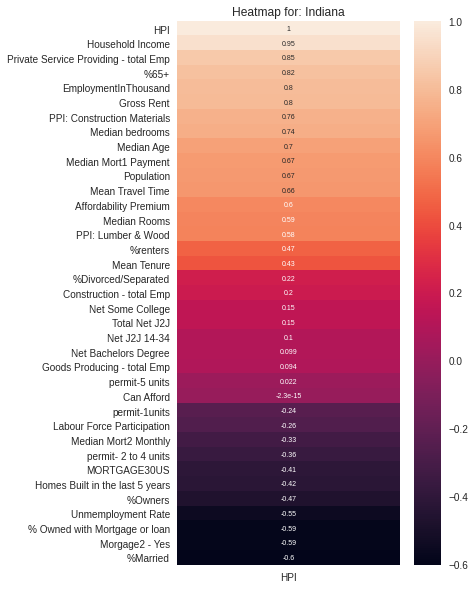

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1 . Errors From model - Indiana
CBR Accuracy score:  0.9628728220582072
GBR Accuracy score:  0.9923360584872639
RFR Accuracy score:  0.9631113224799435
LR Accuracy Score:  0.9804876290799208
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
2 . Shapley Value for Random Forest - Indiana


------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
3. Linear Coeff - Indiana


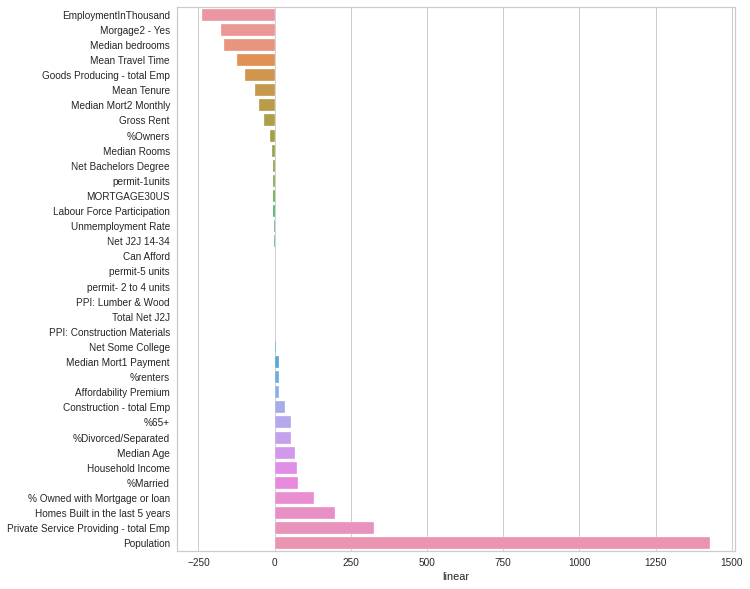

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
4. Feature Importance - Indiana


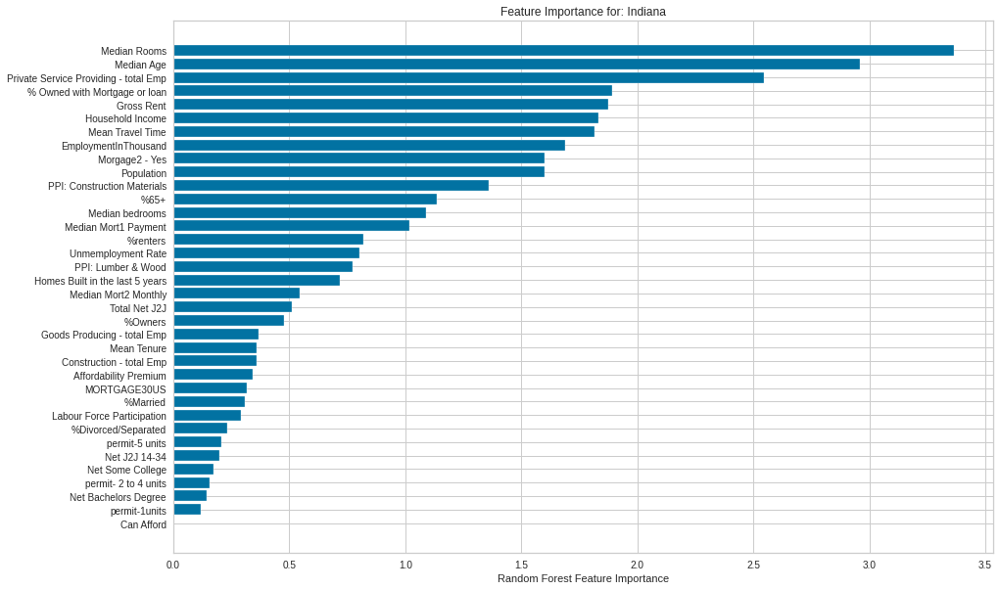

************************************************************************************************************************************************************************************
0. Heatmaps - Ohio


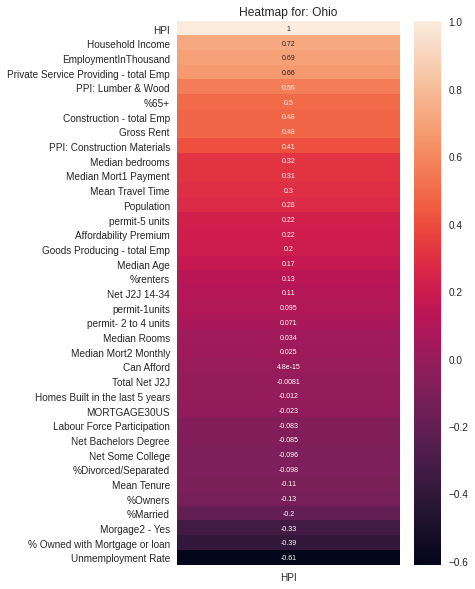

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1 . Errors From model - Ohio
CBR Accuracy score:  0.9476123191332735
GBR Accuracy score:  0.9549256207467524
RFR Accuracy score:  0.9460030699600566
LR Accuracy Score:  0.977447849700637
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
2 . Shapley Value for Random Forest - Ohio


------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
3. Linear Coeff - Ohio


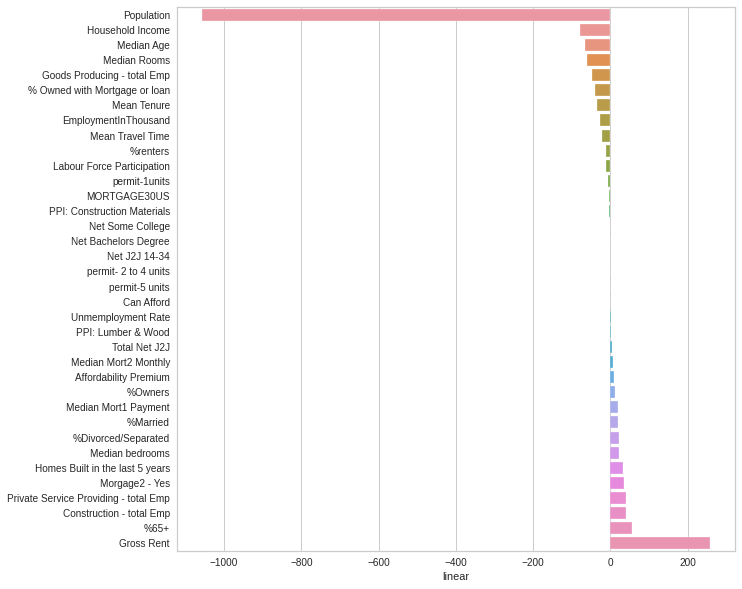

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
4. Feature Importance - Ohio


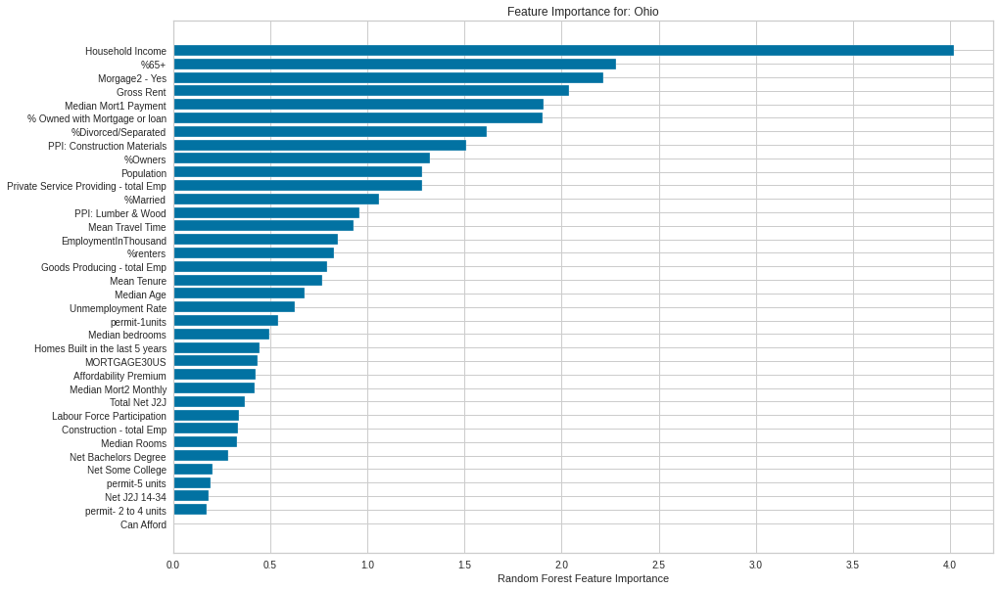

************************************************************************************************************************************************************************************
0. Heatmaps - Iowa


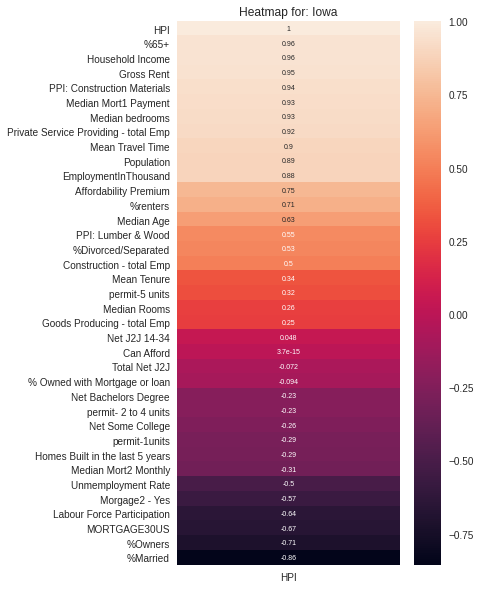

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1 . Errors From model - Iowa
CBR Accuracy score:  0.9704293105156381
GBR Accuracy score:  0.9934107839321827
RFR Accuracy score:  0.9840733141892506
LR Accuracy Score:  0.9968358831206022
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
2 . Shapley Value for Random Forest - Iowa


------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
3. Linear Coeff - Iowa


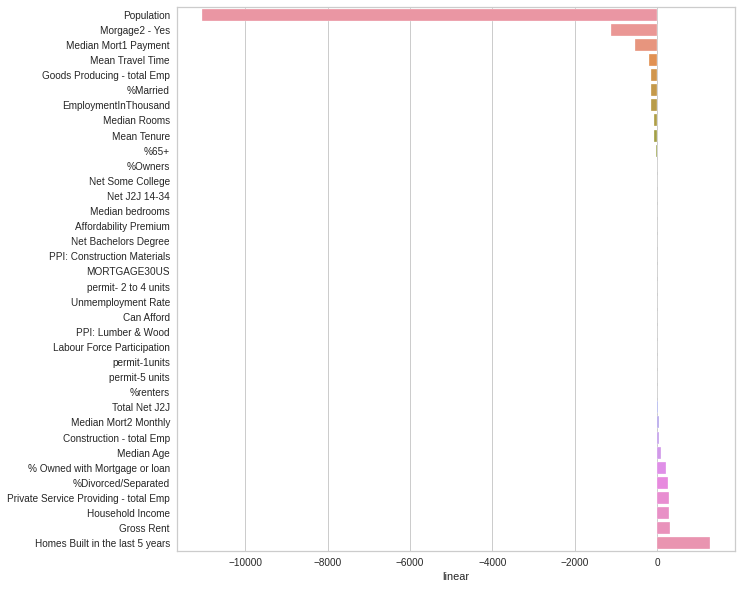

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
4. Feature Importance - Iowa


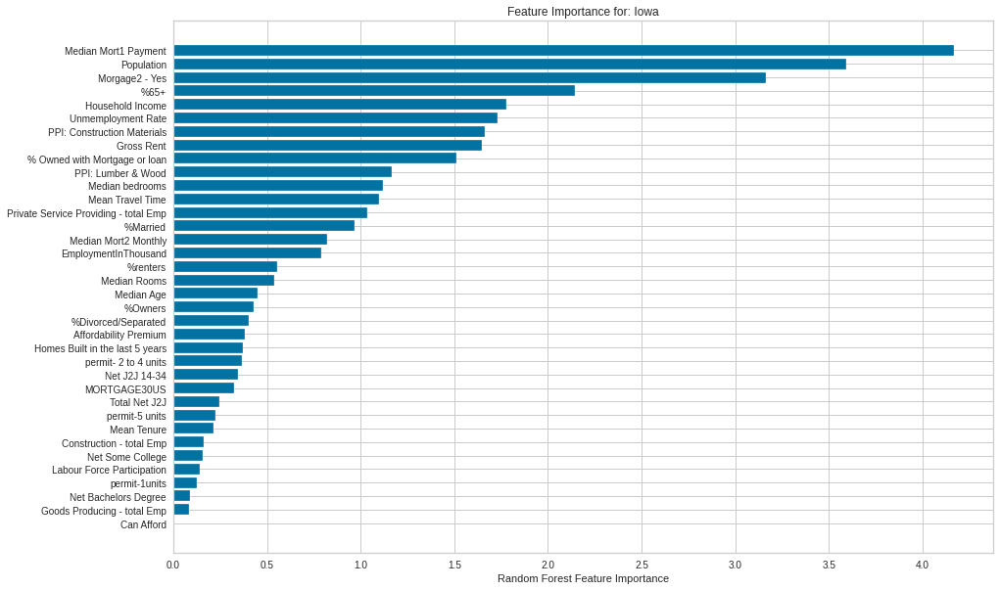

************************************************************************************************************************************************************************************
0. Heatmaps - Kansas


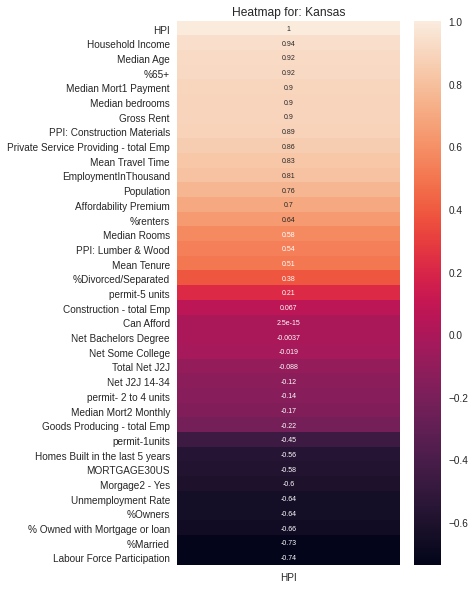

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1 . Errors From model - Kansas
CBR Accuracy score:  0.9266615447924174
GBR Accuracy score:  0.9913084513720246
RFR Accuracy score:  0.9813941467591268
LR Accuracy Score:  0.9868590092379818
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
2 . Shapley Value for Random Forest - Kansas


------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
3. Linear Coeff - Kansas


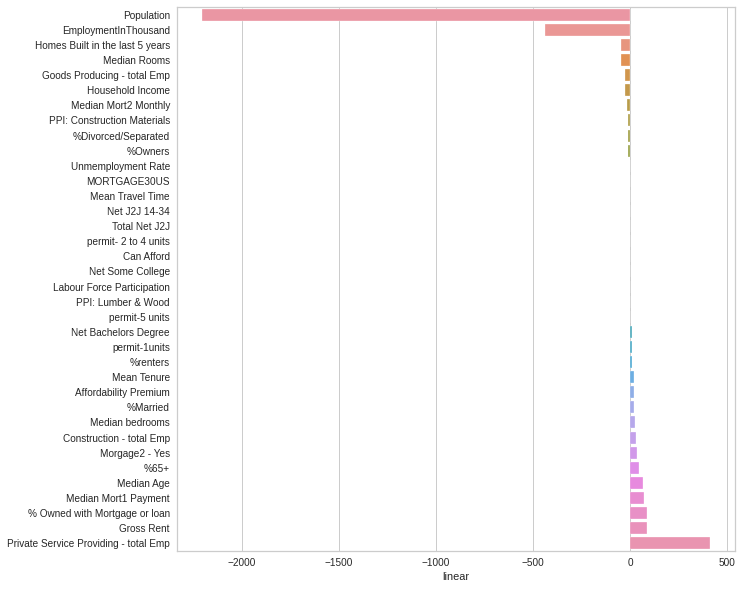

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
4. Feature Importance - Kansas


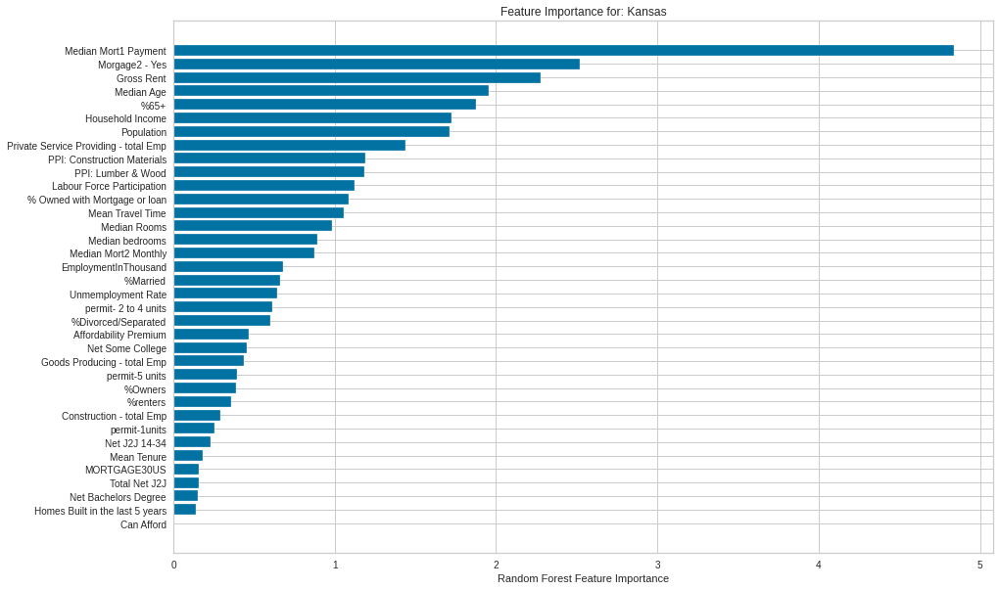

************************************************************************************************************************************************************************************
0. Heatmaps - Arkansas


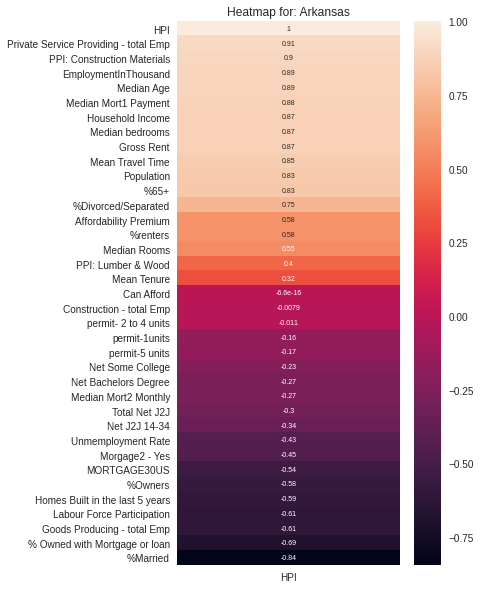

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1 . Errors From model - Arkansas
CBR Accuracy score:  0.9804343352772151
GBR Accuracy score:  0.9944489862176348
RFR Accuracy score:  0.9848554509975402
LR Accuracy Score:  0.9956124635057527
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
2 . Shapley Value for Random Forest - Arkansas


------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
3. Linear Coeff - Arkansas


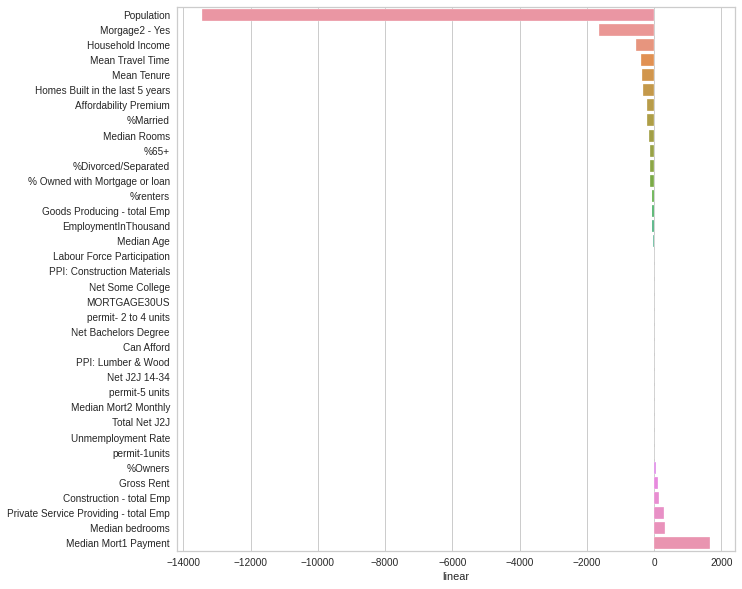

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
4. Feature Importance - Arkansas


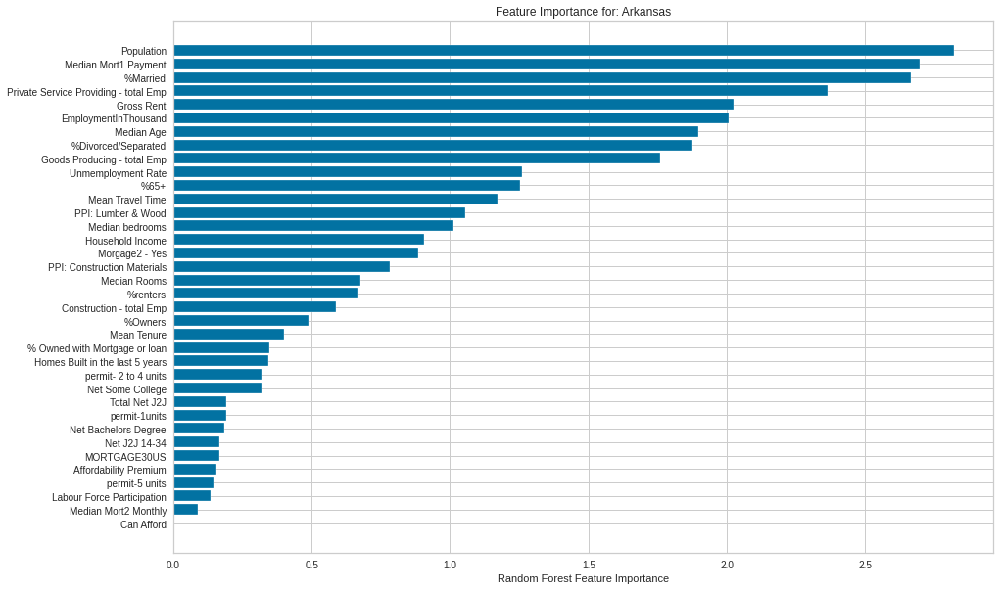

************************************************************************************************************************************************************************************
0. Heatmaps - Louisiana


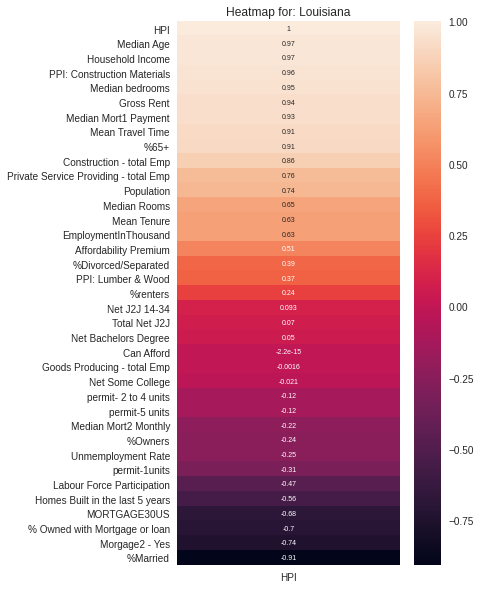

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1 . Errors From model - Louisiana
CBR Accuracy score:  0.9743338405650507
GBR Accuracy score:  0.9934389566311101
RFR Accuracy score:  0.9877168677843403
LR Accuracy Score:  0.9960413031423817
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
2 . Shapley Value for Random Forest - Louisiana


------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
3. Linear Coeff - Louisiana


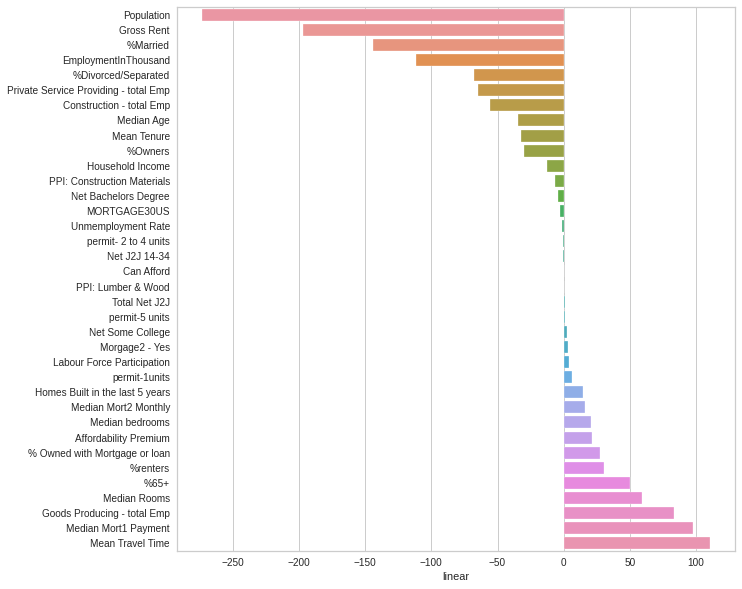

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
4. Feature Importance - Louisiana


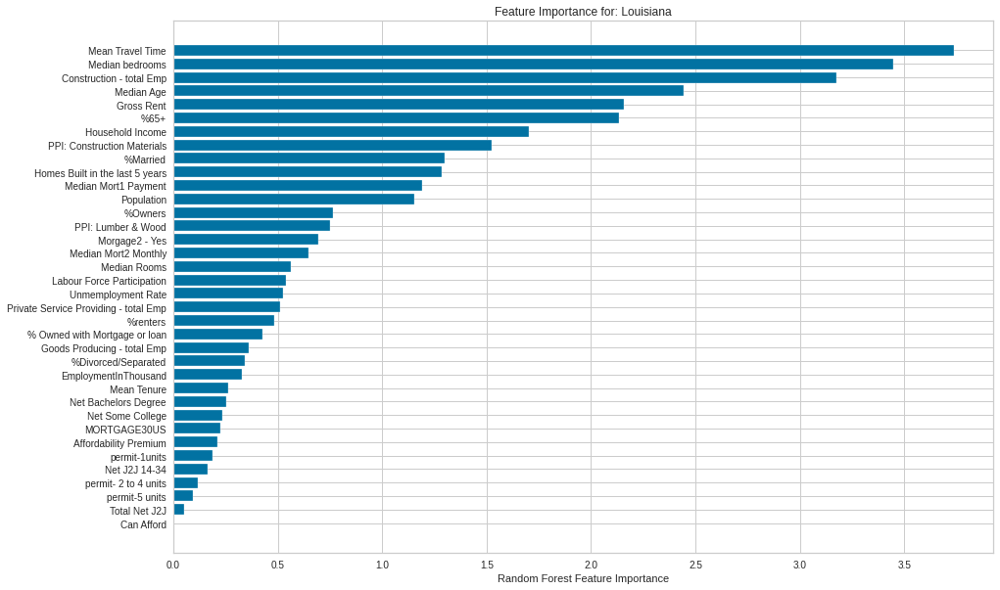

************************************************************************************************************************************************************************************
0. Heatmaps - Mississippi


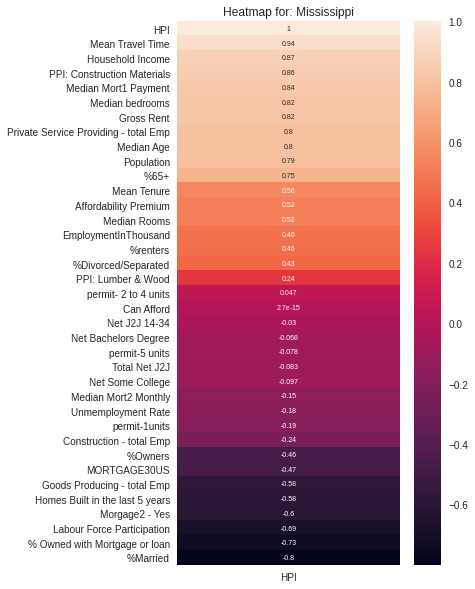

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1 . Errors From model - Mississippi
CBR Accuracy score:  0.9772432685650707
GBR Accuracy score:  0.981795988011987
RFR Accuracy score:  0.9657421869765428
LR Accuracy Score:  0.993031580889832
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
2 . Shapley Value for Random Forest - Mississippi


------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
3. Linear Coeff - Mississippi


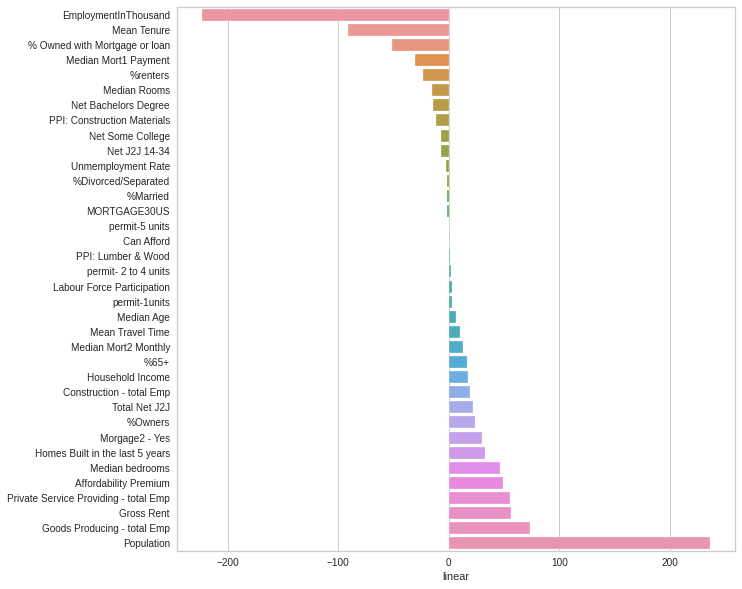

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
4. Feature Importance - Mississippi


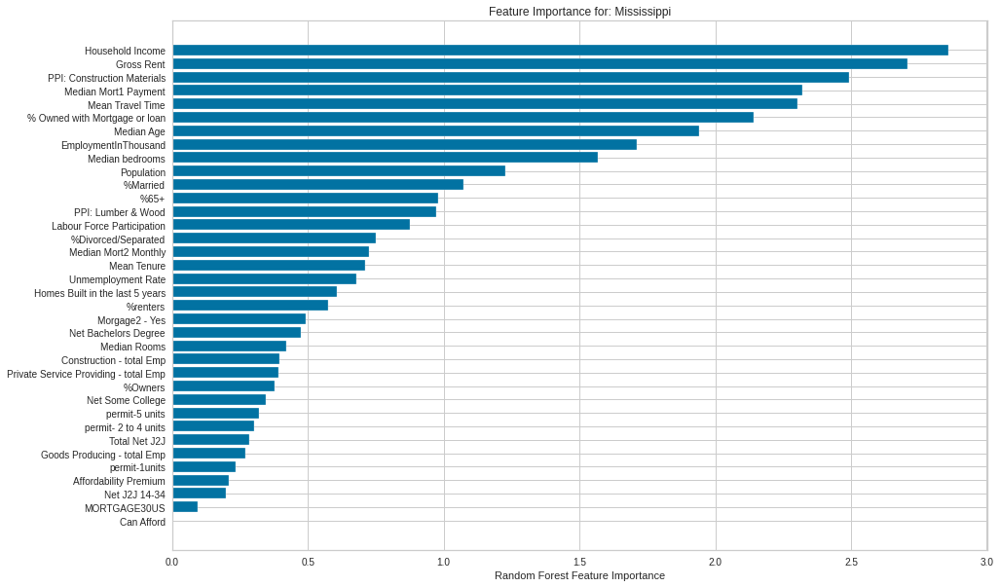

************************************************************************************************************************************************************************************
0. Heatmaps - Oklahoma


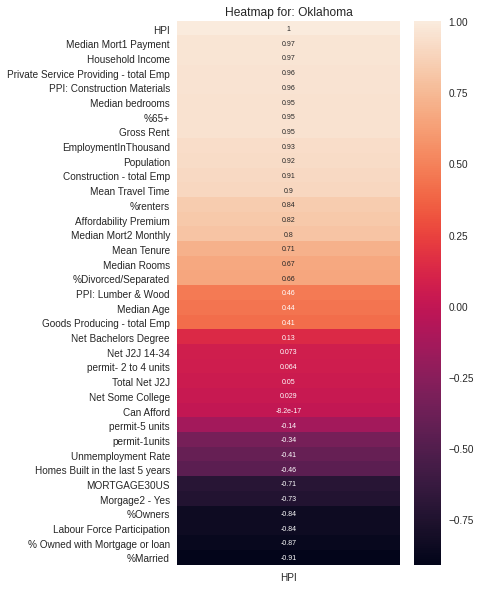

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1 . Errors From model - Oklahoma
CBR Accuracy score:  0.9757430370975428
GBR Accuracy score:  0.9912512634889858
RFR Accuracy score:  0.9809116464606568
LR Accuracy Score:  0.9966793991812475
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
2 . Shapley Value for Random Forest - Oklahoma


------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
3. Linear Coeff - Oklahoma


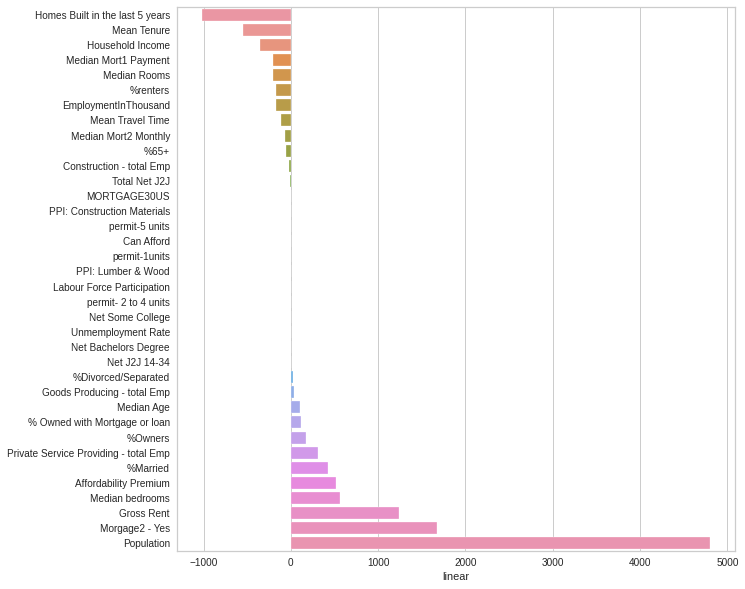

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
4. Feature Importance - Oklahoma


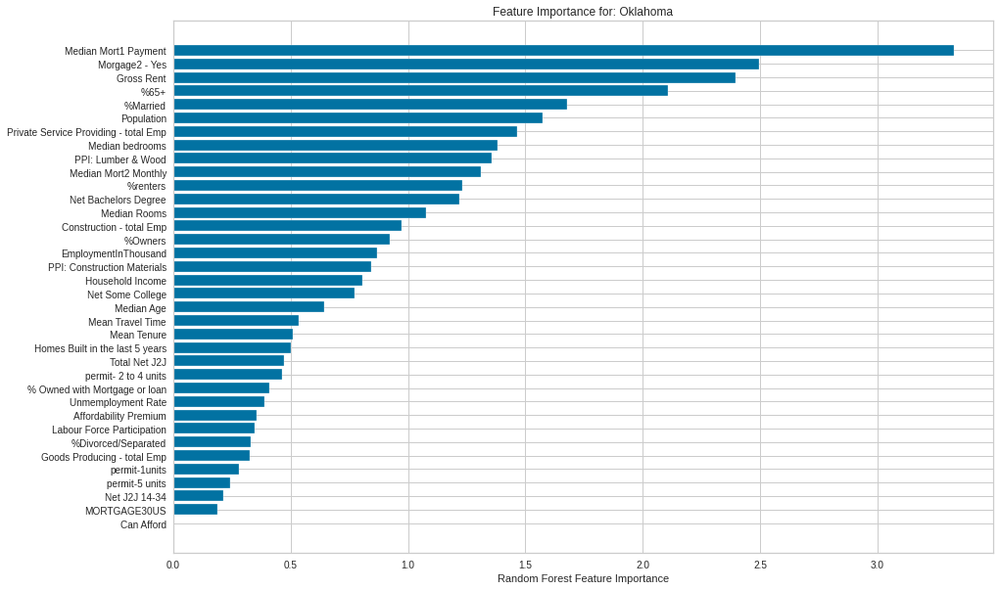

************************************************************************************************************************************************************************************
0. Heatmaps - West Virginia


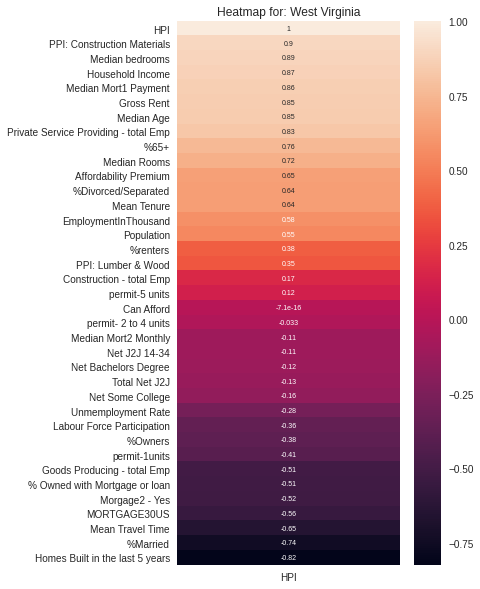

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1 . Errors From model - West Virginia
CBR Accuracy score:  0.9689603211401276
GBR Accuracy score:  0.9869168839123451
RFR Accuracy score:  0.9817304556092968
LR Accuracy Score:  0.9925036920328956
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
2 . Shapley Value for Random Forest - West Virginia


------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
3. Linear Coeff - West Virginia


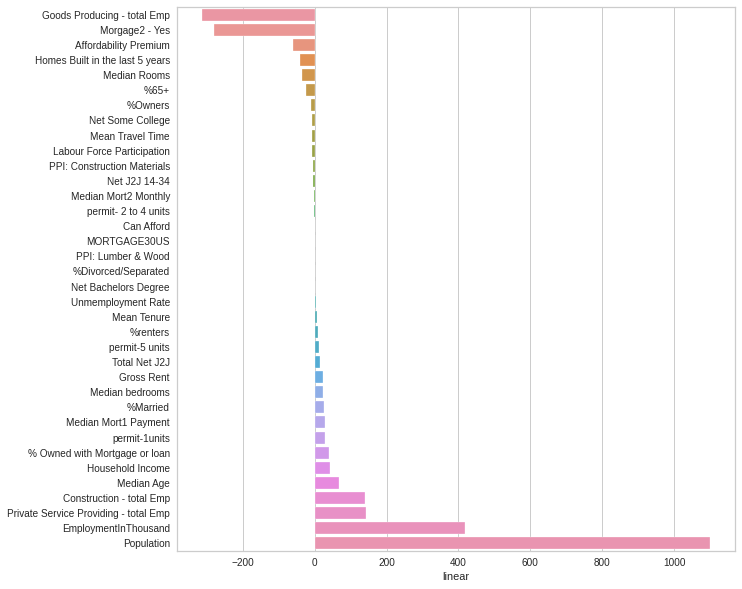

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
4. Feature Importance - West Virginia


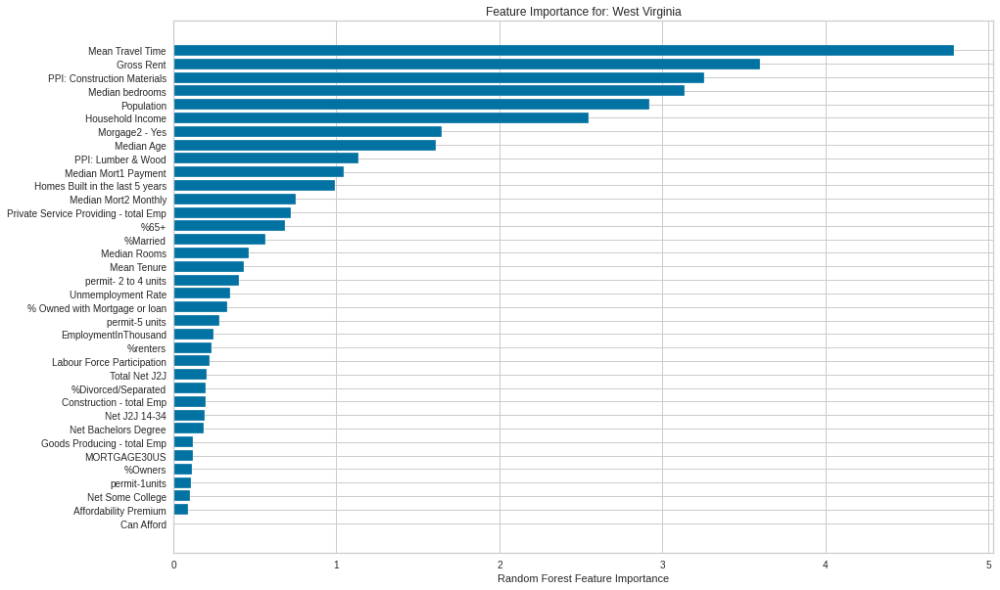

In [118]:
shap.initjs()
for st in state_name:
  Avg_feature_importance(df3, st)

References:
https://github.com/melanieshi0120/COVID-19_global_time_series_panel_data/blob/master/Time_series_panel_data_model_part_fatality.ipynb